In [0]:
!python -V

Python 3.7.4


In [1]:
# !pip install feature-engine
# !pip install optuna
# # !pip install featexp
# !pip install catboost

In [0]:
from featexp import get_univariate_plots
from featexp import univariate_plotter
from featexp import get_trend_stats

# Load packages

In [7]:
# from __future__ import division, print_function
import gc
import os
import pathlib
import re
import pandas as pd
import numpy as np
from numpy.linalg import svd
from numba import jit
import itertools
from copy import deepcopy
from contextlib import contextmanager
from sklearn_pandas import DataFrameMapper
from sklearn.pipeline import Pipeline as pipe
from feature_engine import categorical_encoders as ce
from feature_engine import discretisers as dsc
import concurrent.futures

from sklearn.feature_selection import RFE
from sklearn.metrics import roc_auc_score, roc_curve, confusion_matrix
from sklearn import metrics
from sklearn.model_selection import (cross_val_score, train_test_split, ShuffleSplit, StratifiedKFold, KFold,
                                    learning_curve, TimeSeriesSplit, RepeatedKFold)

from sklearn.ensemble import (RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
                             VotingClassifier, ExtraTreesClassifier)

from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC

from scipy import stats 
from scipy.special import boxcox1p

from scipy.stats import rankdata
from sklearn.preprocessing import (MinMaxScaler, Binarizer, StandardScaler, OneHotEncoder,
                                  Normalizer, RobustScaler, OrdinalEncoder, LabelEncoder)
import lightgbm as lgb
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier, plot_importance, plot_metric
import xgboost as xgb
from sklearn.base import BaseEstimator, ClassifierMixin, TransformerMixin, RegressorMixin, clone

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
%pylab inline

pd.set_option('display.max_columns', 130)

import warnings
warnings.filterwarnings("ignore")

Populating the interactive namespace from numpy and matplotlib


In [0]:
colab_path = '/content/drive/My Drive/'
pickle.dump(mapper_fit, open('fitted_mapper.pkl', 'wb'))
# mapper_fit = pickle.load(open('fitted_mapper.pkl', 'rb'))

In [0]:
colab_path = '/content/drive/My Drive/'
# with open( os.path.join(colab_path,'list_dict.json'), 'w') as fp:
#     json.dump(list_dicts, fp)

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


# Functions

In [0]:
def reduce_mem_usage(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)
            else:
                c_prec = df[col].apply(lambda x: np.finfo(x).precision).max()
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max and c_prec == np.finfo(np.float16).precision:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max and c_prec == np.finfo(np.float32).precision:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
    end_mem = df.memory_usage().sum() / 1024**2
    if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return df

@jit
def fast_auc(y_true, y_prob):
    """
    fast roc_auc computation: https://www.kaggle.com/c/microsoft-malware-prediction/discussion/76013
    """
    y_true = np.asarray(y_true)
    y_true = y_true[np.argsort(y_prob)]
    nfalse = 0
    auc = 0
    n = len(y_true)
    for i in range(n):
        y_i = y_true[i]
        nfalse += (1 - y_i)
        auc += y_i * nfalse
    auc /= (nfalse * (n - nfalse))
    return auc

def eval_auc(y_true, y_pred):
    """
    Fast auc eval function for lgb.
    """
    return 'auc', fast_auc(y_true, y_pred), True


def train_model_classification(X, X_test, y, params, folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=50000):
    """
    A function to train a variety of regression models.
    Returns dictionary with oof predictions, test predictions, scores and, if necessary, feature importances.
    
    :params: X - training data, can be pd.DataFrame or np.ndarray (after normalizing)
    :params: X_test - test data, can be pd.DataFrame or np.ndarray (after normalizing)
    :params: y - target
    :params: folds - folds to split data
    :params: model_type - type of model to use
    :params: eval_metric - metric to use
    :params: columns - columns to use. If None - use all columns
    :params: plot_feature_importance - whether to plot feature importance of LGB
    :params: model - sklearn model, works only for "sklearn" model type
    
    """
    columns = X.columns if columns == None else columns
    X_test = X_test[columns]
    
    # to set up scoring parameters
    metrics_dict = {'auc': {'lgb_metric_name': eval_auc,
                        'catboost_metric_name': 'AUC',
                        'sklearn_scoring_function': metrics.roc_auc_score},
                    }
    
    result_dict = {}
    
    # out-of-fold predictions on train data
    oof = np.zeros((len(X), len(set(y.values))))
    
    # averaged predictions on train data
    prediction = np.zeros((len(X_test), oof.shape[1]))
    
    # list of scores on folds
    scores = []
    feature_importance = pd.DataFrame()
    
    # split and train on folds
    for fold_n, (train_index, valid_index) in enumerate(folds.split(X)):
        print(f'Fold {fold_n + 1} started at {time.ctime()}')
        if type(X) == np.ndarray:
            X_train, X_valid = X[columns][train_index], X[columns][valid_index]
            y_train, y_valid = y[train_index], y[valid_index]
        else:
            X_train, X_valid = X[columns].iloc[train_index], X[columns].iloc[valid_index]
            y_train, y_valid = y.iloc[train_index], y.iloc[valid_index]
            
        if model_type == 'lgb':
            model = lgb.LGBMClassifier(**params, n_jobs = -1) # n_estimators=n_estimators, 
            model.fit(X_train, y_train, 
                    eval_set=[(X_train, y_train), (X_valid, y_valid)], eval_metric=metrics_dict[eval_metric]['lgb_metric_name'],
                    verbose=verbose, early_stopping_rounds=early_stopping_rounds)
            
            y_pred_valid = model.predict_proba(X_valid)
            y_pred = model.predict_proba(X_test, num_iteration=model.best_iteration_)
            
        if model_type == 'xgb':
            train_data = xgb.DMatrix(data=X_train, label=y_train, feature_names=X.columns)
            valid_data = xgb.DMatrix(data=X_valid, label=y_valid, feature_names=X.columns)

            watchlist = [(train_data, 'train'), (valid_data, 'valid_data')]
            model = xgb.train(dtrain=train_data, num_boost_round=n_estimators, evals=watchlist,
                              early_stopping_rounds=early_stopping_rounds, verbose_eval=verbose, params=params)
            
            y_pred_valid = model.predict(xgb.DMatrix(X_valid, feature_names=X.columns), ntree_limit=model.best_ntree_limit)[:, 1]
            y_pred = model.predict(xgb.DMatrix(X_test, feature_names=X.columns), ntree_limit=model.best_ntree_limit) [:, 1]
        
        if model_type == 'sklearn':
            model = model
            model.fit(X_train, y_train)
            
            y_pred_valid = model.predict_proba(X_valid).reshape(-1,)
            score = metrics_dict[eval_metric]['sklearn_scoring_function'](y_valid, y_pred_valid)
            print(f'Fold {fold_n}. {eval_metric}: {score:.4f}.')
            print('')
            
            y_pred = model.predict_proba(X_test)
        
        if model_type == 'cat':
            model = CatBoostClassifier(eval_metric=metrics_dict[eval_metric]['catboost_metric_name'], **params) #iterations=n_estimators
                                      #loss_function='CrossEntropy') #  metrics_dict[eval_metric]['catboost_metric_name'])
            model.fit(X_train, y_train, eval_set=(X_valid, y_valid), plot=True, use_best_model=True, verbose=False) # cat_features=cats_indices

            y_pred_valid = model.predict_proba(X_valid)
            y_pred = model.predict_proba(X_test)
        
        oof[valid_index] = y_pred_valid
        scores.append(metrics_dict[eval_metric]['sklearn_scoring_function'](y_valid, y_pred_valid[:, 1]))

        prediction += y_pred    
        
        if model_type == 'lgb' and plot_feature_importance:
            # feature importance
            fold_importance = pd.DataFrame()
            fold_importance["feature"] = columns
            fold_importance["importance"] = model.feature_importances_
            fold_importance["fold"] = fold_n + 1
            feature_importance = pd.concat([feature_importance, fold_importance], axis=0)

    prediction /= folds.n_splits
    
    print('CV mean score: {0:.4f}, std: {1:.4f}.'.format(np.mean(scores), np.std(scores)))
    
    result_dict['oof'] = oof
    result_dict['prediction'] = prediction
    result_dict['scores'] = scores
    
    if model_type == 'lgb':
        if plot_feature_importance:
            feature_importance["importance"] /= folds.n_splits
            cols = feature_importance[["feature", "importance"]].groupby("feature").mean().sort_values(
                by="importance", ascending=False)[:50].index

            best_features = feature_importance.loc[feature_importance.feature.isin(cols)]

            plt.figure(figsize=(16, 12));
            sns.barplot(x="importance", y="feature", data=best_features.sort_values(by="importance", ascending=False));
            plt.title('LGB Features (avg over folds)');
            
            result_dict['feature_importance'] = feature_importance
        
    return result_dict

def make_harmonic_features(df, column):
    for col in column:
        period = df[col].nunique()
        value = df[col].copy()
        value *= 2 * np.pi / period
        df[col + '_cos'] = np.cos(value, dtype='float32')
        df[col + '_sin'] = np.sin(value, dtype='float32')
    return (df)

def make_conj(data, feat1, feat2):
    """
    inplace
    """
    new_name = feat1 + '_' + feat2
    data[new_name] = data[feat1].astype(str)+ '_' + data[feat2].astype(str)
    data[new_name] = LabelEncoder().fit_transform(data[new_name])
    

# по значениям другого категориального признака
def code_factor(data, cat_feature, cat_feature2):
    ct = pd.crosstab(data[cat_feature], data[cat_feature2])
    u, _, _ = svd(ct.values)
    coder = dict(zip(ct.index, u[:, 0])) # если кодирование первой компонентой
    return (data[cat_feature].map(coder))

def make_real_feature(df, name, group_col='userid'):
    """
    вычисление разных статистик
    """
    tmp = df.groupby(group_col)[name].agg({np.mean, max, min, np.median, sum, np.std}).fillna(-1)
    tmp.columns = [name + '_' + str(x) for x in tmp.columns]
    tmp = tmp.reset_index()
    return (tmp[tmp.columns[tmp.nunique()>1]])


def plot_learning_curve_roc(estimator, X, y, ylim=None, cv=None,
                        n_jobs=-1, train_sizes=np.linspace(.1, 1.0, 5)):
    
    plt.figure()
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Количество объектов в выборке")
    plt.ylabel("ROC-AUC")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=strat_kfold_5, n_jobs=n_jobs, train_sizes=train_sizes, scoring="roc_auc")
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1, color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",label="Train")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g", label="CV")

    plt.legend(loc="best")
    return plt

def plot_validation_curves(param_values, grid_cv_results_):
    train_mu, train_std = grid_cv_results_['mean_train_score'], grid_cv_results_['std_train_score']
    valid_mu, valid_std = grid_cv_results_['mean_test_score'], grid_cv_results_['std_test_score']
    train_line = plt.plot(param_values, train_mu, '-', label='train', color='green')
    valid_line = plt.plot(param_values, valid_mu, '-', label='test', color='red')
    plt.fill_between(param_values, train_mu - train_std, train_mu + train_std, edgecolor='none',
                     facecolor=train_line[0].get_color(), alpha=0.2)
    plt.fill_between(param_values, valid_mu - valid_std, valid_mu + valid_std, edgecolor='none',
                     facecolor=valid_line[0].get_color(), alpha=0.2)
    plt.legend()

def plot_roc(y_true, y_proba):
    fpr, tpr, _ = metrics.roc_curve(y_true, y_proba)
    auc = metrics.roc_auc_score(y_true, res_dict['prediction'][:, 1])
    plt.plot([0, 1], [0, 1], 'k--')
    plt.plot(fpr,tpr,label=f"data 1, auc={auc:.4f}")
    plt.legend(loc=4)
    plt.show()


# Load dataset
def load_ottrip(train=True):

  cols_to_rename = {'field0': 'ndays_from_last',
                 'field2': 'month_buy',
                 'field3': 'month_depart',
                 'field4': 'order_of_buy',
                 'field9': 'ticket_child_1y',
                 'field11': 'hour_of_buy',
                 'field15': 'total_tickets',
                 'field16': 'days_before_depart',
                 'field18': 'dow_buy',
                 'field20': 'dow_depart',
                 'field21': 'year',
                 'field23': 'hour_depart',
                 'field24': 'ticket_adult',
                 'field28': 'ticket_child_4y',
                 'field29': 'quarter'}

  for k, v in cols_to_rename.items():
    cols_to_rename[k] = v.upper() 

  train_file = 'onetwotrip_challenge_train.csv'
  test_file = 'onetwotrip_challenge_test.csv'
  f = train_file if train else test_file
  colab_path = '/content/drive/My Drive/'
  data = pd.read_csv(os.path.join(colab_path , f))
  data.rename(columns=cols_to_rename, inplace=True)

  data['YEAR']=(data.YEAR == 1).astype(uint16)
  data['field7']=(data.field7 == 1).astype(uint16)
  data['userid'] = LabelEncoder().fit_transform(data.userid)
  data['USR_CNT'] = data.userid.map(data.groupby('userid').size())
  indicator_cols=list(filter(lambda x: 'indicat' in x, data.columns))
  data['INDICATOR_CNT'] = data[indicator_cols].apply(lambda x: np.sum(x.astype(uint8))/5, axis=1).astype(np.float16)
  data = reduce_mem_usage(data)
  print(data.shape)

  return data

def load_ottrip_without_userid_encoding(train=True):

  cols_to_rename = {'field0': 'ndays_from_last',
                 'field2': 'month_buy',
                 'field3': 'month_depart',
                 'field4': 'order_of_buy',
                 'field9': 'ticket_child_1y',
                 'field11': 'hour_of_buy',
                 'field15': 'total_tickets',
                 'field16': 'days_before_depart',
                 'field18': 'dow_buy',
                 'field20': 'dow_depart',
                 'field21': 'year',
                 'field23': 'hour_depart',
                 'field24': 'ticket_adult',
                 'field28': 'ticket_child_4y',
                 'field29': 'quarter'}

  for k, v in cols_to_rename.items():
    cols_to_rename[k] = v.upper() 

  train_file = 'onetwotrip_challenge_train.csv'
  test_file = 'onetwotrip_challenge_test.csv'
  f = train_file if train else test_file
  colab_path = '/content/drive/My Drive/'
  data = pd.read_csv(os.path.join(colab_path , f))
  data.rename(columns=cols_to_rename, inplace=True)

  data['YEAR']=(data.YEAR == 1).astype(uint16)
  data['field7']=(data.field7 == 1).astype(uint16)
  indicator_cols=list(filter(lambda x: 'indicat' in x, data.columns))
  data['INDICATOR_CNT'] = data[indicator_cols].apply(lambda x: np.sum(x.astype(uint8))/5, axis=1).astype(np.float16)
  data = reduce_mem_usage(data)
  print(data.shape)

  return data


def drop_corr_cols(df, upper_tresh=0.9):
  corr_matrix = df.corr().abs()
  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
  to_drop = [column for column in upper.columns if any(upper[column] > upper_tresh)]

  return to_drop

colab_subm_path = '/content/drive/My Drive/ottrip_subm/'
colab_path = '/content/drive/My Drive/'


def feature_engineering(df, fna=0):

  df['DIFF_H']=abs(df['HOUR_DEPART']-df['HOUR_OF_BUY']).astype('int32')
  df['DIFF_M']=abs(df['MONTH_DEPART']-df['MONTH_BUY']).astype('int32')
  # df['CHILD'] = df.TOTAL_TICKETS- df.TICKET_ADULT

  df['f14_id_median'] = df.userid.map(df.groupby('userid')['field14'].median().fillna(fna))
  df['f1_id_median'] = df.userid.map(df.groupby('userid')['field1'].median().fillna(fna))
  df['f1_id_std'] = df.userid.map(df.groupby('userid')['field1'].std().fillna(fna))
  df['f14_id_std'] = df.userid.map(df.groupby('userid')['field14'].std().fillna(fna))
  df['f27_id_median'] = df.userid.map(df.groupby('userid')['field27'].median().fillna(fna))
  df['f27_id_std'] = df.userid.map(df.groupby('userid')['field27'].std().fillna(fna))
  df['DAYS_BEFORE_DEPART_id_median'] = df.userid.map(df.groupby('userid')['DAYS_BEFORE_DEPART'].median().fillna(fna))
  df['DAYS_BEFORE_DEPART_id_std'] = df.userid.map(df.groupby('userid')['DAYS_BEFORE_DEPART'].std().fillna(fna))
  df['NDAYS_FROM_LAST_id_median'] = df.userid.map(df.groupby('userid')['NDAYS_FROM_LAST'].median().fillna(fna))
  df['NDAYS_FROM_LAST_id_std'] = df.userid.map(df.groupby('userid')['NDAYS_FROM_LAST'].std().fillna(fna))
  # df['NDAYS_FROM_LAST_id_mean'] = df.userid.map(df.groupby('userid')['NDAYS_FROM_LAST'].mean().fillna(-1)) # add

  # df['ORDER_OF_BUY_id_median'] = df.userid.map(df.groupby('userid')['ORDER_OF_BUY'].median().fillna(-1))
  # df['ORDER_OF_BUY_id_std'] = df.userid.map(df.groupby('userid')['ORDER_OF_BUY'].std().fillna(-1))
  df['field13_id_median'] = df.userid.map(df.groupby('userid')['field13'].median().fillna(fna))
  df['field13_id_std'] = df.userid.map(df.groupby('userid')['field13'].std().fillna(fna))
  # df['field13_id_mean'] = df.userid.map(df.groupby('userid')['field13'].mean().fillna(-1)) # add
  df['field26_id_median'] = df.userid.map(df.groupby('userid')['field26'].median().fillna(fna))
  df['field26_id_std'] = df.userid.map(df.groupby('userid')['field26'].std().fillna(fna))
  df['field19_id_median'] = df.userid.map(df.groupby('userid')['field19'].median().fillna(fna))
  df['field19_id_std'] = df.userid.map(df.groupby('userid')['field19'].std().fillna(fna))
  # df['field19_id_mean'] = df.userid.map(df.groupby('userid')['field19'].mean().fillna(-1)) # add
  # df['field22_id_median'] = df.userid.map(df.groupby('userid')['field22'].median().fillna(-1)) # add
  # df['field22_id_std'] = df.userid.map(df.groupby('userid')['field22'].std().fillna(-1)) # add
  # df['field25_id_median'] = df.userid.map(df.groupby('userid')['field25'].median().fillna(-1)) # add
  # df['field25_id_std'] = df.userid.map(df.groupby('userid')['field25'].std().fillna(-1)) # add

  df = add_sem(df, group_col='userid', used_col=['field1'])
  df = add_sem(df, group_col='userid', used_col=['field14'])
  df = add_sem(df, group_col='userid', used_col=['field26'])
  df = add_sem(df, group_col='userid', used_col=['field27'])
  df = add_sem(df, group_col='userid', used_col=['field12'])
  df = add_sem(df, group_col='userid', used_col=['NDAYS_FROM_LAST'])
  df = add_sem(df, group_col='userid', used_col=['field13'])
  df = add_sem(df, group_col='userid', used_col=['field22'])
  df = add_sem(df, group_col='userid', used_col=['field25'])

  # indicator_cols=list(filter(lambda x: 'indicat' in x, df.columns))
  # df = add_sem(df, group_col=['field14'], used_col=indicator_cols)

  make_conj(df, 'field1', 'field14')
  make_conj(df, 'field26', 'field27')


  gr_col = ['YEAR', 'MONTH_DEPART', 'DOW_DEPART', 'HOUR_DEPART']
  # gr_col2 = ['YEAR', 'MONTH_DEPART', 'DOW_DEPART']
  # ss=['median', 'avg', 'max', 'min', 'std']
  df = add_aggregate(df, gr_col, 'userid', 'nunique', 'cnt_unq_depart')

  # X_stat = df.groupby(gr_col).userid.count().unstack().fillna(0)
  # X_stat['median'] = X_stat.median(axis=1)
  # X_stat['avg'] = X_stat.mean(axis=1)
  # X_stat['max'] = X_stat.max(axis=1)
  # X_stat['min'] = X_stat.min(axis=1)
  # X_stat['std'] = X_stat.std(axis=1)
  # X_stat.reset_index(inplace=True)
  # df = df.merge(X_stat[gr_col2+ss], how='left', on=gr_col2)\
  #                 .rename(columns={'median': 'median_hour_cnt', 
  #                                 'avg': 'avg_hour_cnt', 
  #                                 'max': 'max_hour_cnt', 
  #                                 'min': 'min_hour_cnt', 
  #                                 'std': 'std_hour_cnt'})
  # df[df.columns[-len(ss):]] = RobustScaler().fit_transform(df[df.columns[-len(ss):]])

  # indicators_group = df.groupby('userid')[indicator_cols]
  # df_sum=indicators_group.sum().copy()
  # df_indicators_avg=df_sum.div(indicators_group.sum().sum(axis=1), axis=0)
  # df_indicators_avg.columns = ['INDICATOR21_TOTAL_AVG', 'INDICATOR22_TOTAL_AVG', 'INDICATOR23_TOTAL_AVG', 
  #                              'INDICATOR24_TOTAL_AVG', 'INDICATOR25_TOTAL_AVG']
  # df = df.merge(df_indicators_avg, how='left', on='userid')

  # del X_stat
  # gc.collect()

  # df['DBD_f12_logmean'] = np.log1p(df.DAYS_BEFORE_DEPART.map(df.groupby('DAYS_BEFORE_DEPART')['field12'].mean()))
  # df['DBD_f12_logsem'] = np.log1p(df.DAYS_BEFORE_DEPART.map(df.groupby('DAYS_BEFORE_DEPART')['field12'].sem()))
  # df['DBD_f12_logvar'] = np.log1p(df.DAYS_BEFORE_DEPART.map(df.groupby('DAYS_BEFORE_DEPART')['field12'].var()))

  # df['DBD_HOB_logsem'] = np.log1p(df.DAYS_BEFORE_DEPART.map(df.groupby('DAYS_BEFORE_DEPART')['HOUR_OF_BUY'].sem()))

  # df['DBD_f22_logmedian'] = np.log1p(df.DAYS_BEFORE_DEPART.map(df.groupby('DAYS_BEFORE_DEPART')['field22'].median()))
  # df['DBD_f22_logmean'] = np.log1p(df.DAYS_BEFORE_DEPART.map(df.groupby('DAYS_BEFORE_DEPART')['field22'].mean()))
  # df['DBD_f22_logstd'] = np.log1p(df.DAYS_BEFORE_DEPART.map(df.groupby('DAYS_BEFORE_DEPART')['field22'].std()))
  # df['DBD_f1_logstd'] = np.log1p(df.DAYS_BEFORE_DEPART.map(df.groupby('DAYS_BEFORE_DEPART')['field1'].std()))
  # df['DBD_f1_logmedian'] = np.log1p(df.DAYS_BEFORE_DEPART.map(df.groupby('DAYS_BEFORE_DEPART')['field1'].median()))

  # df['f17_f19_logsem'] = np.log1p(df.field17.map(df.groupby('field17')['field19'].sem()))
  # df['f25_f26_logsem'] = np.log1p(df.field25.map(df.groupby('field25')['field26'].sem()))

  # df['f1_f17_logmean'] = np.log1p(df.field1.map(df.groupby('field1')['field17'].mean()))
  # df['f1_f17_logsem'] = np.log1p(df.field1.map(df.groupby('field1')['field17'].sem()))
  
  # df['f14_f17_logvar'] = np.log1p(df.field14.map(df.groupby('field14')['field17'].var()))

  return reduce_mem_usage(df)


def make_real_feature(df, group_col, used_col, prefix):
    """
    вычисление разных статистик
    """
    tmp = df.groupby(group_col)[used_col].agg({np.mean, np.max, np.min, np.median, sum, np.std}).fillna(0)
    tmp.columns = [used_col.upper() + '_' + str(x) + '_' + prefix for x in tmp.columns]
    tmp = tmp.reset_index()
    tmp = tmp[tmp.columns[tmp.nunique()>1]]
    df = df.merge(tmp, on=group_col, how='left')
    return (df)

def add_sem(df, group_col, used_col):
  
  def sem_group(groupby):
     return groupby.sem()

  new_names = [name + '_sem' for name in used_col]
  dict_to_rename = dict(zip(used_col, new_names))
  tmp = df.groupby(group_col)[used_col].pipe(sem_group).fillna(-1).reset_index()\
            .rename(columns=dict_to_rename)
  tmp = tmp[tmp.columns[tmp.nunique()>1]]
  df = df.merge(tmp, on=group_col, how='left')
  return (df)

def add_quantile(df, group_col, used_col, 
                 quantile_list = [0.0, 0.25, 0.5, 0.75, 1.0]):
  
  tmp=df.groupby(group_col)[used_col].quantile(quantile_list).fillna(-1)  
  new_names = [used_col +'_'+ str(x) for x in quantile_list]
  dict_to_rename = dict(zip(quantile_list, new_names))                         
  tmp=tmp.unstack().reset_index().rename(columns=dict_to_rename)
  tmp=tmp[tmp.columns[tmp.nunique()>1]] 
  df=df.merge(tmp, on=group_col, how='left')
  return (df)

# def add_qlabels(df, group_col, used_col, qlabels=range(1,6)):
#   '''
#   inplace
#   '''
#   df[used_col+'_qlbs'] = df.groupby(group_col)[used_col].transform(
#                           lambda x: pd.qcut(x, len(qlabels), labels=qlabels))
  
def add_aggregate(df, group_col, used_col, func, suffix):
  tmp = df.groupby(group_col)[used_col].aggregate(func).reset_index()\
           .rename(columns={used_col: used_col + '_' + suffix})
  df = df.merge(tmp, on=group_col, how='left')
  return (df)


# def inv_scale(df, col):
#   col_sort = np.diff(np.sort(df[col].unique()))
#   c = Counter(col_sort)
#   most_common_div = np.round(c.most_common(10)[0][0], 5)
#   col_int = np.round(df[col] / most_common_div)
#   return (col_int + col_int.max())

def unique_cnt(x):
    return (len(np.unique(x)))

def cnt_(x):
    return (len(x))

def submit_predictions_task1(name, model, X_test):
    import pathlib
    PATH_TO_SAVE = pathlib.Path('/content/drive/My Drive/ottrip_subm/')

    pred_proba = model.predict_proba(X_test.values)[:, 1]

    df_submission = pd.DataFrame({'orderid': np.arange(len(X_test)), 
                                  'proba': pred_proba})
    
    submission_filename = 'subm_{}.csv'.format(name)
    df_submission.to_csv(PATH_TO_SAVE/submission_filename, index=False)

    print('Submission saved to {}'.format(submission_filename))


def load_submission(df_test, res, fname='sub1_1.csv'):
    
    df_subm = pd.DataFrame({'orderid': np.arange(len(df_test)), 
                            'proba': res})   
    colab_path = '/content/drive/My Drive/ottrip_subm/'           
    df_subm.to_csv( os.path.join(colab_path, fname), index=False )


def binar_cats(df, bin_dictionary):
    list_new_feats=[]
    for field, vect_values in bin_dictionary.items():
        new_name = 'f' + '_' + re.sub('\D', "", field)
        list_new_feats.append(new_name)
        df[new_name]=df[field].apply(lambda x: 1 if x in vect_values else 0).astype('category')
    print(f"There are {len(list_new_feats)} new binary feats in the data: {list_new_feats}")


SEED = 17
TEST_SIZE = 0.3
SPLITS = 10

# ==== cv strategy ====
shuffle_split = ShuffleSplit(n_splits=SPLITS, test_size=TEST_SIZE, random_state=SEED)
skf = StratifiedKFold(n_splits=SPLITS, shuffle=True, random_state=SEED)

In [0]:
@contextmanager
def timer(name):
    t0 = time.time()
    yield
    print(f'[{name}] done in {time.time() - t0:.0f} s')

to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']
drop_cols = ['orderid', 'userid', 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] 'indicator_goal21' 'indicator_goal22'

def combining_ds_stratagy(scaling=StandardScaler(), cols_to_scale=to_scale, cols_to_drop=drop_cols):                                  #scaling=StandardScaler(), cols_to_scale=to_scale, 
                          

    train = load_ottrip_without_userid_encoding()
    test = load_ottrip_without_userid_encoding(train=False)
    # print(f"Shape of raw data\ntrain: {train.shape}, test: {test.shape}")
    print('='*5)

    goals_cols=['goal21', 'goal22', 'goal23', 'goal24', 'goal25']
    th = len(train)
    df_all = pd.concat([train.drop(columns=goals_cols+['goal1'],axis=1), test])
    print(f"Shape of combined data: {df_all.shape}")

    # gen features
    df_all['userid'] = LabelEncoder().fit_transform(df_all.userid)
    df_all['USR_CNT'] = df_all.userid.map(df_all.groupby('userid').size())
    df_all = feature_engineering(df_all)

    # # scaling
    df_all[cols_to_scale] = scaling.fit_transform(df_all[cols_to_scale])
    df_all = reduce_mem_usage(df_all, verbose=False)

    colsToRemove = []
    for col in df_all.columns:
      if df_all[col].std() == 0: 
           colsToRemove.append(col)

    df_all.drop(columns=colsToRemove, axis=1, inplace=True)
    print(f"colsToRemove: {colsToRemove}", ',')

    # split df_all
    X = df_all[:th].drop(cols_to_drop, axis=1)
    X_test = df_all[th:].drop(cols_to_drop, axis=1)
    X_test.reset_index(drop=True, inplace=True)
    targets = train.loc[:, ['goal1']+goals_cols]

    print('='*5)
    print(f"Shape of res data\nX: {X.shape}, X_test: {X_test.shape}, targets: {targets.shape}")

    return X, X_test, targets

# Load Data


In [0]:
colab_ott_train_path = pathlib.Path('/content/drive/My Drive/ott_train')
train = pd.read_pickle(colab_ott_train_path/'train.pkl')
test = pd.read_pickle(colab_ott_train_path/'test.pkl')
targets = pd.read_pickle(colab_ott_train_path/'targets.pkl')

In [0]:
df = load_ottrip()

df.head()

Mem. usage decreased to 15.71 Mb (75.4% reduction)
(196056, 45)


,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,goal21,goal22,goal23,goal24,goal25,goal1,USR_CNT,INDICATOR_CNT
0,0,7458,0,-0.626508,11,12,1,1,0,1,1,0,0,9,5,20,-0.661308,1,4,1,4,1,1,1,1,15,1,1,2,1,0,4,1,1,0,1,1,0,1,0,0,0,0,1,0.799805
1,1,33232,144,-0.393794,5,7,2,0,0,0,1,0,0,21,125,3,-0.101043,1,57,1,5,1,6,0,121,15,1,41,3,1,0,2,1,1,0,1,0,0,0,0,0,0,0,2,0.600098
2,2,83136,134,-0.548937,2,3,2,0,0,1,1,0,1,7,4,3,-0.661308,1,4,1,2,3,6,0,17,14,1,1,11,7,0,1,1,1,0,1,1,0,0,0,0,0,0,2,0.799805
3,3,1583,0,-0.238651,10,11,1,1,3,0,1,0,0,19,12,3,-0.521242,2,22,1,3,3,4,1,46,12,2,18,1,1,0,4,1,1,0,1,1,0,0,0,0,0,0,3,0.799805
4,4,93298,0,-0.704079,8,11,1,1,0,1,1,0,1,16,4,3,-0.801375,1,100,1,6,1,1,1,17,22,1,1,1,1,0,3,1,1,0,0,1,0,0,0,0,0,0,1,0.600098


In [0]:
indicator_cols=list(filter(lambda x: 'indicat' in x, df.columns))
goals_cols=['goal21', 'goal22', 'goal23', 'goal24', 'goal25']
cat_cols=['MONTH_BUY', 'MONTH_DEPART', 'field5', 'field7', 'field8',
 'field10', 'DOW_BUY', 'DOW_DEPART', 'YEAR', 'HOUR_DEPART', 'field27', 'QUARTER']+indicator_cols+goals_cols

to_harmonic_cols =['MONTH_BUY', 'MONTH_DEPART', 'HOUR_OF_BUY', 'HOUR_DEPART', 'DOW_BUY', 
                  'DOW_DEPART', 'QUARTER', 'field27']

to_ohe_cols = ['MONTH_BUY', 'MONTH_DEPART', 'HOUR_OF_BUY', 'HOUR_DEPART', 'DOW_BUY', 'DOW_DEPART', 'QUARTER', 'field27']

make_real_feats=['ORDER_OF_BUY', 'TICKET_CHILD_1Y', 'DAYS_BEFORE_DEPART',
       'DIFF_HOUR_DEPART&HOUR_OF_BUY', 'DIFF_MONTH_DEPART&MONTH_BUY',
       'field1', 'field12', 'field13', 'field14', 'field17', 'field19',
       'field22', 'field25', 'field26', 'field6', 'INDICATOR_CNT', 'NDAYS_FROM_LAST',
       'NDAYS_LAST_NEXT', 'TICKET_ADULT', 'TICKET_CHILD_4Y','TOTAL_TICKETS', 'USR_CNT', 'WEEKS_BEFORE_DEPART']

In [0]:
df_test = load_ottrip(train=False)

df_test.head()

Mem. usage decreased to 33.85 Mb (73.5% reduction)
(455011, 39)


,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,USR_CNT,INDICATOR_CNT
0,0,60209,0,-0.548937,10,10,1,1,0,1,1,0,1,23,2,23,-0.521242,1,1,1,2,2,3,1,20,15,1,1,1,1,0,4,1,1,0,0,1,2,0.600098
1,1,47274,82,-0.626508,3,4,3,0,0,1,1,0,1,14,4,3,-0.661308,1,19,1,6,1,4,0,17,14,1,1,1,1,0,1,1,1,0,1,1,3,0.799805
2,2,33843,0,-0.548937,6,8,1,1,0,0,1,0,1,13,4,3,-0.521242,1,39,1,1,1,5,1,101,8,1,35,1,1,0,2,1,0,0,1,1,2,0.600098
3,3,245314,6,0.304348,7,7,2,0,10,1,0,0,0,20,19,3,0.879422,1,18,1,4,1,1,1,16,16,1,1,3,1,0,3,1,1,0,1,1,2,0.799805
4,4,168484,115,-0.471365,3,3,2,0,0,1,1,0,1,20,4,5,-0.661308,2,8,1,2,1,3,0,1,13,2,1,1,1,0,1,1,1,0,1,1,2,0.799805


In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['field1', 'field14']
drop_cols = ['orderid', 'userid', 'QUARTER', 'TICKET_CHILD_1Y', 'field8', 'indicator_goal21', 'indicator_goal22']#, 'field1', 'field14', 'field26', 'field27']

# Xtrain, _, targets = combining_ds_stratagy(cols_to_drop=drop_cols)

In [0]:
Xtrain[:3]

,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,indicator_goal23,indicator_goal24,indicator_goal25,INDICATOR_CNT,USR_CNT,DIFF_H,DIFF_M,CHILD,f14_id_median,f1_id_median,f1_id_std,f14_id_std,f27_id_median,f27_id_std,DAYS_BEFORE_DEPART_id_median,DAYS_BEFORE_DEPART_id_std,NDAYS_FROM_LAST_id_median,NDAYS_FROM_LAST_id_std,field13_id_median,field13_id_std,field26_id_median,field26_id_std,field19_id_median,field19_id_std,field1_sem,field14_sem,field26_sem,field27_sem,field12_sem,NDAYS_FROM_LAST_sem,field13_sem,field22_sem,field25_sem,field1_field14,field26_field27
0,-0.407652,-0.626508,11,12,-0.151820,1,0,1,0,9,-0.354948,-0.125659,-0.661308,1,-0.457289,-0.234311,4,-1.099900,1,1,-0.513581,15,1,-0.333612,-0.446432,1,0,0,1,1,0.799805,-0.176232,6,1,0,-0.661308,-0.626508,0.000000,0.000000,1.0,0.000000,4.0,0.000000,0.0,0.000000,20.0,0.000000,2.0,0.000000,1.0,0.000000,-1.000000,-1.000000,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-0.205231,0.934400
1,1.658223,-0.393794,5,7,-0.096555,0,0,0,0,21,5.739278,-0.418075,-0.101043,1,1.626306,-0.234311,5,-1.099900,6,0,1.108053,15,1,3.107066,-0.211373,1,0,0,1,0,0.600098,-0.144156,6,2,0,-0.171076,-0.393794,0.000000,0.099042,2.0,1.414214,48.5,12.020815,72.0,101.823376,23.5,28.991378,7.5,6.363961,1.5,0.707107,0.000000,0.070033,4.5,1.0,46.0,72.0,20.5,18.5,5.5,-0.347323,1.184775
2,1.514759,-0.548937,2,3,-0.096555,0,0,1,1,7,-0.405733,-0.418075,-0.661308,1,-0.457289,-0.234311,2,0.944527,6,0,-0.297364,14,1,-0.333612,1.669100,7,0,0,1,1,0.799805,-0.144156,7,1,0,-0.661308,-0.587722,0.054851,0.000000,7.0,0.000000,3.5,0.707107,67.0,94.752309,4.0,1.414214,11.0,0.000000,2.0,1.414214,0.038786,0.000000,0.0,0.0,5.0,67.0,1.0,8.0,0.0,-0.249150,-1.569351


In [0]:
Xtrain.drop(columns=drop_cols, axis=1, inplace=True)

# Minimum Viable Model

In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field6', 'TICKET_CHILD_1Y',
           'field12', 'field13', 'TOTAL_TICKETS', 'DAYS_BEFORE_DEPART', 'field17', 'field19',
           'field22', 'TICKET_ADULT', 'field25', 'field26', 'TICKET_CHILD_4Y', 'USR_CNT']
          #  'weeks_before_depart', 'ndays_last_next', 'DIFF_HOUR_DEPART&HOUR_OF_BUY',
          #  'DIFF_MONTH_DEPART&MONTH_BUY']

X_train_process = df_mult.drop(['orderid', 'userid', 'goal1']+goals_cols, axis=1).copy()
label = df_mult['goal1']
none_cols = X_train_process.columns.difference(to_scale+to_ohe_cols)

assert X_train_process.shape[1] == len(none_cols.tolist()+to_scale+to_ohe_cols)

column_tuples = [ (none_cols, None),
                  (to_scale, StandardScaler()),
                  (to_ohe_cols, OneHotEncoder(sparse=False))                 
]

mapper = DataFrameMapper(column_tuples)

features = mapper.fit_transform(X_train_process)
features.shape

(117907, 126)

# SUBM 2

## subm2 base 0.715428

In [0]:
# Load dataset
def load_ottrip(train=True):

  cols_to_rename = {'field0': 'ndays_from_last',
                 'field2': 'month_buy',
                 'field3': 'month_depart',
                 'field4': 'order_of_buy',
                 'field9': 'ticket_child_1y',
                 'field11': 'hour_of_buy',
                 'field15': 'total_tickets',
                 'field16': 'days_before_depart',
                 'field18': 'dow_buy',
                 'field20': 'dow_depart',
                 'field21': 'year',
                 'field23': 'hour_depart',
                 'field24': 'ticket_adult',
                 'field28': 'ticket_child_4y',
                 'field29': 'quarter'}

  for k, v in cols_to_rename.items():
    cols_to_rename[k] = v.upper() 

  train_file = 'onetwotrip_challenge_train.csv'
  test_file = 'onetwotrip_challenge_test.csv'
  f = train_file if train else test_file
  colab_path = '/content/drive/My Drive/'
  data = pd.read_csv(os.path.join(colab_path , f))
  data.rename(columns=cols_to_rename, inplace=True)

  data['YEAR']=(data.YEAR == 1).astype(uint16)
  data['field7']=(data.field7 == 1).astype(uint16)
  data = reduce_mem_usage(data)
  print(data.shape)

  return data

In [0]:
df = load_ottrip()
df_test = load_ottrip(train=False)
df_test['USR_CNT'] = df_test.userid.map(df_test.groupby('userid').size())
df_test['INDICATOR_CNT'] = df_test[indicator_cols].apply(lambda x: np.sum(x.astype(uint8))/5, axis=1).astype(np.float16
                                                                                                             
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field6', 'TICKET_CHILD_1Y',
           'field12', 'field13', 'TOTAL_TICKETS', 'DAYS_BEFORE_DEPART', 'field17', 'field19',
           'field22', 'TICKET_ADULT', 'field25', 'field26', 'TICKET_CHILD_4Y', 'USR_CNT']

df_copy = df.copy()
df_test_copy = df_test.copy()
scaler = RobustScaler().fit(df_copy[to_scale])
df_copy[to_scale] = scaler.transform(df_copy[to_scale])
df_test_copy[to_scale] = scaler.transform(df_test_copy[to_scale])                                                                                                             

In [0]:
df_train=df_copy.drop(['orderid', 'userid', 'goal1'], axis=1)
df_test=df_test_copy.drop(['orderid', 'userid'], axis=1)

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=11)
list_goals = []

for cycle, goal in enumerate(['goal25', 'goal23', 'goal24', 'goal22', 'goal21']):

  print(f"\nstart training process... cycle =====> {cycle+1}")
 
  X = df_train.drop( np.setdiff1d(goals_cols, list_goals).tolist(), axis=1)
  Y = df_train[goal]

  used_goals = list(filter(lambda x: 'goal' in x and 'indicator' not in x, X.columns))

  print(f"use goal columns =====> {used_goals} to predict ====> {goal}\n")

  res_dict=train_model_classification(X=X, X_test=df_test, y=Y, params=params, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=50000)

  list_goals.append(goal)

  df_test[goal] = res_dict['prediction'][:, 1]

  test_goals = list(filter(lambda x: 'goal' in x and 'indicator' not in x, df_test.columns))
  print(f"\ntest set contains: {test_goals}")

  if cycle == 4:
    probas = pd.concat([df_test['goal21'], df_test['goal22'], df_test['goal23'], 
                        df_test['goal24'], df_test['goal25']], axis=1)
    
    colab_path = '/content/drive/My Drive/'
    
    probas.to_csv( os.path.join(colab_path,'sub2.csv') )
    print("process completed successfully!")

## 2_1  0.71597

In [0]:
print(X.columns.tolist(), end=', ')

['NDAYS_FROM_LAST', 'field1', 'MONTH_BUY', 'MONTH_DEPART', 'ORDER_OF_BUY', 'field5', 'field6', 'field7', 'field8', 'TICKET_CHILD_1Y', 'field10', 'HOUR_OF_BUY', 'field12', 'field13', 'field14', 'TOTAL_TICKETS', 'DAYS_BEFORE_DEPART', 'field17', 'DOW_BUY', 'field19', 'DOW_DEPART', 'YEAR', 'field22', 'HOUR_DEPART', 'TICKET_ADULT', 'field25', 'field26', 'field27', 'TICKET_CHILD_4Y', 'indicator_goal21', 'indicator_goal22', 'indicator_goal23', 'indicator_goal24', 'indicator_goal25', 'INDICATOR_CNT', 'USR_CNT', 'DIFF_H', 'DIFF_M', 'CHILD', 'f14_id_median', 'f1_id_median', 'f1_id_std', 'f14_id_std', 'f26_id_median', 'f27_id_median', 'f26_id_std', 'f27_id_std', 'DAYS_BEFORE_DEPART_id_median', 'DAYS_BEFORE_DEPART_id_std', 'NDAYS_FROM_LAST_id_median', 'NDAYS_FROM_LAST_id_std', 'ORDER_OF_BUY_id_median', 'ORDER_OF_BUY_id_std', 'field13_id_median', 'field13_id_std', 'field26_id_median', 'field26_id_std', 'field19_id_median', 'field19_id_std', 'field1_sem', 'field14_sem', 'field26_sem', 'field27_sem',

In [0]:
params_ = {'boosting': 'gbdt',
          'objective':'binary',
          'metric': 'auc',
          'learning_rate': 0.01, # 0.003! #0.005 #0.006 
          'num_leaves': 110, #110 #100 #150 large, but over-fitting
          'max_bin': 66,  #60 #50 # large,but slower,over-fitting
          'max_depth': 10, # deal with over-fitting
          'min_data_in_leaf': 30, # deal with over-fitting
          'min_child_samples': 20,
          'feature_fraction': 0.5,#0.5 #0.6 #0.8
          'bagging_fraction': 0.8,
          'bagging_freq': 40,#5  
          'bagging_seed': 11,
          'lambda_l1': 2,#1.3! #5 #1.2 #1
          'lambda_l2': 0.1,
           'random_state': SEED
         }

In [2]:
df_train = pd.concat([X, train[goals_cols]], axis=1)
df_test = X_test

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=11)
list_goals = []

for cycle, goal in enumerate(['goal25', 'goal23', 'goal24', 'goal22', 'goal21']):

  print(f"\nstart training process... cycle =====> {cycle+1}")
 
  X = df_train.drop( np.setdiff1d(goals_cols, list_goals).tolist(), axis=1)
  Y = df_train[goal]

  used_goals = list(filter(lambda x: 'goal' in x and 'indicator' not in x, X.columns))

  print(f"use goal columns =====> {used_goals} to predict ====> {goal}\n")

  res_dict=train_model_classification(X=X, X_test=df_test, y=Y, params=params_, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=50000)

  list_goals.append(goal)

  df_test[goal] = res_dict['prediction'][:, 1]

  test_goals = list(filter(lambda x: 'goal' in x and 'indicator' not in x, df_test.columns))
  print(f"\ntest set contains: {test_goals}")

  if cycle == 4:
    probas = pd.concat([df_test['goal21'], df_test['goal22'], df_test['goal23'], 
                        df_test['goal24'], df_test['goal25']], axis=1)
    
    colab_path = '/content/drive/My Drive/ottrip_subm/'
    
    probas.to_csv( os.path.join(colab_path,'sub2_1_base.csv') )
    print("process completed successfully!")

In [0]:
*0.28+0.7682*0.27+0.9098*0.09+0.8248**0.18+0.9437*0.18

In [0]:
probas.reset_index(drop=True, inplace=True)
probas.to_csv( os.path.join(colab_path,'sub2_1_base.csv') )

## 2.2 0.7416860


In [0]:
@contextmanager
def timer(name):
    t0 = time.time()
    yield
    print(f'[{name}] done in {time.time() - t0:.0f} s')

to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']
drop_cols = ['orderid', 'userid', 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'

def combining_ds_stratagy(scaling=StandardScaler(), cols_to_scale=to_scale, 
                          cols_to_drop=drop_cols):

    train = load_ottrip_without_userid_encoding()
    test = load_ottrip_without_userid_encoding(train=False)
    # print(f"Shape of raw data\ntrain: {train.shape}, test: {test.shape}")
    print('='*5)

    goals_cols=['goal21', 'goal22', 'goal23', 'goal24', 'goal25']
    th = len(train)
    df_all = pd.concat([train.drop(columns=goals_cols+['goal1'],axis=1), test])
    print(f"Shape of combined data: {df_all.shape}")

    # gen features
    df_all['userid'] = LabelEncoder().fit_transform(df_all.userid)
    df_all['USR_CNT'] = df_all.userid.map(df_all.groupby('userid').size())
    df_all = feature_engineering(df_all)

    # scaling
    df_all[cols_to_scale] = scaling.fit_transform(df_all[cols_to_scale])
    df_all = reduce_mem_usage(df_all, verbose=False)

    # split df_all
    X = df_all[:th].drop(cols_to_drop, axis=1)
    X_test = df_all[th:].drop(cols_to_drop, axis=1)
    X_test.reset_index(drop=True, inplace=True)
    targets = train.loc[:, ['goal1']+goals_cols]

    print('='*5)
    print(f"Shape of res data\nX: {X.shape}, X_test: {X_test.shape}, targets: {targets.shape}")

    return X, X_test, targets

In [0]:
with timer('Prepare data to train'):
    X, X_test, targets = combining_ds_stratagy()

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 201.17 Mb (8.2% reduction)
=====
Shape of res data
X: (196056, 70), X_test: (455011, 70), targets: (196056, 6)
[Prepare data to train] done in 230 s


In [3]:
params_ = {'boosting': 'gbdt',
          'objective':'binary',
          'metric': 'auc',
          'learning_rate': 0.01, # 0.003! #0.005 #0.006 
          'num_leaves': 110, #110 #100 #150 large, but over-fitting
          'max_bin': 66,  #60 #50 # large,but slower,over-fitting
          'max_depth': 10, # deal with over-fitting
          'min_data_in_leaf': 30, # deal with over-fitting
          'min_child_samples': 20,
          'feature_fraction': 0.5,#0.5 #0.6 #0.8
          'bagging_fraction': 0.8,
          'bagging_freq': 40,#5  
          'bagging_seed': 11,
          'lambda_l1': 2,#1.3! #5 #1.2 #1
          'lambda_l2': 0.1,
           'random_state': SEED
         }

df = pd.DataFrame()
df_scores = pd.DataFrame(index=goals_cols, columns=['avg', 'std'])

for col in goals_cols:

    print(f'target: {col}')
    Y = targets[col]

    n_fold = 10
    folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

    res_dict=train_model_classification(X=X, X_test=X_test, y=Y, params=params_, folds=folds, model_type='lgb', eval_metric='auc', 
                                  columns=None, plot_feature_importance=False, model=None,
                                  verbose=10000, early_stopping_rounds=200, n_estimators=1000)
   
    df[col] = res_dict['prediction'][:, 1]
    df_scores.ix[col, 'avg'] = np.round(np.mean(res_dict['scores']), 4)
    df_scores.ix[col, 'std'] = np.round(np.std(res_dict['scores']), 4)
    
    print(f'{col} completed!')
    print('='*5)

In [0]:
np.array(df_scores.avg).T@ np.array([0.28, 0.27, 0.09, 0.18, 0.18])

0.812586

In [0]:
df_scores

,avg,std
goal21,0.759,0.0057
goal22,0.7455,0.0042
goal23,0.9079,0.0035
goal24,0.8178,0.0071
goal25,0.9437,0.005


In [0]:
df_scores # 2.6 catboost

,avg,std
goal21,0.7392,0.0057
goal22,0.7398,0.0039
goal23,0.9041,0.0043
goal24,0.8101,0.008
goal25,0.938,0.0056


In [0]:
df.to_csv( os.path.join(colab_subm_path,'subm2_2.csv') )

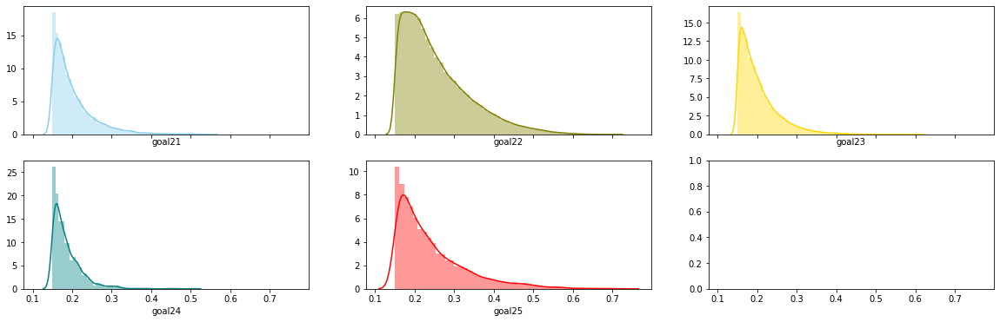

In [0]:
t=.15
f, axes = plt.subplots(2, 3, figsize=(20, 6), sharex=True)
sns.distplot( df["goal21"][df["goal21"]>t] , color="skyblue", ax=axes[0, 0])
sns.distplot( df["goal22"][df["goal22"]>t] , color="olive", ax=axes[0, 1])
sns.distplot( df["goal23"][df["goal23"]>t] , color="gold", ax=axes[0, 2])
sns.distplot( df["goal24"][df["goal24"]>t] , color="teal", ax=axes[1, 0])
sns.distplot( df["goal25"][df["goal25"]>t] , color="red", ax=axes[1, 1]);

## AVG subm2_4_opt_params & subm2_2

In [0]:
subm2_2 = pd.read_csv('/content/drive/My Drive/ottrip_subm/subm2_2.csv')
subm2_4_opt_params = pd.read_csv('/content/drive/My Drive/ottrip_subm/subm2_4_opt_params.csv')

In [0]:
subm2_2[:3]

,Unnamed: 0,goal21,goal22,goal23,goal24,goal25
0,0,0.029837,0.169828,0.000192,0.000070,0.001767
1,1,0.007735,0.034065,0.000059,0.017248,0.008566
2,2,0.104764,0.002281,0.000054,0.206103,0.115626


In [0]:
subm2_4_opt_params[:3]

,Unnamed: 0,goal21,goal22,goal23,goal24,goal25
0,0,0.031965,0.171743,0.000061,0.000040,0.002194
1,1,0.007021,0.033942,0.000020,0.014954,0.009978
2,2,0.115634,0.001444,0.000015,0.196555,0.128621


In [0]:
subm2_AVG1 = ((subm2_2+subm2_4_opt_params)/2).filter(regex='goal')

In [0]:
subm2_AVG1.to_csv( os.path.join(colab_subm_path, 'subm2_AVG1.csv'))

## AVG 2.5 & 2.2  0.739901

In [0]:
PATH = pathlib.Path(colab_subm_path)
s2_5 = pd.read_csv(PATH/'subm2_5.csv')
s2_2 = pd.read_csv(PATH/'subm2_2.csv')
s2_5.shape, s2_2.shape

((455011, 6), (455011, 6))

In [0]:
subm2_AVG2 = s2_5.copy()

In [0]:
subm2_AVG2.goal24 = s2_2.goal24
subm2_AVG2.goal25 = s2_2.goal25
subm2_AVG2[:3]

,Unnamed: 0,goal21,goal22,goal23,goal24,goal25
0,0,0.031965,0.152154,0.000192,0.000070,0.001767
1,1,0.007021,0.029539,0.000059,0.017248,0.008566
2,2,0.115634,0.001854,0.000054,0.206103,0.115626


In [0]:
subm2_AVG2.filter(regex='goal').to_csv( PATH/'subm2_AVG2.csv') # 0.739901

## 2.6 Catboost

In [0]:
Xtrain[:3]

,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,INDICATOR_CNT,USR_CNT,DIFF_H,DIFF_M,CHILD,f14_id_median,f1_id_median,f1_id_std,f14_id_std,f27_id_median,f27_id_std,DAYS_BEFORE_DEPART_id_median,DAYS_BEFORE_DEPART_id_std,NDAYS_FROM_LAST_id_median,NDAYS_FROM_LAST_id_std,field13_id_median,field13_id_std,field26_id_median,field26_id_std,field19_id_median,field19_id_std,field1_sem,field14_sem,field26_sem,field27_sem,field12_sem,NDAYS_FROM_LAST_sem,field13_sem,field22_sem,field25_sem,field1_field14,field26_field27,INDICATOR21_TOTAL_AVG,INDICATOR22_TOTAL_AVG,INDICATOR23_TOTAL_AVG,INDICATOR24_TOTAL_AVG,INDICATOR25_TOTAL_AVG
0,-0.407652,-0.626508,11,12,-0.151820,1,0,1,0,9,-0.354948,-0.125659,-0.661308,1,-0.457289,-0.234311,4,-1.099900,1,1,-0.513581,15,1,-0.333612,-0.446432,1,0,1,1,0,1,1,0.799805,-0.176232,6,1,0,-0.661308,-0.626508,0.000000,0.000000,1.0,0.000000,4.0,0.000000,0.0,0.000000,20.0,0.000000,2.0,0.000000,1.0,0.000000,-1.000000,-1.000000,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-0.205231,0.934400,0.250000,0.250000,0.000000,0.250000,0.250000
1,1.658223,-0.393794,5,7,-0.096555,0,0,0,0,21,5.739278,-0.418075,-0.101043,1,1.626306,-0.234311,5,-1.099900,6,0,1.108053,15,1,3.107066,-0.211373,1,0,1,1,0,1,0,0.600098,-0.144156,6,2,0,-0.171076,-0.393794,0.000000,0.099042,2.0,1.414214,48.5,12.020815,72.0,101.823376,23.5,28.991378,7.5,6.363961,1.5,0.707107,0.000000,0.070033,4.5,1.0,46.0,72.0,20.5,18.5,5.5,-0.347323,1.184775,0.333333,0.333333,0.000000,0.333333,0.000000
2,1.514759,-0.548937,2,3,-0.096555,0,0,1,1,7,-0.405733,-0.418075,-0.661308,1,-0.457289,-0.234311,2,0.944527,6,0,-0.297364,14,1,-0.333612,1.669100,7,0,1,1,0,1,1,0.799805,-0.144156,7,1,0,-0.661308,-0.587722,0.054851,0.000000,7.0,0.000000,3.5,0.707107,67.0,94.752309,4.0,1.414214,11.0,0.000000,2.0,1.414214,0.038786,0.000000,0.0,0.0,5.0,67.0,1.0,8.0,0.0,-0.249150,-1.569351,0.222222,0.222222,0.111111,0.222222,0.222222


In [0]:
INDIC_AVG = Xtrain.filter(regex='AVG').columns.tolist()

In [0]:
use_cols = Xtrain.columns.difference(INDIC_AVG).tolist()

In [4]:
params_cb = {# 'iterations': 500,
            #  'cat_features': cats_indices,
              'loss_function': 'Logloss',
              'learning_rate': 0.05,
            #  'callbacks': [cat.reset_parameter(learning_rate=learning_rate_005_decay_power_099)],
              # 'eval_metric': 'AUC',
              'task_type': 'GPU',
              'random_seed': SEED,
              # 'logging_level': 'Silent',
              'l2_leaf_reg': 3,
              'bagging_temperature': 0.5,
              'random_strength': 1,
              'one_hot_max_size': 24,
              'leaf_estimation_method': 'Newton',
              'leaf_estimation_iterations': 10,
            #  'per_float_feature_quantization': ['10:border_count=512']
              # 'od_type': 'Iter',
              # 'od_wait': 20,
              # 'use_best_model': False
              #  'depth': 6
          }

goals_cols=['goal21', 'goal22', 'goal23', 'goal24', 'goal25']
df_res = pd.DataFrame()
df_scores = pd.DataFrame(index=goals_cols, columns=['avg', 'std'])

for col in goals_cols:

    print(f'target: {col}')
    Y = targets[col]

    n_fold = 10
    folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

    res_dict=train_model_classification(X=Xtrain, X_test=Xtest, y=Y, params=params_cb, folds=folds, model_type='cat', eval_metric='auc', 
                                  columns=use_cols, plot_feature_importance=False, model=None,
                                  verbose=500, early_stopping_rounds=200, n_estimators=1200)
   
    df_res[col] = res_dict['prediction'][:, 1]
    df_scores.ix[col, 'avg'] = np.round(np.mean(res_dict['scores']), 4)
    df_scores.ix[col, 'std'] = np.round(np.std(res_dict['scores']), 4)
    
    print(f'{col} completed!')
    print('='*5)

PATH_TO_SAVE=pathlib.Path(colab_subm_path)
df_res.to_csv( PATH_TO_SAVE/'subm2_6_cat_drop_indic.csv' )

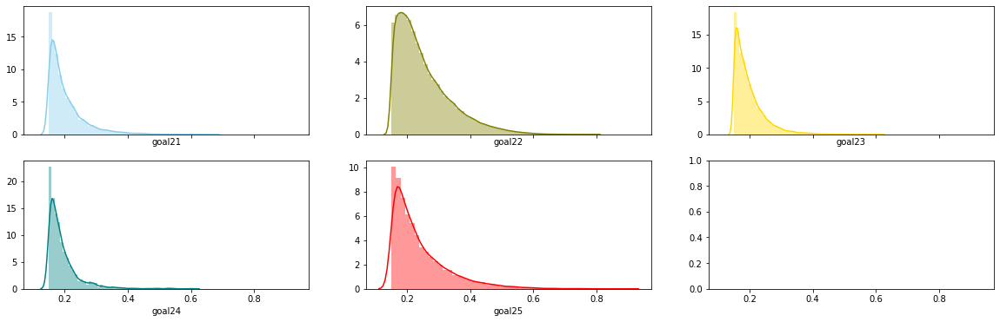

In [0]:
t=.15
f, axes = plt.subplots(2, 3, figsize=(20, 6), sharex=True)
sns.distplot( df_res["goal21"][df_res["goal21"]>t] , color="skyblue", ax=axes[0, 0])
sns.distplot( df_res["goal22"][df_res["goal22"]>t] , color="olive", ax=axes[0, 1])
sns.distplot( df_res["goal23"][df_res["goal23"]>t] , color="gold", ax=axes[0, 2])
sns.distplot( df_res["goal24"][df_res["goal24"]>t] , color="teal", ax=axes[1, 0])
sns.distplot( df_res["goal25"][df_res["goal25"]>t] , color="red", ax=axes[1, 1]);

In [0]:
# without INDICATOR_AVG 0.738664

In [0]:
df_scores # with INDICATOR_AVG # 0.7385770

,avg,std
goal21,0.7392,0.0057
goal22,0.7398,0.0039
goal23,0.9041,0.0043
goal24,0.8101,0.008
goal25,0.938,0.0056


In [0]:
np.array(df_scores.avg).T@ np.array([0.28, 0.27, 0.09, 0.18, 0.18])

0.802749

# SUBM 1

## 1.1 0.668593

In [0]:
df_test = feature_engineering(df_test)
df_test.shape

Mem. usage decreased to 140.59 Mb (5.5% reduction)


(455011, 73)

In [0]:
df_test.shape
df_test[:3]

,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,USR_CNT,INDICATOR_CNT,DIFF_H,DIFF_M,CHILD,f14_id_median,f1_id_median,f1_id_std,f14_id_std,f26_id_median,f27_id_median,f26_id_std,f27_id_std,DAYS_BEFORE_DEPART_id_median,DAYS_BEFORE_DEPART_id_std,NDAYS_FROM_LAST_id_median,NDAYS_FROM_LAST_id_std,ORDER_OF_BUY_id_median,ORDER_OF_BUY_id_std,field13_id_median,field13_id_std,field26_id_median,field26_id_std,field19_id_median,field19_id_std,field1_sem,field14_sem,field26_sem,field27_sem,field12_sem,NDAYS_FROM_LAST_sem,field13_sem,field22_sem,field25_sem,field1_field14,field26_field27
0,0,60209,0,-0.548937,10,10,1,1,0,1,1,0,1,23,2,23,-0.521242,1,1,1,2,2,3,1,20,15,1,1,1,1,0,4,1,1,0,0,1,2,0.600098,8,0,0,-0.521242,-0.548937,0.0,0.0,1.0,1.0,0.000000,0.00000,1.5,0.707107,1.0,1.414214,1.5,0.707107,13.5,13.435029,1.0,0.000000,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,9.500000,8.000000,0.0,112,10
1,1,47274,82,-0.626508,3,4,3,0,0,1,1,0,1,14,4,3,-0.661308,1,19,1,6,1,4,0,17,14,1,1,1,1,0,1,1,1,0,1,1,3,0.799805,0,1,0,-0.661308,-0.626508,0.0,0.0,1.0,1.0,0.000000,0.00000,19.0,13.503086,6.0,45.709226,2.0,1.000000,3.0,1.154701,1.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,1.0,26.390234,0.666667,5.333333,0.0,128,10
2,2,33843,0,-0.548937,6,8,1,1,0,0,1,0,1,13,4,3,-0.521242,1,39,1,1,1,5,1,101,8,1,35,1,1,0,2,1,0,0,1,1,2,0.600098,5,2,0,-0.521242,-0.548937,0.0,0.0,3.5,2.5,3.535534,2.12132,39.0,0.000000,0.0,0.000000,1.5,0.707107,3.0,0.000000,3.5,3.535534,1.0,0.0,0.0,0.0,2.5,1.5,0.0,0.000000,0.000000,0.000000,0.0,112,10


In [0]:
drop_cols = ['orderid', 'userid', 'goal1', 'QUARTER', 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27']
target = 'goal1'

X = df.drop(drop_cols+goals_cols, axis=1)
Y = df[target]

In [0]:
drop_cols_test = ['orderid', 'userid', 'QUARTER', 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27']

X_test = df_test.drop(drop_cols_test, axis=1)

X.shape, X_test.shape

((196056, 65), (455011, 65))

In [0]:
params_ = {'boosting': 'gbdt',
          'objective':'binary',
          'metric': 'auc',
          'learning_rate': 0.01, # 0.003! #0.005 #0.006 
          'num_leaves': 110, #110 #100 #150 large, but over-fitting
          'max_bin': 66,  #60 #50 # large,but slower,over-fitting
          'max_depth': 10, # deal with over-fitting
          'min_data_in_leaf': 30, # deal with over-fitting
          'min_child_samples': 20,
          'feature_fraction': 0.5,#0.5 #0.6 #0.8
          'bagging_fraction': 0.8,
          'bagging_freq': 40,#5  
          'bagging_seed': 11,
          'lambda_l1': 2,#1.3! #5 #1.2 #1
          'lambda_l2': 0.1, #0.1
          'random_state': SEED
         }


clf_final = lgb.LGBMClassifier(**params_)
clf_final.fit(X, Y, callbacks=[lgb.reset_parameter(learning_rate=learning_rate_010_decay_power_0995)])

LGBMClassifier(bagging_fraction=0.8, bagging_freq=40, bagging_seed=11,
               boosting='gbdt', boosting_type='gbdt', class_weight=None,
               colsample_bytree=1.0, feature_fraction=0.5,
               importance_type='split', lambda_l1=2, lambda_l2=0.1,
               learning_rate=0.01, max_bin=66, max_depth=10, metric='auc',
               min_child_samples=20, min_child_weight=0.001,
               min_data_in_leaf=30, min_split_gain=0.0, n_estimators=100,
               n_jobs=-1, num_leaves=110, objective='binary', random_state=17,
               reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)

In [0]:
preds = clf_final.predict_proba(X_test)[:, 1]

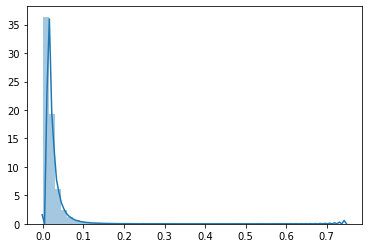

In [0]:
sns.distplot(preds);

In [0]:
n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

# X = df_train
# Y = df_copy.goal1

clf_final = lgb.LGBMClassifier(**params_)
clf_final.fit(X, Y, callbacks=[lgb.reset_parameter(learning_rate=learning_rate_010_decay_power_0995)])

res_dict=train_model_classification(X=X, X_test=df_test, y=Y, params=params_, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=50000)

df_test['goal1'] = res_dict['prediction'][:, 1]

probas_1 = pd.DataFrame(df_test['goal1'])
    
colab_path = '/content/drive/My Drive/'
probas_1.to_csv( os.path.join(colab_path,'sub1_2.csv') )

<bound method LGBMModel.get_params of LGBMClassifier(bagging_fraction=0.8, bagging_freq=40, bagging_seed=11,
               boosting='gbdt', boosting_type='gbdt', class_weight=None,
               colsample_bytree=1.0, feature_fraction=0.5,
               importance_type='split', lambda_l1=2, lambda_l2=0.1,
               learning_rate=0.01, max_bin=66, max_depth=10, metric='auc',
               min_child_samples=20, min_child_weight=0.001,
               min_data_in_leaf=30, min_split_gain=0.0, n_estimators=100,
               n_jobs=-1, num_leaves=110, objective='binary', random_state=17,
               reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)>

In [0]:
load_sumbission(df_test, preds) # LB 0.668593

## 1.3 0.6865750

In [0]:
df_scale = df.copy()
df_test_scale = df_test.copy()

drop_cols = ['orderid', 'userid', 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']

transformer = StandardScaler()
transformer.fit(df_scale[to_scale])
df_scale[to_scale] = transformer.transform(df_scale[to_scale])
df_test_scale[to_scale] = transformer.transform(df_test_scale[to_scale])

X = df_scale.drop(drop_cols+goals_cols+['goal1'], axis=1)
Y = df_scale['goal1']
X_test = df_test_scale.drop(drop_cols, axis=1)

X.shape, X_test.shape, len(Y)

((196056, 70), (455011, 70), 196056)

In [0]:
params_ = {'boosting': 'gbdt',
          'objective':'binary',
          'metric': 'auc',
          'learning_rate': 0.01, # 0.003! #0.005 #0.006 
          'num_leaves': 110, #110 #100 #150 large, but over-fitting
          'max_bin': 66,  #60 #50 # large,but slower,over-fitting
          'max_depth': 10, # deal with over-fitting
          'min_data_in_leaf': 30, # deal with over-fitting
          'min_child_samples': 20,
          'feature_fraction': 0.5,#0.5 #0.6 #0.8
          'bagging_fraction': 0.8,
          'bagging_freq': 40,#5  
          'bagging_seed': 11,
          'lambda_l1': 2,#1.3! #5 #1.2 #1
          'lambda_l2': 0.1,
           'random_state': SEED
         }
n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification(X=X, X_test=X_test, y=Y, params=params_, folds=shuffle_split, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=1000)

Fold 1 started at Mon Jan 13 20:36:24 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[654]	training's auc: 0.938116	training's auc: 0.938116	valid_1's auc: 0.712861	valid_1's auc: 0.712861
Fold 2 started at Mon Jan 13 20:38:37 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[778]	training's auc: 0.951002	training's auc: 0.951002	valid_1's auc: 0.712498	valid_1's auc: 0.712498
Fold 3 started at Mon Jan 13 20:41:09 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[741]	training's auc: 0.949383	training's auc: 0.949383	valid_1's auc: 0.696703	valid_1's auc: 0.696703
Fold 4 started at Mon Jan 13 20:43:35 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[638]	training's auc: 0.938243	training's auc: 0.938243	valid_1's auc: 0.717668	valid_1's auc: 0.717668
Fold 5 started at Mo

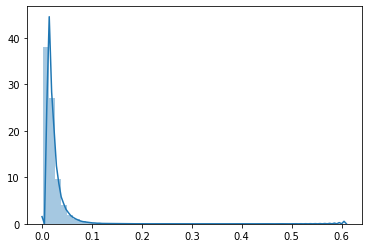

In [0]:
sns.distplot(res_dict['prediction'][:, 1])

In [0]:
load_sumbission(df_test_scale, res_dict['prediction'][:, 1], fname='sub1_3.csv') # 0.6865750

## 1.5 kfold split, agg on train&test: 0.6894060


In [0]:
train = load_ottrip_without_userid_encoding()
test = load_ottrip_without_userid_encoding(train=False)

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)


In [0]:
goals_cols=['goal21', 'goal22', 'goal23', 'goal24', 'goal25']
th = len(train)
df_all = pd.concat([train.drop(columns=goals_cols+['goal1'],axis=1), test])
df_all.shape

(651067, 38)

In [0]:
df_all['userid'] = LabelEncoder().fit_transform(df_all.userid)
df_all['USR_CNT'] = df_all.userid.map(df_all.groupby('userid').size())
df_all = feature_engineering(df_all)

df_all[:2]

Mem. usage decreased to 201.17 Mb (8.2% reduction)


,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,INDICATOR_CNT,USR_CNT,DIFF_H,DIFF_M,CHILD,f14_id_median,f1_id_median,f1_id_std,f14_id_std,f26_id_median,f27_id_median,f26_id_std,f27_id_std,DAYS_BEFORE_DEPART_id_median,DAYS_BEFORE_DEPART_id_std,NDAYS_FROM_LAST_id_median,NDAYS_FROM_LAST_id_std,ORDER_OF_BUY_id_median,ORDER_OF_BUY_id_std,field13_id_median,field13_id_std,field26_id_median,field26_id_std,field19_id_median,field19_id_std,field1_sem,field14_sem,field26_sem,field27_sem,field12_sem,NDAYS_FROM_LAST_sem,field13_sem,field22_sem,field25_sem,field1_field14,field26_field27
0,0,24831,0,-0.626508,11,12,1,1,0,1,1,0,0,9,5,20,-0.661308,1,4,1,4,1,1,1,1,15,1,1,2,1,0,4,1,1,0,1,1,0.799805,1,6,1,0,-0.661308,-0.626508,-1.0,-1.000000,2.0,1.0,-1.000000,-1.000000,4.0,-1.000000,0.0,-1.000000,1.0,-1.000000,20.0,-1.000000,2.0,-1.000000,1.0,-1.000000,-1.0,-1.000000,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,143,21
1,1,109973,144,-0.393794,5,7,2,0,0,0,1,0,0,21,125,3,-0.101043,1,57,1,5,1,6,0,121,15,1,41,3,1,0,2,1,1,0,1,0,0.600098,2,6,2,0,-0.171076,-0.393794,0.0,0.099042,7.5,2.0,6.363961,1.414214,48.5,12.020815,72.0,101.823376,1.5,0.707107,23.5,28.991378,7.5,6.363961,1.5,0.707107,0.0,0.070033,4.5,1.0,46.0,72.0,20.5,18.5,5.5,88,23


In [0]:
# scaling
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']

df_all[to_scale] = StandardScaler().fit_transform(df_all[to_scale])
df_all[to_scale][:2]

,NDAYS_FROM_LAST,ORDER_OF_BUY,field12,field13,field17,DAYS_BEFORE_DEPART,field22,field25,field19,USR_CNT,field1_field14,field26_field27,field26,field1,field14,TICKET_CHILD_1Y,field27
0,-0.407652,-0.151820,-0.354948,-0.125659,-0.234311,-0.457289,-0.513581,-0.333612,-1.0999,-0.176232,-0.205231,0.934400,-0.446432,-0.626509,-0.661309,-0.144602,-0.544868
1,1.658223,-0.096555,5.739278,-0.418075,-0.234311,1.626306,1.108053,3.107066,-1.0999,-0.144156,-0.347323,1.184775,-0.211373,-0.393794,-0.101043,-0.144602,-0.544868


In [0]:
# split df_all
drop_cols = ['orderid', 'userid', 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'

X = df_all[:th].drop(drop_cols, axis=1)
X_test = df_all[th:].drop(drop_cols, axis=1)
Y = train['goal1']
X.shape, X_test.shape, len(Y)

((196056, 70), (455011, 70), 196056)

In [0]:
X_test.reset_index(drop=True, inplace=True)

In [0]:
params_ = {'boosting': 'gbdt',
          'objective':'binary',
          'metric': 'auc',
          'learning_rate': 0.01, # 0.003! #0.005 #0.006 
          'num_leaves': 110, #110 #100 #150 large, but over-fitting
          'max_bin': 66,  #60 #50 # large,but slower,over-fitting
          'max_depth': 10, # deal with over-fitting
          'min_data_in_leaf': 30, # deal with over-fitting
          'min_child_samples': 20,
          'feature_fraction': 0.5,#0.5 #0.6 #0.8
          'bagging_fraction': 0.8,
          'bagging_freq': 40,#5  
          'bagging_seed': 11,
          'lambda_l1': 2,#1.3! #5 #1.2 #1
          'lambda_l2': 0.1,
           'random_state': SEED
         }
n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification(X=X, X_test=X_test, y=Y, params=params_, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=1000)

Fold 1 started at Tue Jan 14 11:54:03 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[601]	training's auc: 0.913968	training's auc: 0.913968	valid_1's auc: 0.700556	valid_1's auc: 0.700556
Fold 2 started at Tue Jan 14 11:56:02 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[583]	training's auc: 0.909682	training's auc: 0.909682	valid_1's auc: 0.71222	valid_1's auc: 0.71222
Fold 3 started at Tue Jan 14 11:57:57 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[434]	training's auc: 0.889182	training's auc: 0.889182	valid_1's auc: 0.733725	valid_1's auc: 0.733725
Fold 4 started at Tue Jan 14 11:59:30 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[680]	training's auc: 0.919948	training's auc: 0.919948	valid_1's auc: 0.710631	valid_1's auc: 0.710631
Fold 5 started at Tue 

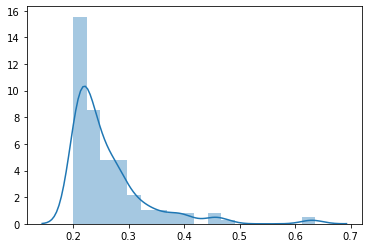

In [0]:
# shuffle_split
# pred = res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .2]
# sns.distplot(pred)

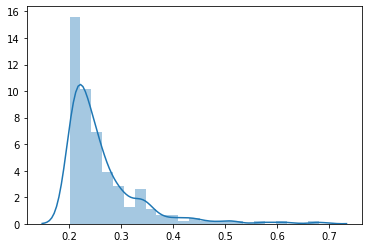

In [0]:
pred = res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .2]
sns.distplot(pred)

In [0]:
load_submission(df_test, res_dict['prediction'][:, 1], fname='sub1_5.csv') # 0.6894060

## 1.6_drop_corr 0.689299

In [0]:
# hcorr = drop_corr_cols(df_all)
hcorr

['TICKET_ADULT',
 'CHILD',
 'f14_id_std',
 'ORDER_OF_BUY_id_median',
 'ORDER_OF_BUY_id_std',
 'field26_id_median',
 'field26_id_std',
 'field19_id_median',
 'field1_sem',
 'field14_sem',
 'field26_sem',
 'field27_sem',
 'NDAYS_FROM_LAST_sem',
 'field13_sem']

In [0]:
X_train_corr = X.drop(hcorr, axis=1)
X_test_corr = X_test.drop(hcorr, axis=1)

In [0]:
X_train_corr.shape, X_test_corr.shape

((196056, 56), (455011, 56))

In [0]:
params_ = {'boosting': 'gbdt',
          'objective':'binary',
          'metric': 'auc',
          'learning_rate': 0.01, # 0.003! #0.005 #0.006 
          'num_leaves': 110, #110 #100 #150 large, but over-fitting
          'max_bin': 66,  #60 #50 # large,but slower,over-fitting
          'max_depth': 10, # deal with over-fitting
          'min_data_in_leaf': 30, # deal with over-fitting
          'min_child_samples': 20,
          'feature_fraction': 0.5,#0.5 #0.6 #0.8
          'bagging_fraction': 0.8,
          'bagging_freq': 40,#5  
          'bagging_seed': 11,
          'lambda_l1': 2,#1.3! #5 #1.2 #1
          'lambda_l2': 0.1,
           'random_state': SEED
         }
n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification(X=X_train_corr, X_test=X_test_corr, y=Y, params=params_, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=1000)

Fold 1 started at Tue Jan 14 13:28:37 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[693]	training's auc: 0.923498	training's auc: 0.923498	valid_1's auc: 0.703638	valid_1's auc: 0.703638
Fold 2 started at Tue Jan 14 13:30:44 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[792]	training's auc: 0.929738	training's auc: 0.929738	valid_1's auc: 0.713809	valid_1's auc: 0.713809
Fold 3 started at Tue Jan 14 13:33:05 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[454]	training's auc: 0.890083	training's auc: 0.890083	valid_1's auc: 0.731088	valid_1's auc: 0.731088
Fold 4 started at Tue Jan 14 13:34:34 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[692]	training's auc: 0.91931	training's auc: 0.91931	valid_1's auc: 0.714703	valid_1's auc: 0.714703
Fold 5 started at Tue 

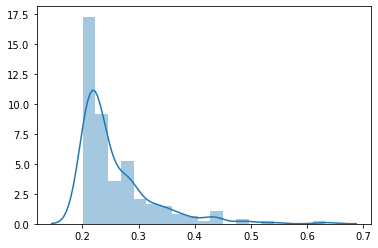

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .2])

In [0]:
load_submission(df_test, res_dict['prediction'][:, 1], fname='sub1_6_drop_corr.csv') # 0.689299

## 1.7  0.691079

In [0]:
train = load_ottrip_without_userid_encoding()
test = load_ottrip_without_userid_encoding(train=False)

goals_cols=['goal21', 'goal22', 'goal23', 'goal24', 'goal25']
th = len(train)
df_all = pd.concat([train.drop(columns=goals_cols+['goal1'],axis=1), test])
df_all.shape

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)


(651067, 38)

In [0]:
df_all['userid'] = LabelEncoder().fit_transform(df_all.userid)
df_all['USR_CNT'] = df_all.userid.map(df_all.groupby('userid').size())
df_all = feature_engineering(df_all)

# scaling
# to_harmonic_cols = df_all.filter(regex='MONTH|DOW|HOUR').columns.tolist()
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['TICKET_CHILD_1Y', 'field27'] # 'field1', 'field14'

df_all[to_scale] = StandardScaler().fit_transform(df_all[to_scale])

# df_all = make_harmonic_features(df_all, to_harmonic_cols)

Mem. usage decreased to 201.17 Mb (8.2% reduction)


In [0]:
# split df_all
drop_cols = ['orderid', 'userid', 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'

X = df_all[:th].drop(drop_cols, axis=1)
# X_test = df_all[th:].drop(drop_cols, axis=1)
Y = train['goal1']
X.shape, len(Y)

del df_all

In [0]:
# params_ = {'boosting': 'gbdt',
#           'objective':'binary',
#           'metric': 'auc',
#           'learning_rate': 0.01, # 0.003! #0.005 #0.006 
#           'num_leaves': 110, #110 #100 #150 large, but over-fitting
#           'max_bin': 66,  #60 #50 # large,but slower,over-fitting
#           'max_depth': 10, # deal with over-fitting
#           'min_data_in_leaf': 30, # deal with over-fitting
#           'min_child_samples': 20,
#           'feature_fraction': 0.5,#0.5 #0.6 #0.8
#           'bagging_fraction': 0.8,
#           'bagging_freq': 40,#5  
#           'bagging_seed': 11,
#           'lambda_l1': 2,#1.3! #5 #1.2 #1
#           'lambda_l2': 0.1,
#            'random_state': SEED
#          }
n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification(X=X, X_test=X_test, y=Y, params=opt_parameters, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=1771)

Fold 1 started at Thu Jan 16 15:22:29 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[117]	training's binary_logloss: 0.0877479	training's auc: 0.827551	valid_1's binary_logloss: 0.1012	valid_1's auc: 0.701444
Fold 2 started at Thu Jan 16 15:23:02 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[188]	training's binary_logloss: 0.0828216	training's auc: 0.859772	valid_1's binary_logloss: 0.0999473	valid_1's auc: 0.70839
Fold 3 started at Thu Jan 16 15:23:41 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[150]	training's binary_logloss: 0.0849654	training's auc: 0.843422	valid_1's binary_logloss: 0.104294	valid_1's auc: 0.730894
Fold 4 started at Thu Jan 16 15:24:17 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[228]	training's binary_logloss: 0.0801074	training's auc

In [0]:
load_submission(test, res_dict['prediction'][:, 1], fname='sub1_8_opt_params.csv') # 0.691079

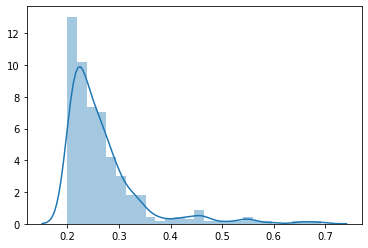

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .2])

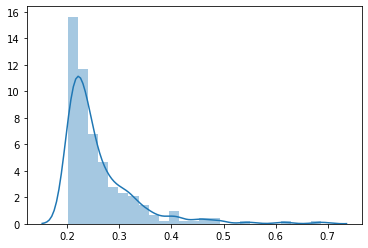

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .2])

## 1.8

In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']
drop_cols = ['orderid', 'userid', 'QUARTER']

with timer('Prepare data to train'):
    X, X_test, targets = combining_ds_stratagy()

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 201.17 Mb (8.2% reduction)
=====
Shape of res data
X: (196056, 70), X_test: (455011, 70), targets: (196056, 6)
[Prepare data to train] done in 291 s


In [0]:
# dr_col=['f14_f17_logvar',
#         'DBD_f22_logstd',
#         'DBD_f12_logmean',
#         'f1_f17_logmean']
#         # 'DBD_f12_logsem',
#         # 'f1_f17_logsem',
#         # 'f25_f26_logsem',
#         # 'DBD_f22_logmean',
#         # 'DBD_HOB_logsem',
#         # 'f17_f19_logsem',
#         # 'DBD_f22_logmedian',
#         # 'DBD_f1_logmedian']

# X.drop(columns=dr_col, axis=1, inplace=True)
# X_test.drop(columns=dr_col, axis=1, inplace=True)

In [0]:
opt_parameters={'bagging_fraction': 0.8743847840486958, 'bagging_freq': 33, 'colsample_bytree': 0.6885590840224551, 
                'feature_fraction': 0.5999345400164748, 'lambda_l1': 2.549820828420092, 'lambda_l2': 0.7316289764010456,
                'max_bin': 58, 'max_depth': 27, 'min_child_samples': 190, 'min_child_weight': 0.1, 'min_data_in_leaf': 30, 
                'num_leaves': 27, 'reg_alpha': 2, 'reg_lambda': 20, 'subsample': 0.7376301706635486 }
                # 'callbacks': [lgb.reset_parameter(learning_rate=learning_rate_010_decay_power_099)] }


n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification(X=X, X_test=X_test, y=targets['goal1'], params=opt_parameters, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=1771)

Fold 1 started at Fri Jan 17 11:25:48 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[88]	training's binary_logloss: 0.0900665	training's auc: 0.809068	valid_1's binary_logloss: 0.101231	valid_1's auc: 0.703302
Fold 2 started at Fri Jan 17 11:26:12 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[156]	training's binary_logloss: 0.0848856	training's auc: 0.847182	valid_1's binary_logloss: 0.100552	valid_1's auc: 0.707412
Fold 3 started at Fri Jan 17 11:26:42 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[45]	training's binary_logloss: 0.0939727	training's auc: 0.765585	valid_1's binary_logloss: 0.105438	valid_1's auc: 0.721769
Fold 4 started at Fri Jan 17 11:27:03 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[134]	training's binary_logloss: 0.0862288	training's auc

In [0]:
load_submission(df_test, res_dict['prediction'][:, 1], fname='sub1_8_logstat_top1.csv') #0.690883 0.69018

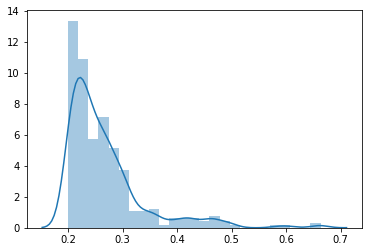

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .2])

## 1.9 optuna_params1 0.690329

In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']
drop_cols = ['orderid', 'userid', 'QUARTER']

with timer('Prepare data to train'):
    X, X_test, targets = combining_ds_stratagy()

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 201.17 Mb (8.2% reduction)
=====
Shape of res data
X: (196056, 70), X_test: (455011, 70), targets: (196056, 6)
[Prepare data to train] done in 249 s


In [0]:
optuna_params1={'lambda_l1': 0.003364025017219649, 'lambda_l2': 2.1345260224486916e-08, 'num_leaves': 99, 'feature_fraction': 0.4198598196260131, 
                'bagging_fraction': 0.879646762474719, 'bagging_freq': 30, 'min_child_samples': 9, 'min_data_in_leaf': 51, 'subsample': 0.8501345828031215, 
                'colsample_bytree': 0.5849497893806658, 'max_bin': 67, 'max_depth': 53, 'learning_rate': 0.0029113451999001772}
#'n_estimators': 3080

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification(X=X, X_test=X_test, y=targets['goal1'], params=optuna_params1, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=3080)

Fold 1 started at Fri Jan 17 17:21:55 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1991]	training's binary_logloss: 0.0723711	training's auc: 0.934277	valid_1's binary_logloss: 0.100457	valid_1's auc: 0.703533
Fold 2 started at Fri Jan 17 17:26:46 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2225]	training's binary_logloss: 0.0704652	training's auc: 0.940302	valid_1's binary_logloss: 0.0994434	valid_1's auc: 0.716309
Fold 3 started at Fri Jan 17 17:32:03 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1539]	training's binary_logloss: 0.0765677	training's auc: 0.913362	valid_1's binary_logloss: 0.103906	valid_1's auc: 0.737052
Fold 4 started at Fri Jan 17 17:35:51 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2662]	training's binary_logloss: 0.0666469	trainin

In [0]:
orderid=pd.read_csv(os.path.join(colab_path , 'onetwotrip_challenge_test.csv'), usecols=['orderid'])
load_submission(orderid, res_dict['prediction'][:, 1], fname='sub1_9_optuna1.csv')

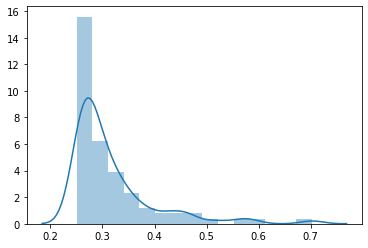

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .25]) # 0.690329

## 1.10 optuna_params2: 0.691545, AVG: **691689**

Fold 1 started at Fri Jan 17 18:18:01 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1565]	training's binary_logloss: 0.0829537	training's auc: 0.873962	valid_1's binary_logloss: 0.100512	valid_1's auc: 0.706556
Fold 2 started at Fri Jan 17 18:21:08 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1959]	training's binary_logloss: 0.080128	training's auc: 0.891833	valid_1's binary_logloss: 0.0997465	valid_1's auc: 0.711026
Fold 3 started at Fri Jan 17 18:24:56 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1137]	training's binary_logloss: 0.0862213	training's auc: 0.846554	valid_1's binary_logloss: 0.104415	valid_1's auc: 0.731194
Fold 4 started at Fri Jan 17 18:27:21 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2113]	training's binary_logloss: 0.0788489	training

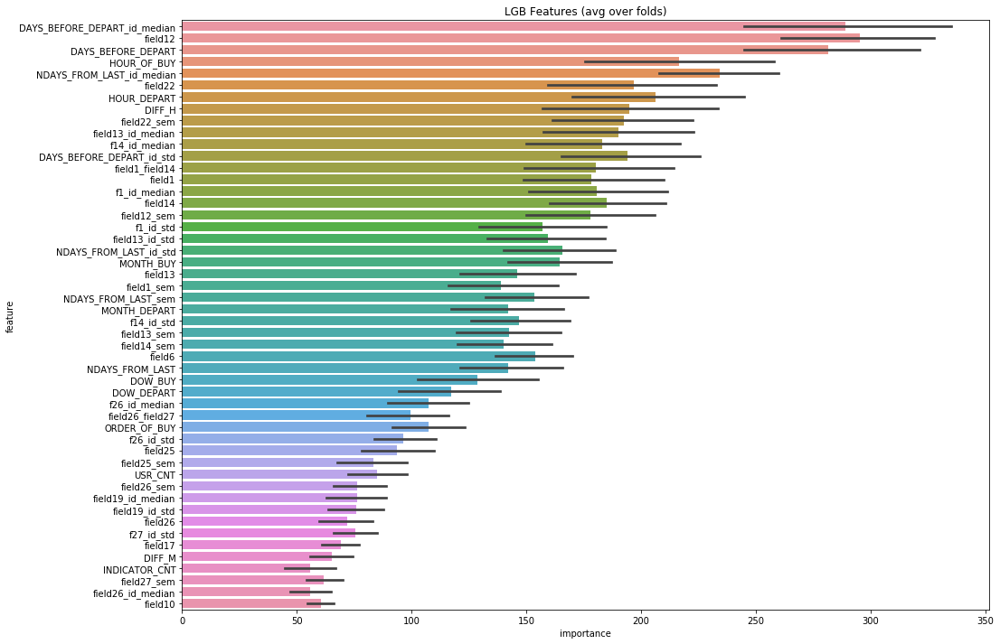

In [0]:
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197}
# 'n_estimators': 3026

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict_2=train_model_classification(X=X, X_test=X_test, y=targets['goal1'], params=optuna_params2, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=True, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=3026)

In [0]:
load_submission(orderid, res_dict_2['prediction'][:, 1], fname='sub1_10_optuna2.csv') # 0.691545

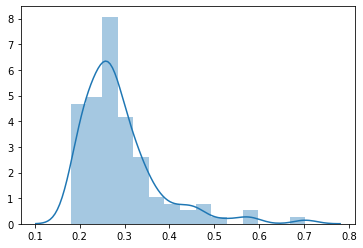

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict_2['prediction'][:, 1] > .25])

In [0]:
sub1_8 = pd.read_csv('/content/drive/My Drive/ottrip_subm/sub1_8_opt_params.csv') 

In [0]:
sub1_10 = res_dict['prediction'][:, 1]

In [0]:
sub1_8.proba = (sub1_8.proba+sub1_10)/2

In [0]:
sub1_8.to_csv( os.path.join(colab_path, 'sub1_8_AVG.csv'), index=False) # 0.691689

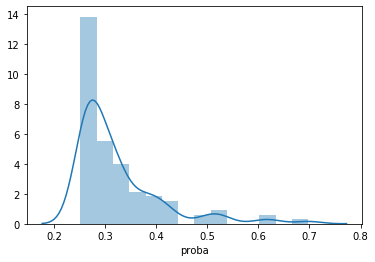

In [0]:
sns.distplot(sub1_8.proba[sub1_8.proba > 0.25])

## 1.11 Feat engineering 2 (mean encoding)

In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']
drop_cols = ['orderid', 'userid', 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'

def combining_ds_stratagy_2(scaling=StandardScaler(), cols_to_scale=to_scale, 
                          cols_to_drop=drop_cols):
  
    '''
    use mean encoding the same feats instead of median one
    '''

    train = load_ottrip_without_userid_encoding()
    test = load_ottrip_without_userid_encoding(train=False)
    # print(f"Shape of raw data\ntrain: {train.shape}, test: {test.shape}")
    print('='*5)

    goals_cols=['goal21', 'goal22', 'goal23', 'goal24', 'goal25']
    th = len(train)
    df_all = pd.concat([train.drop(columns=goals_cols+['goal1'],axis=1), test])
    print(f"Shape of combined data: {df_all.shape}")

    # gen features
    df_all['userid'] = LabelEncoder().fit_transform(df_all.userid)
    df_all['USR_CNT'] = df_all.userid.map(df_all.groupby('userid').size())
    df_all = feature_engineering_2(df_all) # !!! feature_engineering_2 !!!

    # scaling
    df_all[cols_to_scale] = scaling.fit_transform(df_all[cols_to_scale])
    df_all = reduce_mem_usage(df_all, verbose=False)

    # split df_all
    X = df_all[:th].drop(cols_to_drop, axis=1)
    X_test = df_all[th:].drop(cols_to_drop, axis=1)
    X_test.reset_index(drop=True, inplace=True)
    targets = train.loc[:, ['goal1']+goals_cols]

    print('='*5)
    print(f"Shape of res data\nX: {X.shape}, X_test: {X_test.shape}, targets: {targets.shape}")

    return X, X_test, targets

In [0]:
X, X_test, targets = combining_ds_stratagy_2()

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 230.98 Mb (7.2% reduction)
=====
Shape of res data
X: (196056, 76), X_test: (455011, 76), targets: (196056, 6)


Fold 1 started at Sat Jan 18 19:14:02 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1467]	training's binary_logloss: 0.083584	training's auc: 0.871181	valid_1's binary_logloss: 0.100774	valid_1's auc: 0.702637
Fold 2 started at Sat Jan 18 19:16:56 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1667]	training's binary_logloss: 0.0819593	training's auc: 0.880884	valid_1's binary_logloss: 0.100046	valid_1's auc: 0.706434
Fold 3 started at Sat Jan 18 19:20:15 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1329]	training's binary_logloss: 0.0842384	training's auc: 0.864116	valid_1's binary_logloss: 0.104545	valid_1's auc: 0.72842
Fold 4 started at Sat Jan 18 19:23:01 2020
Training until validation scores don't improve for 200 rounds.
Did not meet early stopping. Best iteration is:
[3026]	training's binary_logloss: 0.07230

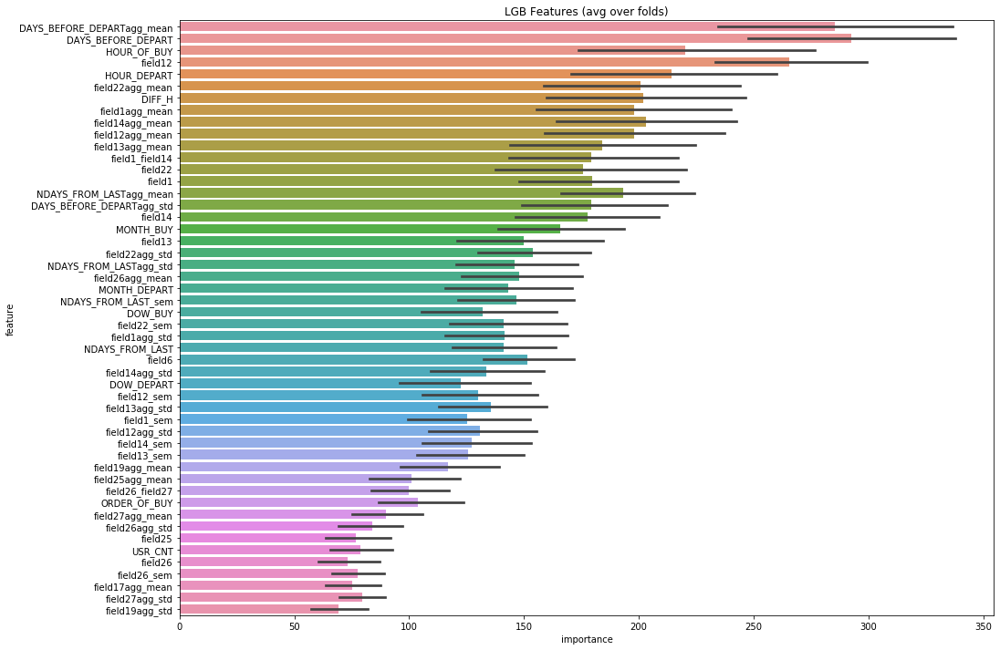

In [0]:
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197}
# 'n_estimators': 3026

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict_2=train_model_classification(X=X, X_test=X_test, y=targets['goal1'], params=optuna_params2, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=True, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=3026)

In [0]:
load_submission(X_test, res_dict_2['prediction'][:, 1], fname='sub1_11_mean_enc.csv')

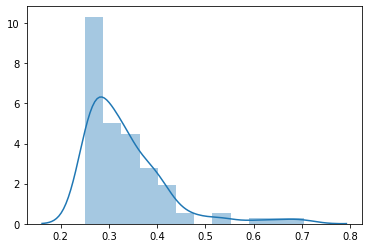

In [0]:
sns.distplot(res_dict_2['prediction'][:, 1][res_dict_2['prediction'][:, 1] > .25])

## 1.12 Median & Mean of the best feats

In [0]:
def feature_engineering_3(df):

  df['DIFF_H']=abs(df['HOUR_DEPART']-df['HOUR_OF_BUY']).astype('int32')
  df['DIFF_M']=abs(df['MONTH_DEPART']-df['MONTH_BUY']).astype('int32')
  df['CHILD'] = df.TOTAL_TICKETS- df.TICKET_ADULT

  df['f14_id_median'] = df.userid.map(df.groupby('userid')['field14'].median().fillna(-1))
  df['f1_id_median'] = df.userid.map(df.groupby('userid')['field1'].median().fillna(-1))
  df['f1_id_std'] = df.userid.map(df.groupby('userid')['field1'].std().fillna(-1))
  df['f14_id_std'] = df.userid.map(df.groupby('userid')['field14'].std().fillna(-1))
  df['f26_id_median'] = df.userid.map(df.groupby('userid')['field26'].median().fillna(-1))
  df['f27_id_median'] = df.userid.map(df.groupby('userid')['field27'].median().fillna(-1))
  df['f26_id_std'] = df.userid.map(df.groupby('userid')['field26'].std().fillna(-1))
  df['f27_id_std'] = df.userid.map(df.groupby('userid')['field27'].std().fillna(-1))
  df['DAYS_BEFORE_DEPART_id_median'] = df.userid.map(df.groupby('userid')['DAYS_BEFORE_DEPART'].median().fillna(-1))
  df['DAYS_BEFORE_DEPART_id_std'] = df.userid.map(df.groupby('userid')['DAYS_BEFORE_DEPART'].std().fillna(-1))
  df['NDAYS_FROM_LAST_id_median'] = df.userid.map(df.groupby('userid')['NDAYS_FROM_LAST'].median().fillna(-1))
  df['NDAYS_FROM_LAST_id_std'] = df.userid.map(df.groupby('userid')['NDAYS_FROM_LAST'].std().fillna(-1))
  df['ORDER_OF_BUY_id_median'] = df.userid.map(df.groupby('userid')['ORDER_OF_BUY'].median().fillna(-1))
  df['ORDER_OF_BUY_id_std'] = df.userid.map(df.groupby('userid')['ORDER_OF_BUY'].std().fillna(-1))
  df['field13_id_median'] = df.userid.map(df.groupby('userid')['field13'].median().fillna(-1))
  df['field13_id_std'] = df.userid.map(df.groupby('userid')['field13'].std().fillna(-1))
  df['field26_id_median'] = df.userid.map(df.groupby('userid')['field26'].median().fillna(-1))
  df['field26_id_std'] = df.userid.map(df.groupby('userid')['field26'].std().fillna(-1))
  df['field19_id_median'] = df.userid.map(df.groupby('userid')['field19'].median().fillna(-1))
  df['field19_id_std'] = df.userid.map(df.groupby('userid')['field19'].std().fillna(-1))

  df = add_sem(df, group_col='userid', used_col=['field1'])
  df = add_sem(df, group_col='userid', used_col=['field14'])
  df = add_sem(df, group_col='userid', used_col=['field26'])
  df = add_sem(df, group_col='userid', used_col=['field27'])
  df = add_sem(df, group_col='userid', used_col=['field12'])
  df = add_sem(df, group_col='userid', used_col=['NDAYS_FROM_LAST'])
  df = add_sem(df, group_col='userid', used_col=['field13'])
  df = add_sem(df, group_col='userid', used_col=['field22'])
  df = add_sem(df, group_col='userid', used_col=['field25'])

  # indicator_cols=list(filter(lambda x: 'indicat' in x, df.columns))
  # df = add_sem(df, group_col=['field14'], used_col=indicator_cols)

  make_conj(df, 'field1', 'field14')
  make_conj(df, 'field26', 'field27')

  df['field22_id_mean'] = df.userid.map(df.groupby('userid')['field22'].mean().fillna(-1))
  df['field26_id_mean'] = df.userid.map(df.groupby('userid')['field26'].mean().fillna(-1))
  df['field1_id_mean'] = df.userid.map(df.groupby('userid')['field1'].mean().fillna(-1))
  df['field14_id_mean'] = df.userid.map(df.groupby('userid')['field14'].mean().fillna(-1))
  df['field12_id_mean'] = df.userid.map(df.groupby('userid')['field12'].mean().fillna(-1))
  df['field13_id_mean'] = df.userid.map(df.groupby('userid')['field13'].mean().fillna(-1))
  df['NDAYS_FROM_LAST_id_mean'] = df.userid.map(df.groupby('userid')['NDAYS_FROM_LAST'].mean().fillna(-1))
  df['DAYS_BEFORE_DEPART'] = df.userid.map(df.groupby('userid')['DAYS_BEFORE_DEPART'].mean().fillna(-1))
  df = add_sem(df, group_col='userid', used_col=['DAYS_BEFORE_DEPART'])
  
  return reduce_mem_usage(df)

In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']
drop_cols = ['orderid', 'userid', 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'

def combining_ds_strategy_3(scaling=StandardScaler(), cols_to_scale=to_scale, 
                          cols_to_drop=drop_cols):
  
    '''
    use mean encoding the same feats instead of median one
    '''

    train = load_ottrip_without_userid_encoding()
    test = load_ottrip_without_userid_encoding(train=False)
    # print(f"Shape of raw data\ntrain: {train.shape}, test: {test.shape}")
    print('='*5)

    goals_cols=['goal21', 'goal22', 'goal23', 'goal24', 'goal25']
    th = len(train)
    df_all = pd.concat([train.drop(columns=goals_cols+['goal1'],axis=1), test])
    print(f"Shape of combined data: {df_all.shape}")

    # gen features
    df_all['userid'] = LabelEncoder().fit_transform(df_all.userid)
    df_all['USR_CNT'] = df_all.userid.map(df_all.groupby('userid').size())
    df_all = feature_engineering_3(df_all) # !!! feature_engineering_3 !!!

    # scaling
    df_all[cols_to_scale] = scaling.fit_transform(df_all[cols_to_scale])
    df_all = reduce_mem_usage(df_all, verbose=False)

    # split df_all
    X = df_all[:th].drop(cols_to_drop, axis=1)
    X_test = df_all[th:].drop(cols_to_drop, axis=1)
    X_test.reset_index(drop=True, inplace=True)
    targets = train.loc[:, ['goal1']+goals_cols]

    print('='*5)
    print(f"Shape of res data\nX: {X.shape}, X_test: {X_test.shape}, targets: {targets.shape}")

    return X, X_test, targets

In [0]:
X, X_test, _ = combining_ds_strategy_3()

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 244.64 Mb (6.9% reduction)
=====
Shape of res data
X: (196056, 78), X_test: (455011, 78), targets: (196056, 6)


Fold 1 started at Sat Jan 18 20:37:54 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1429]	training's binary_logloss: 0.0842158	training's auc: 0.870411	valid_1's binary_logloss: 0.101217	valid_1's auc: 0.698686
Fold 2 started at Sat Jan 18 20:40:54 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1855]	training's binary_logloss: 0.0809234	training's auc: 0.890927	valid_1's binary_logloss: 0.100224	valid_1's auc: 0.708143
Fold 3 started at Sat Jan 18 20:44:42 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1260]	training's binary_logloss: 0.085266	training's auc: 0.859489	valid_1's binary_logloss: 0.10482	valid_1's auc: 0.725331
Fold 4 started at Sat Jan 18 20:47:27 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2377]	training's binary_logloss: 0.0769076	training's

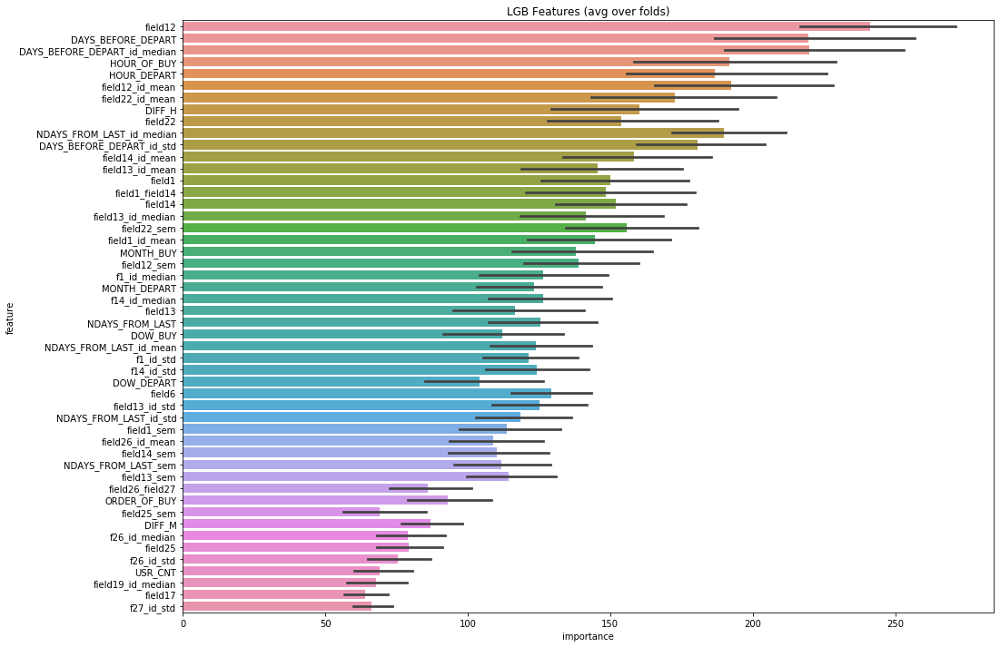

In [0]:
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197}
# 'n_estimators': 3026

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict_2=train_model_classification(X=X, X_test=X_test, y=targets['goal1'], params=optuna_params2, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=True, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=3026)

In [0]:
load_submission(X_test, res_dict_2['prediction'][:, 1], fname='submission_1_2.csv') #

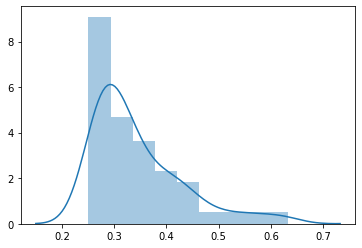

In [0]:
sns.distplot(res_dict_2['prediction'][:, 1][res_dict_2['prediction'][:, 1] > .25])

In [0]:
res=res_dict_2['prediction'][:, 1]

In [0]:
tbl = res_dict_2['feature_importance'].query('importance < 20').groupby('feature').size()

In [0]:
tbl_ = tbl.where(tbl > 5).dropna().index.tolist()

In [0]:
# drop weak feats
tbl_

['CHILD',
 'DAYS_BEFORE_DEPART_sem',
 'TICKET_CHILD_1Y',
 'field5',
 'field7',
 'field8',
 'indicator_goal21',
 'indicator_goal22',
 'indicator_goal25']

In [0]:
def learning_rate_010_decay_power_099(current_iter, base_lr = 0.005):
    base_learning_rate = 0.1
    lr = base_learning_rate  * np.power(.99, current_iter)
    return lr if lr > 1e-3 else 1e-3

0    0.977858
1    0.022142
Name: goal1, dtype: float64

Fold 1 started at Sat Jan 18 22:29:30 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2081]	training's binary_logloss: 0.0792027	training's auc: 0.903056	valid_1's binary_logloss: 0.101021	valid_1's auc: 0.700503
Fold 2 started at Sat Jan 18 22:33:24 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1734]	training's binary_logloss: 0.0819025	training's auc: 0.885167	valid_1's binary_logloss: 0.100335	valid_1's auc: 0.706123
Fold 3 started at Sat Jan 18 22:36:42 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2158]	training's binary_logloss: 0.078106	training's auc: 0.906046	valid_1's binary_logloss: 0.104344	valid_1's auc: 0.727225
Fold 4 started at Sat Jan 18 22:40:40 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2349]	training's binary_logloss: 0.0770584	training'

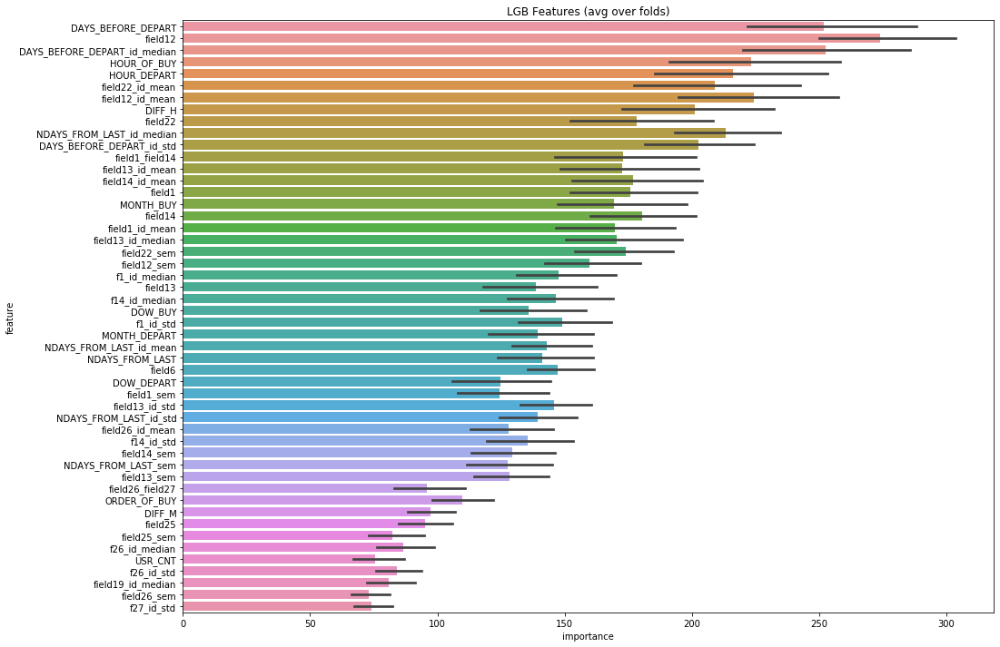

In [0]:
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197, 'scale_pos_weight': 1}
                # 'callbacks': [lgb.reset_parameter(learning_rate=learning_rate_010_decay_power_099)]} #, 
# 'n_estimators': 3026

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict_2=train_model_classification(X=X.drop(columns=tbl_, axis=1), X_test=X_test.drop(columns=tbl_, axis=1), 
                                      y=targets['goal1'], params=optuna_params2, folds=folds, model_type='lgb', eval_metric='auc', 
                                      columns=None, plot_feature_importance=True, model=None, verbose=10000, early_stopping_rounds=200, n_estimators=3026)

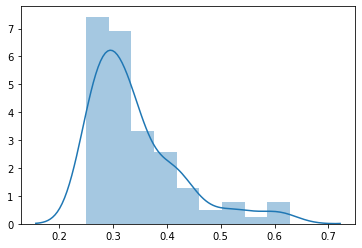

In [0]:
sns.distplot(res_dict_2['prediction'][:, 1][res_dict_2['prediction'][:, 1] > .25])

In [0]:
load_submission(X_test, res_dict_2['prediction'][:, 1], fname='subm1_12_mean_median.csv') # 0.682533

In [0]:
res = res_dict_2['prediction'][:, 1]
len(res[res >= 0.4])

20

In [0]:
best=pd.read_csv('/content/drive/My Drive/ottrip_subm/sub1_8_AVG.csv')

In [0]:
len(best.proba[best.proba>=.4])

15

## 1.13 drop 0.6918190

In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']
drop_cols = ['orderid', 'userid', 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'

Xtrain, Xtest, targets = combining_ds_stratagy(scaling=RobustScaler(), cols_to_scale=to_scale, cols_to_drop=drop_cols)

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 201.17 Mb (8.2% reduction)
=====
Shape of res data
X: (196056, 70), X_test: (455011, 70), targets: (196056, 6)


In [0]:
train.columns

Index(['NDAYS_FROM_LAST', 'field1', 'MONTH_BUY', 'MONTH_DEPART',
       'ORDER_OF_BUY', 'field5', 'field6', 'field7', 'field8',
       'TICKET_CHILD_1Y', 'field10', 'HOUR_OF_BUY', 'field12', 'field13',
       'field14', 'TOTAL_TICKETS', 'DAYS_BEFORE_DEPART', 'field17', 'DOW_BUY',
       'field19', 'DOW_DEPART', 'YEAR', 'field22', 'HOUR_DEPART',
       'TICKET_ADULT', 'field25', 'field26', 'field27', 'TICKET_CHILD_4Y',
       'indicator_goal21', 'indicator_goal22', 'indicator_goal23',
       'indicator_goal24', 'indicator_goal25', 'INDICATOR_CNT', 'USR_CNT',
       'DIFF_H', 'DIFF_M', 'CHILD', 'f14_id_median', 'f1_id_median',
       'f1_id_std', 'f14_id_std', 'f26_id_median', 'f27_id_median',
       'f26_id_std', 'f27_id_std', 'DAYS_BEFORE_DEPART_id_median',
       'DAYS_BEFORE_DEPART_id_std', 'NDAYS_FROM_LAST_id_median',
       'NDAYS_FROM_LAST_id_std', 'ORDER_OF_BUY_id_median',
       'ORDER_OF_BUY_id_std', 'field13_id_median', 'field13_id_std',
       'field26_id_median', 'field26_id

Fold 1 started at Sun Jan 19 18:58:20 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1744]	training's binary_logloss: 0.0816277	training's auc: 0.883724	valid_1's binary_logloss: 0.100575	valid_1's auc: 0.705537
Fold 2 started at Sun Jan 19 19:01:40 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1746]	training's binary_logloss: 0.0817729	training's auc: 0.881854	valid_1's binary_logloss: 0.0995496	valid_1's auc: 0.714
Fold 3 started at Sun Jan 19 19:04:56 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1392]	training's binary_logloss: 0.0840409	training's auc: 0.864828	valid_1's binary_logloss: 0.104224	valid_1's auc: 0.731813
Fold 4 started at Sun Jan 19 19:07:33 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1185]	training's binary_logloss: 0.0861421	training's

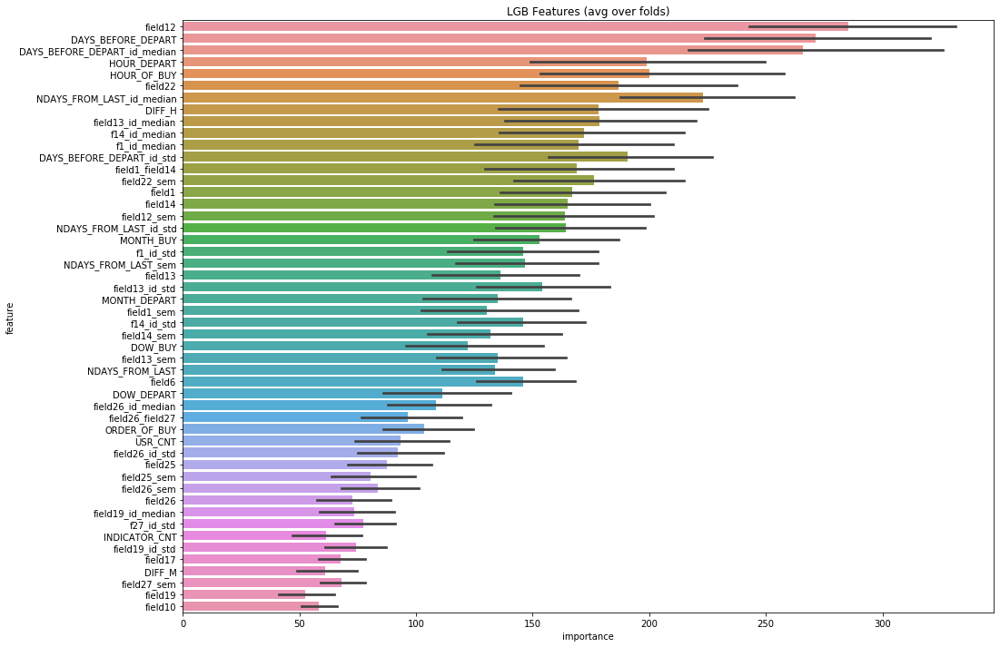

In [0]:
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197}
# 'n_estimators': 3026

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)
dr_c = ['f26_id_median', 'f26_id_std', 'indicator_goal21', 'indicator_goal22', 'ORDER_OF_BUY_id_median', 'ORDER_OF_BUY_id_std']
res_dict=train_model_classification(X=train.drop(columns=dr_c, axis=1), X_test=test.drop(columns=dr_c, axis=1), y=targets['goal1'], 
                                    params=optuna_params2, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=True, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=3026)

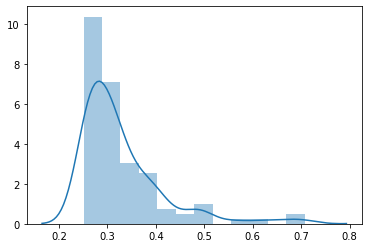

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .25]) # robust scale on standat dataset 0.6912470

In [0]:
load_submission(test, res_dict['prediction'][:, 1], fname='subm1_13_drop.csv') # 0.6918190

In [0]:
res = res_dict['prediction'][:, 1]
len(res[res >= 0.4])

14

## 1.14 add

In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']
drop_cols = ['orderid', 'userid', 'QUARTER', 'indicator_goal21', 'indicator_goal22']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27']

Xtrain, Xtest, targets = combining_ds_stratagy(scaling=StandardScaler(), cols_to_scale=to_scale, cols_to_drop=drop_cols)

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 216.08 Mb (7.7% reduction)
=====
Shape of res data
X: (196056, 71), X_test: (455011, 71), targets: (196056, 6)


Fold 1 started at Sun Jan 19 20:39:03 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1244]	training's binary_logloss: 0.0853578	training's auc: 0.856728	valid_1's binary_logloss: 0.100785	valid_1's auc: 0.70151
Fold 2 started at Sun Jan 19 20:41:36 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2099]	training's binary_logloss: 0.078711	training's auc: 0.900094	valid_1's binary_logloss: 0.0994356	valid_1's auc: 0.714595
Fold 3 started at Sun Jan 19 20:45:27 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1320]	training's binary_logloss: 0.0842375	training's auc: 0.862576	valid_1's binary_logloss: 0.104137	valid_1's auc: 0.73332
Fold 4 started at Sun Jan 19 20:48:01 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2336]	training's binary_logloss: 0.0768439	training's

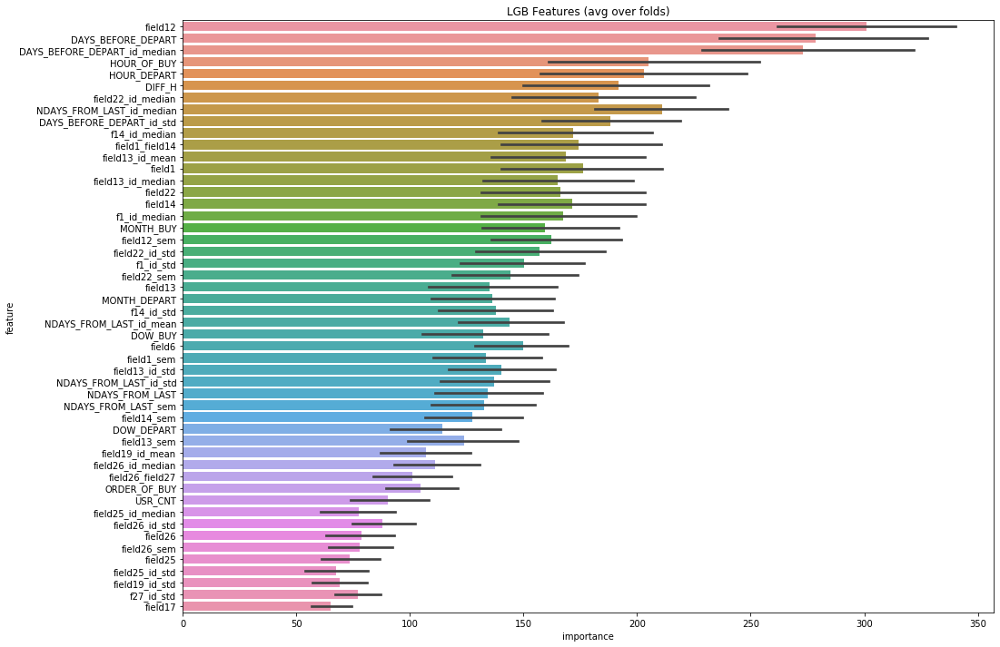

In [0]:
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197}
# 'n_estimators': 3026

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)
dr_c = ['TICKET_CHILD_1Y', 'field8']
res_dict=train_model_classification(X=Xtrain.drop(columns=dr_c, axis=1), X_test=Xtest.drop(columns=dr_c, axis=1), y=targets['goal1'], 
                                    params=optuna_params2, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=True, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=3026)

In [0]:
# load_submission(test, res_dict['prediction'][:, 1], fname='subm1_13_add.csv') # 0.691086

# load_submission(test, res_dict['prediction'][:, 1], fname='subm1_14.csv') # 0.691171

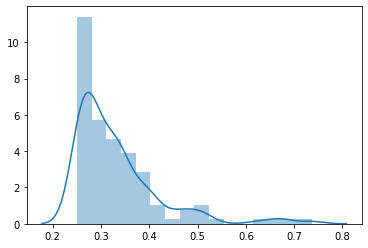

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .25]) 

In [0]:
res = res_dict['prediction'][:, 1]
len(res[res >= 0.4])

16

In [0]:
res_dict['feature_importance'].sort_values(by='importance').head(10)

,feature,importance,fold
9,TICKET_CHILD_1Y,3.4,6
9,TICKET_CHILD_1Y,6.7,4
8,field8,7.7,3
8,field8,7.8,6
36,CHILD,7.9,6
8,field8,8.0,8
9,TICKET_CHILD_1Y,8.2,3
9,TICKET_CHILD_1Y,9.0,8
8,field8,9.1,1
8,field8,9.5,2


## 1.15 Catboost

In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']
drop_cols = ['orderid', 'userid', 'QUARTER', 'TICKET_CHILD_1Y', 'field8', 'indicator_goal21', 'indicator_goal22']+['YEAR']#, 'field1', 'field14', 'field26', 'field27'] 'indicator_goal21', 'indicator_goal22'

Xtrain, Xtest, targets = combining_ds_stratagy(cols_to_drop=drop_cols)

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 181.93 Mb (10.7% reduction)
colsToRemove: [] ,
=====
Shape of res data
X: (196056, 61), X_test: (455011, 61), targets: (196056, 6)


In [0]:
Xtrain[:2]

,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,indicator_goal23,indicator_goal24,indicator_goal25,INDICATOR_CNT,USR_CNT,DIFF_H,DIFF_M,f14_id_median,f1_id_median,f1_id_std,f14_id_std,f27_id_median,f27_id_std,DAYS_BEFORE_DEPART_id_median,DAYS_BEFORE_DEPART_id_std,NDAYS_FROM_LAST_id_median,NDAYS_FROM_LAST_id_std,field13_id_median,field13_id_std,field26_id_median,field26_id_std,field19_id_median,field19_id_std,field1_sem,field14_sem,field26_sem,field27_sem,field12_sem,NDAYS_FROM_LAST_sem,field13_sem,field22_sem,field25_sem,field1_field14,field26_field27,userid_cnt_unq_depart
0,0,-0.626508,11,12,1,1,0,1,0,9,5,20,-0.661308,1,4,1,4,1,1,1,15,1,1,2,1,0,0,1,1,0.799805,1,6,1,-0.661308,-0.626508,0.0,0.000000,1.0,0.000000,4.0,0.000000,0.0,0.000000,20.0,0.000000,2.0,0.000000,1.0,0.000000,-1.0,-1.000000,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,143,21,482
1,144,-0.393794,5,7,2,0,0,0,0,21,125,3,-0.101043,1,57,1,5,1,6,121,15,1,41,3,1,0,0,1,0,0.600098,2,6,2,-0.171076,-0.393794,0.0,0.099042,2.0,1.414214,48.5,12.020815,72.0,101.823376,23.5,28.991378,7.5,6.363961,1.5,0.707107,0.0,0.070033,4.5,1.0,46.0,72.0,20.5,18.5,5.5,88,23,80


In [0]:
cat_features=['MONTH_BUY', 'MONTH_DEPART', 'DOW_BUY', 'DOW_DEPART', 'HOUR_OF_BUY', 'HOUR_DEPART', 'field27'] # indicator_cols 'YEAR' 'field5', 'field7', 'field8', 'field10'
Xtrain[cat_features].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 196056 entries, 0 to 196055
Data columns (total 7 columns):
MONTH_BUY       196056 non-null int8
MONTH_DEPART    196056 non-null int8
DOW_BUY         196056 non-null int8
DOW_DEPART      196056 non-null int8
HOUR_OF_BUY     196056 non-null int8
HOUR_DEPART     196056 non-null int8
field27         196056 non-null int8
dtypes: int8(7)
memory usage: 2.8 MB


In [0]:
Xtrain[cat_features] = Xtrain[cat_features].astype('category')
Xtest[cat_features] = Xtest[cat_features].astype('category')

In [0]:
cats_indices=[Xtrain.columns.get_loc(c) for c in cat_features]
cats_indices

[2, 3, 16, 18, 9, 21, 25]

In [0]:
!pip install catboost==0.7.2

In [0]:
best_params_bayes_goal1={ 'loss_function': 'Logloss',
                          'random_seed': SEED,
                          'leaf_estimation_method': 'Newton',
                          # 'leaf_estimation_iterations': 10,
                          'bagging_temperature': 0.41010395885331385,
                          'border_count': 186,
                          'depth': 8,
                         
                          # 'iterations': 1000,
                          'l2_leaf_reg': 21,
                          'learning_rate': 0.0673344419215237,
                          'random_strength': 3.230824361824754e-06,
                          'scale_pos_weight': 0.7421091918485163,
                          'task_type': 'GPU' }

In [0]:
params_cb = {# 'iterations': 500,
            #  'cat_features': cats_indices,
              'loss_function': 'Logloss',
              'learning_rate': 0.05,
            #  'callbacks': [cat.reset_parameter(learning_rate=learning_rate_005_decay_power_099)],
              # 'eval_metric': 'AUC',
              'task_type': 'GPU',
              'random_seed': SEED,
              # 'logging_level': 'Silent',
              'l2_leaf_reg': 3,
              'bagging_temperature': 0.5,
              'random_strength': 1,
              'one_hot_max_size': 24,
              'leaf_estimation_method': 'Newton',
              'leaf_estimation_iterations': 10,
            #  'per_float_feature_quantization': ['10:border_count=512']
              # 'od_type': 'Iter',
              # 'od_wait': 20,
              # 'use_best_model': False
              #  'depth': 6
          }


remove_cols = ['indicator_goal21', 'indicator_goal22']
dr_cl = ['YEAR', 'CHILD']+ Xtrain.columns[-5:].tolist()
n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification(X=Xtrain, X_test=Xtest, 
                                    y=targets['goal1'], params=best_params_bayes_goal1, folds=folds, model_type='cat', eval_metric='auc',
                                    columns=None, plot_feature_importance=False, model=None, verbose=100, early_stopping_rounds=200, n_estimators=3000)

Fold 1 started at Tue Jan 21 12:07:25 2020


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

CatBoostError: ignored

In [0]:
print(Xtrain.drop(columns=dr_cl, axis=1).columns.tolist(), ',')

['NDAYS_FROM_LAST', 'field1', 'MONTH_BUY', 'MONTH_DEPART', 'ORDER_OF_BUY', 'field5', 'field6', 'field7', 'field10', 'HOUR_OF_BUY', 'field12', 'field13', 'field14', 'TOTAL_TICKETS', 'DAYS_BEFORE_DEPART', 'field17', 'DOW_BUY', 'field19', 'DOW_DEPART', 'field22', 'HOUR_DEPART', 'TICKET_ADULT', 'field25', 'field26', 'field27', 'TICKET_CHILD_4Y', 'indicator_goal23', 'indicator_goal24', 'indicator_goal25', 'INDICATOR_CNT', 'USR_CNT', 'DIFF_H', 'DIFF_M', 'f14_id_median', 'f1_id_median', 'f1_id_std', 'f14_id_std', 'f27_id_median', 'f27_id_std', 'DAYS_BEFORE_DEPART_id_median', 'DAYS_BEFORE_DEPART_id_std', 'NDAYS_FROM_LAST_id_median', 'NDAYS_FROM_LAST_id_std', 'field13_id_median', 'field13_id_std', 'field26_id_median', 'field26_id_std', 'field19_id_median', 'field19_id_std', 'field1_sem', 'field14_sem', 'field26_sem', 'field27_sem', 'field12_sem', 'NDAYS_FROM_LAST_sem', 'field13_sem', 'field22_sem', 'field25_sem', 'field1_field14', 'field26_field27', 'userid_cnt_unq_depart'] ,


In [0]:
# 323 estimators
# CV mean score: 0.6956, std: 0.0127
# CV mean score: 0.6975, std: 0.0111 drop new cols 

# 1000 estimators # CV mean score: 0.7051, std: 0.0114

# 1500 estimators # CV mean score: 0.7045, std: 0.0100
# 2000 # CV mean score: 0.7048, std: 0.0100, bestTest = 0.6943941116
# 2500 # bestTest = 0.7007350922
# 

In [0]:
load_submission(test, res_dict['prediction'][:, 1], fname='task1_catboost.csv') # with cat_indices

In [0]:
load_submission(Xtest, res_dict['prediction'][:, 1], fname='subm1_15_cat.csv') # 0.685478, params_cb, n_estimators 1000, CV mean score: 0.7026, std: 0.0064

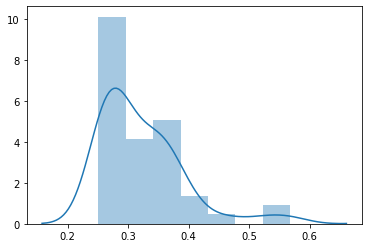

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .25]) 

## 1.15 XGBoost

In [0]:
# def run_xgb(train_X, train_y, val_X, val_y, test_X):
params = {'objective': 'reg:linear', 
          # 'eval_metric': '',
          'eta': 0.001,
          'max_depth': 10, 
          'subsample': 0.6, 
          'colsample_bytree': 0.6,
          'alpha':0.001,
          'random_state': 42, 
          'silent': True}

In [0]:
from skopt import BayesSearchCV
from skopt import gp_minimize # Bayesian optimization using Gaussian Processes
from skopt.space import Real, Categorical, Integer
from skopt.utils import use_named_args # decorator to convert a list of parameters to named arguments
from skopt.callbacks import DeadlineStopper # Stop the optimization before running out of a fixed budget of time.
from skopt.callbacks import VerboseCallback # Callback to control the verbosity
from skopt.callbacks import DeltaXStopper
from sklearn.metrics import make_scorer

clf = xgb.XGBClassifier(
        n_jobs = 1,
        objective = 'binary:logistic',
        silent=1,
        tree_method='approx')

search_spaces = {'learning_rate': Real(0.01, 1.0, 'log-uniform'),
                 'min_child_weight': Integer(0, 10),
                 'max_depth': Integer(0, 50),
                 'max_delta_step': Integer(0, 20),
                 'subsample': Real(0.01, 1.0, 'uniform'),
                 'colsample_bytree': Real(0.01, 1.0, 'uniform'),
                 'colsample_bylevel': Real(0.01, 1.0, 'uniform'),
                 'reg_lambda': Real(1e-9, 1000, 'log-uniform'),
                 'reg_alpha': Real(1e-9, 1.0, 'log-uniform'),
                 'gamma': Real(1e-9, 0.5, 'log-uniform'),
                 'min_child_weight': Integer(0, 5),
                 'n_estimators': Integer(50, 100),
                 'scale_pos_weight': Real(1e-6, 500, 'log-uniform')}

In [0]:
roc_auc = make_scorer(roc_auc_score, greater_is_better=True, needs_threshold=True)

opt = FixedBayesSearchCV(clf,
                        search_spaces,
                        scoring=roc_auc,
                        cv=skf,
                        n_iter=40,
                        n_jobs=-1,
                        return_train_score=False,
                        refit=True,
                        optimizer_kwargs={'base_estimator': 'GP'},
                        random_state=SEED)
        
best_params = report_perf(opt, Xtrain, targets.goal1,'XGBoost',                           
                          callbacks=[DeltaXStopper(0.001), 
                                     DeadlineStopper(60*5)])

TypeError: ignored

In [0]:
params_xgb={'learning_rate': 0.1, 'max_depth': 5,
                        'min_child_weight': 3, 'gamma': 0.2, 'subsample': 0.6, 'colsample_bytree': 1.0,
                        'objective': 'binary:logistic', 'nthread': 4, 'scale_pos_weight': 1, 'seed': SEED}

def xgb_classifier(X_train, X_test, y_train, y_test, useTrainCV=True, cv_folds=5, early_stopping_rounds=50):
    """
    
    ---------------------------------->
    # {'learning_rate': 0.1, 'max_depth': 5, 'min_child_weight': 3} 0.862920874517388
    # {'colsample_bytree': 1.0, 'gamma': 0.2} 0.871
    # {'gamma': 0.2, 'scale_pos_weight': 1} 0.8702009952422571
    # {'subsample': 0.6} 0.864310306628855
    """
    alg = XGBClassifier(learning_rate=0.1, n_estimators=140, max_depth=5,
                        min_child_weight=3, gamma=0.2, subsample=0.6, colsample_bytree=1.0,
                        objective='binary:logistic', nthread=4, scale_pos_weight=1, seed=27)

    if useTrainCV:
        print("Start Feeding Data")
        xgb_param = alg.get_xgb_params()
        xgtrain = xgb.DMatrix(X_train.values, label=y_train.values)
        # xgtest = xgb.DMatrix(X_test.values, label=y_test.values)
        cvresult = xgb.cv(xgb_param, xgtrain, num_boost_round=alg.get_params()['n_estimators'], nfold=cv_folds,
                          early_stopping_rounds=early_stopping_rounds)
        alg.set_params(n_estimators=cvresult.shape[0])

    
    print('Start Training')
    alg.fit(X_train, y_train, eval_metric='auc')

    # param_test1 = {}
    # gsearch1 = GridSearchCV(estimator=XGBClassifier(learning_rate=0.1, n_estimators=140, max_depth=5,
    #                                                 min_child_weight=3, gamma=0.2, subsample=0.8,
    #                                                 colsample_bytree=1.0,
    #                                                 objective='binary:logistic', nthread=4, scale_pos_weight=1,
    #                                                 seed=27),
    #                         param_grid=param_test1,
    #                         scoring='f1',
    #                         n_jobs=4, iid=False, cv=5)
    # gsearch1.fit(X_train, y_train)
    # print(gsearch1.cv_results_, gsearch1.best_params_, gsearch1.best_score_)

    print("Start Predicting")
    # predictions = alg.predict(X_test)
    pred_proba = alg.predict_proba(X_test)[:, 1]
   
    print("AUC: %f" % metrics.roc_auc_score(y_test, pred_proba))
    print("F1 Score: %f" % metrics.f1_score(y_test, predictions))

    feat_imp = alg.feature_importances_
    feat = X_train.columns.tolist()
    # clf.best_estimator_.booster().get_fscore()
    res_df = pd.DataFrame({'Features': feat, 'Importance': feat_imp}).sort_values(by='Importance', ascending=False)
    res_df.plot('Features', 'Importance', kind='bar', title='Feature Importances')
    plt.ylabel('Feature Importance Score')
    plt.show()
    print(res_df)
    print(res_df["Features"].tolist())


Fold 1 started at Mon Jan 20 07:38:30 2020
[0]	train-error:0.02206	valid_data-error:0.022468
Multiple eval metrics have been passed: 'valid_data-error' will be used for early stopping.

Will train until valid_data-error hasn't improved in 200 rounds.
[100]	train-error:0.021933	valid_data-error:0.022417
[139]	train-error:0.021856	valid_data-error:0.022417


IndexError: ignored

In [0]:
import pandas as pd, numpy as np
from sklearn.metrics import roc_auc_score
import xgboost as xgb
from hyperopt import hp, fmin, tpe, STATUS_OK, Trials

In [0]:
drop_addition_cols = ['HOUR_OF_BUY', "DOW_BUY", 'MONTH_BUY']
drop_cols = ['orderid', 'userid', 'goal1']#, 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'
# target = 'goal1'
X, X_test, Y, Y_test = train_test_split(Xtrain,#df_.drop(drop_cols+goals_cols, axis=1), 
                                        targets['goal1'],#df[target], 
                                        stratify=targets['goal1'], random_state=SEED)

X.shape

(147042, 61)

In [0]:
train = X
valid = X_test

y_train = Y
y_valid = Y_test

In [0]:
def objective(space):

    clf = xgb.XGBClassifier(n_estimators = 10000,
                            max_depth = space['max_depth'],
                            min_child_weight = space['min_child_weight'],
                            subsample = space['subsample'])

    eval_set  = [( train, y_train), ( valid, y_valid)]

    clf.fit(train, y_train,
            eval_set=eval_set, eval_metric="auc",
            early_stopping_rounds=30)

    pred = clf.predict_proba(valid)[:,1]
    auc = roc_auc_score(y_valid, pred)
    print("SCORE:", auc)

    return{'loss':1-auc, 'status': STATUS_OK }


space ={
        'max_depth': hp.choice('max_depth', np.arange(1, 31, dtype=int)), #hp.quniform("x_max_depth", 5, 30, 1),
        'min_child_weight': hp.quniform ('x_min_child', 1, 10, 1),
        'subsample': hp.uniform ('x_subsample', 0.8, 1)
    }


trials = Trials()
best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=100,
            trials=trials)

print(best)

[31]	validation_0-auc:0.711371	validation_1-auc:0.675574

[32]	validation_0-auc:0.714153	validation_1-auc:0.676504

[33]	validation_0-auc:0.716091	validation_1-auc:0.676678

[34]	validation_0-auc:0.717031	validation_1-auc:0.676855

[35]	validation_0-auc:0.718621	validation_1-auc:0.678361

[36]	validation_0-auc:0.719781	validation_1-auc:0.678574

[37]	validation_0-auc:0.721277	validation_1-auc:0.678688

[38]	validation_0-auc:0.722849	validation_1-auc:0.679233

[39]	validation_0-auc:0.724118	validation_1-auc:0.679634

[40]	validation_0-auc:0.725898	validation_1-auc:0.6804

[41]	validation_0-auc:0.728192	validation_1-auc:0.680851

[42]	validation_0-auc:0.730513	validation_1-auc:0.682125

[43]	validation_0-auc:0.731983	validation_1-auc:0.682061

[44]	validation_0-auc:0.733545	validation_1-auc:0.683267

[45]	validation_0-auc:0.734887	validation_1-auc:0.683977

[46]	validation_0-auc:0.737203	validation_1-auc:0.684862

[47]	validation_0-auc:0.73872	validation_1-auc:0.685436

[48]	validation_0

In [0]:
import optuna

In [0]:
def opt(X_train, y_train, X_test, y_test, trial):
    #param_list
    n_estimators = trial.suggest_int('n_estimators', 400, 900)
    max_depth = trial.suggest_int('max_depth', 4, 20)
    min_child_weight = trial.suggest_int('min_child_weight', 1, 25)
    learning_rate = trial.suggest_discrete_uniform('learning_rate', 0.005, 0.485, 0.02)
    scale_pos_weight = trial.suggest_int('scale_pos_weight', 1, 30)
    subsample = trial.suggest_discrete_uniform('subsample', 0.6, 1.0, 0.1)
    colsample_bytree = trial.suggest_discrete_uniform('colsample_bytree', 0.6, 1.0, 0.1)
    lambda_l1 = trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
    lambda_l2= trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
    num_leaves= trial.suggest_int('num_leaves', 2, 256)

 
    xgboost_tuna = xgb.XGBClassifier(n_jobs=1,
        random_state=SEED, 
        tree_method='gpu_hist',
        n_estimators = n_estimators,
        max_depth = max_depth,
        min_child_weight = min_child_weight,
        learning_rate = learning_rate,
        scale_pos_weight = scale_pos_weight,
        subsample = subsample,
        colsample_bytree = colsample_bytree
    )
    xgboost_tuna.fit(X_train, y_train)

    tuna_pred_test_proba = xgboost_tuna.predict_proba(X_test)[:,1]
    return roc_auc_score(y_test, tuna_pred_test_proba) #(1.0 - (roc_auc_score(y_test, tuna_pred_test_proba)))

In [0]:
study = optuna.create_study(direction='maximize')
study.optimize(functools.partial(opt, X, Y, X_test, Y_test), n_trials=80)

[I 2020-01-21 15:26:03,492] Finished trial#0 resulted in value: 0.6611129576938547. Current best value is 0.6611129576938547 with parameters: {'n_estimators': 623, 'max_depth': 14, 'min_child_weight': 22, 'learning_rate': 0.265, 'scale_pos_weight': 4, 'subsample': 0.9, 'colsample_bytree': 1.0, 'lambda_l1': 0.00021116503305475837, 'lambda_l2': 0.6507866747042613, 'num_leaves': 82}.
[I 2020-01-21 15:26:06,838] Finished trial#1 resulted in value: 0.6586311472816982. Current best value is 0.6611129576938547 with parameters: {'n_estimators': 623, 'max_depth': 14, 'min_child_weight': 22, 'learning_rate': 0.265, 'scale_pos_weight': 4, 'subsample': 0.9, 'colsample_bytree': 1.0, 'lambda_l1': 0.00021116503305475837, 'lambda_l2': 0.6507866747042613, 'num_leaves': 82}.
[I 2020-01-21 15:26:13,536] Finished trial#2 resulted in value: 0.6979325025025015. Current best value is 0.6979325025025015 with parameters: {'n_estimators': 882, 'max_depth': 6, 'min_child_weight': 3, 'learning_rate': 0.025, 'scal

In [0]:
xgb_opt1={'n_estimators': 523, 'max_depth': 4, 'min_child_weight': 10, 'scale_pos_weight': 8, 'subsample': 0.9, 'colsample_bytree': 0.9} #0.6983629010384312
xgb_opt2={'n_estimators': 626, 'max_depth': 4, 'min_child_weight': 10, 'scale_pos_weight': 4, 'subsample': 0.9, 'colsample_bytree': 1.0} #0.6995366033455976

xgb_opt3={'max_depth': 19, 'min_child_weight': 19, 'learning_rate': 0.005, 'scale_pos_weight': 21, 'subsample': 0.6, "objective": "binary:logistic",  #'n_estimators': 702, 
          'colsample_bytree': 0.6, 'lambda_l1': 0.010819818382437923, 'lambda_l2': 1.105491511289272e-06, 'num_leaves': 20, 'eval_metric': 'auc', 'seed': SEED,
          "eta": 0.1} # 0.7048735971112416

xgb_opt4={'n_estimators': 793, 'max_depth': 20, 'min_child_weight': 9, 'learning_rate': 0.005, 'scale_pos_weight': 19,  # 0.7031200047920345
          'subsample': 0.6, 'colsample_bytree': 1.0, 'lambda_l1': 0.08244365286892293, 'lambda_l2': 2.6355358859033126e-08, 'num_leaves': 3}

In [0]:
n_fold = 5
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification(X=Xtrain, X_test=Xtest, 
                                    y=targets['goal1'], params=xgb_opt3, folds=folds, model_type='xgb', eval_metric='auc',
                                    columns=None, plot_feature_importance=False, model=None, verbose=100, early_stopping_rounds=30, n_estimators=700)

Fold 1 started at Tue Jan 21 18:19:32 2020
[0]	train-auc:0.788724	valid_data-auc:0.591888
Multiple eval metrics have been passed: 'valid_data-auc' will be used for early stopping.

Will train until valid_data-auc hasn't improved in 30 rounds.
[100]	train-auc:0.994078	valid_data-auc:0.689078
[200]	train-auc:0.997162	valid_data-auc:0.692096
Stopping. Best iteration:
[225]	train-auc:0.997594	valid_data-auc:0.693083



ValueError: ignored

## 1.16 overfitting

In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['field27']
drop_cols = ['orderid', 'userid', 'QUARTER', 'indicator_goal21', 'indicator_goal22', 'TICKET_CHILD_1Y', 'field8']#, 'field1', 'field14', 'field26', 'field27']

Xtrain, Xtest, targets = combining_ds_stratagy(scaling=RobustScaler(), cols_to_scale=to_scale, cols_to_drop=drop_cols)

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 181.30 Mb (9.0% reduction)
=====
Shape of res data
X: (196056, 62), X_test: (455011, 62), targets: (196056, 6)


In [0]:
Xtrain['goal1'] = targets['goal1'].copy()

In [0]:
Xtest['goal1'] = Xtrain.goal1.mean()

In [0]:
Xtest[:4]

,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,indicator_goal23,indicator_goal24,indicator_goal25,INDICATOR_CNT,USR_CNT,DIFF_H,DIFF_M,CHILD,f14_id_median,f1_id_median,f1_id_std,f14_id_std,f27_id_median,f27_id_std,DAYS_BEFORE_DEPART_id_median,DAYS_BEFORE_DEPART_id_std,NDAYS_FROM_LAST_id_median,NDAYS_FROM_LAST_id_std,field13_id_median,field13_id_std,field26_id_median,field26_id_std,field19_id_median,field19_id_std,field1_sem,field14_sem,field26_sem,field27_sem,field12_sem,NDAYS_FROM_LAST_sem,field13_sem,field22_sem,field25_sem,field1_field14,field26_field27,goal1
0,0.000000,-0.548937,10,10,0.0,1,0,1,1,23,-0.428571,0.826087,-0.521242,1,-0.3125,0.0,2,0.0,3,1,0.073171,15,1,0.0,-0.25,1,0,0,0,1,0.600098,0.000000,8,0,0,-0.521242,-0.548937,0.000000,0.0,1.0,0.00000,1.5,0.707107,1.0,1.414214,13.5,13.435029,1.0,0.000000,2.0,0.0,0.000000,0.0,0.0,0.0,0.0,1.000000,9.500000,8.000000,0.0,0.000000,0.0,0.022142
1,6.307692,-0.626508,3,4,2.0,0,0,1,1,14,-0.142857,-0.043478,-0.661308,1,0.8125,0.0,6,-0.5,4,0,0.000000,14,1,0.0,-0.25,1,0,0,1,1,0.799805,0.333333,0,1,0,-0.661308,-0.626508,0.000000,0.0,1.0,0.00000,19.0,13.503086,6.0,45.709226,3.0,1.154701,1.0,0.000000,1.0,0.0,0.000000,0.0,0.0,0.0,1.0,26.390234,0.666667,5.333333,0.0,0.108434,0.0,0.022142
2,0.000000,-0.548937,6,8,0.0,1,0,0,1,13,-0.142857,-0.043478,-0.521242,1,2.0625,0.0,1,-0.5,5,1,2.048780,8,1,34.0,-0.25,1,0,0,1,1,0.600098,0.000000,5,2,0,-0.521242,-0.548937,0.000000,0.0,2.5,2.12132,39.0,0.000000,0.0,0.000000,3.0,0.000000,3.5,3.535534,1.0,0.0,0.000000,0.0,2.5,1.5,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.022142
3,0.461538,0.304348,7,7,1.0,0,10,1,0,20,2.000000,-0.043478,0.879422,1,0.7500,0.0,4,-0.5,1,1,-0.024390,16,1,0.0,0.25,1,0,0,1,1,0.799805,0.000000,4,0,0,0.879422,0.769776,0.658215,0.0,1.0,0.00000,21.0,4.242641,3.0,4.242641,3.0,0.000000,3.0,0.000000,1.0,0.0,0.465428,0.0,0.0,0.0,0.0,3.000000,0.000000,0.000000,0.0,0.951807,1.0,0.022142


In [0]:
features = []
for group_cols, prior_cols in groups_and_priors.items():
    features.append(f"gte_{'_'.join(group_cols)}")
    gte = GaussianTargetEncoder(list(group_cols), "goal1", prior_cols)    
    Xtrain[features[-1]] = gte.fit_transform(Xtrain, PRIOR_PRECISION)
    Xtest[features[-1]]  = gte.transform(Xtest,  PRIOR_PRECISION)

In [0]:
Xtest.drop('goal1', 1, inplace=True)
Xtrain.drop('goal1', 1, inplace=True)

Fold 1 started at Mon Jan 20 23:01:09 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2225]	training's binary_logloss: 0.056345	training's auc: 0.962559	valid_1's binary_logloss: 0.0789906	valid_1's auc: 0.85925
Fold 2 started at Mon Jan 20 23:05:30 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2486]	training's binary_logloss: 0.0545914	training's auc: 0.966092	valid_1's binary_logloss: 0.0787033	valid_1's auc: 0.862417
Fold 3 started at Mon Jan 20 23:10:16 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[2019]	training's binary_logloss: 0.0574143	training's auc: 0.959508	valid_1's binary_logloss: 0.080749	valid_1's auc: 0.87083
Fold 4 started at Mon Jan 20 23:14:18 2020
Training until validation scores don't improve for 200 rounds.
Did not meet early stopping. Best iteration is:
[3026]	training's binary_logloss: 0.0514

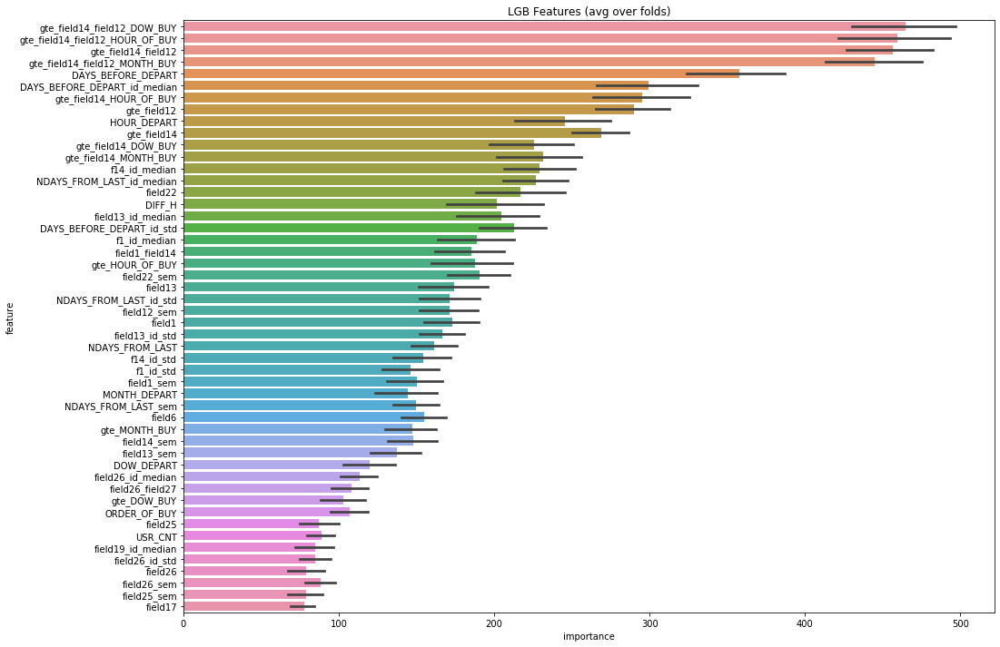

In [0]:
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197}
# 'n_estimators': 3026

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)
dr_c = ['HOUR_OF_BUY', 'DOW_BUY', 'MONTH_BUY', 'field12', 'field14']
res_dict=train_model_classification(X=Xtrain.drop(columns=dr_c, axis=1), X_test=Xtest.drop(columns=dr_c, axis=1), y=targets['goal1'], 
                                    params=optuna_params2, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=True, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=3026)

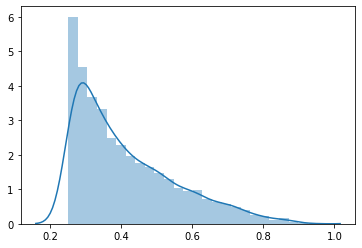

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .25]) 

In [0]:
load_submission(Xtest, res_dict['prediction'][:, 1], fname='subm1_16_gauss.csv') # overfitting

## 1.17

In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['field27']
drop_cols = ['orderid', 'userid', 'QUARTER', 'indicator_goal21', 'indicator_goal22', 'TICKET_CHILD_1Y', 'field8']#, 'field1', 'field14', 'field26', 'field27']

Xtrain, Xtest, targets = combining_ds_stratagy(scaling=RobustScaler(), cols_to_scale=to_scale, cols_to_drop=drop_cols)

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 207.38 Mb (9.5% reduction)
=====
Shape of res data
X: (196056, 68), X_test: (455011, 68), targets: (196056, 6)


Fold 1 started at Tue Jan 21 10:14:01 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[869]	training's binary_logloss: 0.0737255	training's auc: 0.934084	valid_1's binary_logloss: 0.100799	valid_1's auc: 0.701177
Fold 2 started at Tue Jan 21 10:16:46 2020
Training until validation scores don't improve for 200 rounds.
Did not meet early stopping. Best iteration is:
[1290]	training's binary_logloss: 0.0660307	training's auc: 0.961764	valid_1's binary_logloss: 0.100006	valid_1's auc: 0.706816
Fold 3 started at Tue Jan 21 10:20:14 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[846]	training's binary_logloss: 0.0738672	training's auc: 0.933802	valid_1's binary_logloss: 0.10415	valid_1's auc: 0.730866
Fold 4 started at Tue Jan 21 10:22:52 2020
Training until validation scores don't improve for 200 rounds.
Did not meet early stopping. Best iteration is:
[1290]	training's binary_logl

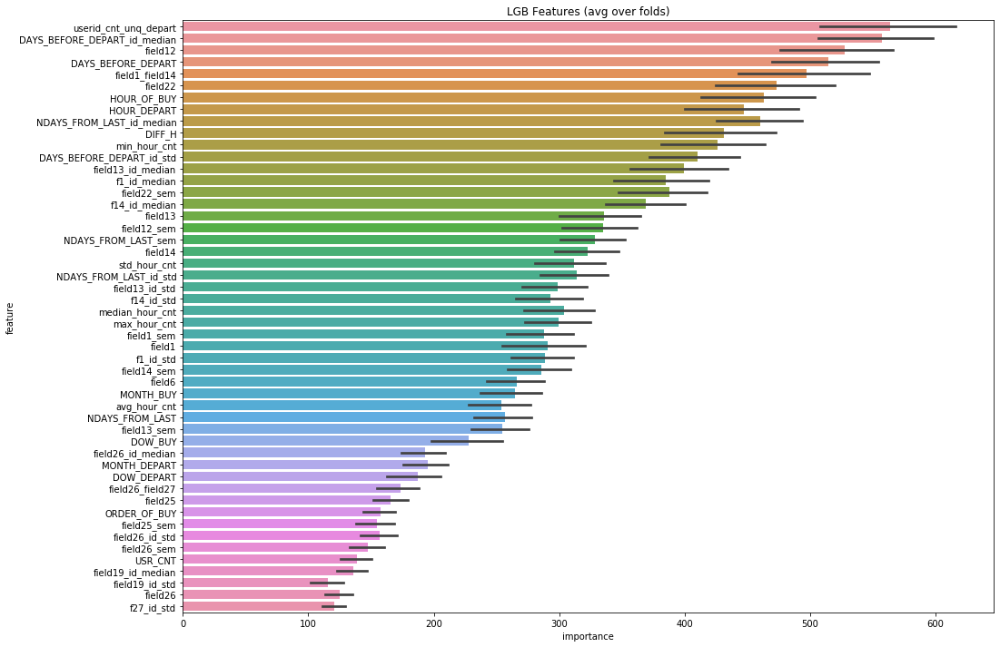

In [0]:
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197}
# 'n_estimators': 3026

optuna_params3={'lambda_l1': 2.5966415938710914, 'lambda_l2': 5.10067545067542e-07, 'num_leaves': 138, 'feature_fraction': 0.6327519551724989, 
                'bagging_fraction': 0.9562670829341834, 'bagging_freq': 18, 'min_child_samples': 22, 'min_data_in_leaf': 50, 'subsample': 0.7761130900554234, 
                'colsample_bytree': 0.7708761948784814, 'max_bin': 100, 'max_depth': 48, 'learning_rate': 0.005110606194785174}
# 'n_estimators': 1290,

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)
dr_cl = ['YEAR', 'CHILD']
res_dict=train_model_classification(X=Xtrain.drop(dr_cl, 1), X_test=Xtest.drop(dr_cl, 1), y=targets['goal1'], 
                                    params=optuna_params3, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=True, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=1290)

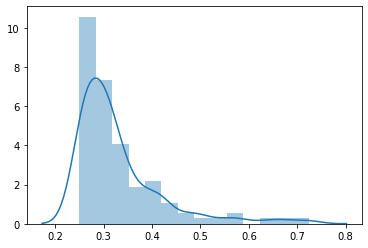

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .25]) 

In [0]:
load_submission(Xtest, res_dict['prediction'][:, 1], fname='subm1_17.csv') #  0.690746 CV mean score: 0.7149, std: 0.0107

In [0]:
res_dict['feature_importance'].sort_values(by='importance').head(15)

,feature,importance,fold
19,YEAR,7.0,1
34,CHILD,8.6,6
19,YEAR,9.1,8
34,CHILD,9.2,1
19,YEAR,10.1,2
19,YEAR,10.6,6
19,YEAR,11.0,10
19,YEAR,11.0,3
34,CHILD,11.1,8
19,YEAR,11.2,9


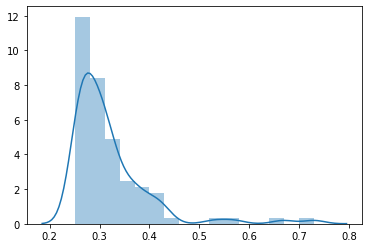

In [0]:
sns.distplot(res_dict['prediction'][:, 1][res_dict['prediction'][:, 1] > .25]) 

In [0]:
# drop YEAR CHILD / optuna_params3
load_submission(Xtest, res_dict['prediction'][:, 1], fname='subm1_17_1.csv') # 0.6866, CV mean score: 0.7142, std: 0.0097

In [0]:
def run_adversarial_validation(x_train, y_train):
    splits = list(StratifiedKFold(n_splits=5, random_state=42, shuffle=True).split(x_train, y_train))
    feature_importance = np.zeros((len(feature_names)))
    models = []

    train_preds = np.zeros((x_train.shape[0]))
    num_rounds = params['num_rounds']
    verbose_eval = params['verbose_eval']
    early_stop = params['early_stop']

    for i, (train_index, val_index) in enumerate(splits):
        dtrain = lgb.Dataset(x_train[train_index], y_train[train_index], 
                             feature_name=feature_names)
        dvalid = lgb.Dataset(x_train[val_index], y_train[val_index], 
                             feature_name=feature_names)

        model = lgb.train(params,
                          train_set=dtrain,
                          valid_sets=(dtrain, dvalid),
                          num_boost_round=num_rounds,
                          verbose_eval=verbose_eval,
                          early_stopping_rounds=early_stop)
        feature_importance += model.feature_importance() / model.feature_importance().sum()
        train_preds[val_index] = model.predict(x_train[val_index])
        models.append(model)

    print('Overall AUC: ', roc_auc_score(y_train, train_preds))
    return train_preds

In [0]:
sns.jointplot(np.arange(len(train_df)), adv_scores[:len(train_df)], size=10, stat_func=None,
              marginal_kws=dict(bins=15), joint_kws=dict(s=3))

## 1.18

In [0]:
class WeightedAveragedModels(BaseEstimator, RegressorMixin, TransformerMixin):
    def __init__(self, models, weights):
        self.models = models
        self.weights = weights
        assert sum(self.weights) == 1

    def fit(self, X, y):
        self.models_ = [clone(x) for x in self.models]

        # Train cloned base models
        for model in self.models_:
            model.fit(X, y)

        return self

    def predict_proba(self, X):
        predictions = np.column_stack([
            model.predict_proba(X)[:, 1] for model in self.models_
        ])
        return np.sum(predictions * self.weights, axis=1)


def train_model_classification_auc(X, X_test, y, folds, #eval_metric='auc', 
                               columns=None, model=None):
 
    columns = X.columns if columns == None else columns
    X_test = X_test[columns]
    
    result_dict = {}
    
    # averaged predictions on train data
    prediction = 0
    
    # list of scores on folds
    scores = []
    feature_importance = pd.DataFrame()
    
    # split and train on folds
    for fold_n, (train_index, valid_index) in enumerate(folds.split(X)):
        print(f'Fold {fold_n + 1} started at {time.ctime()}')
        if type(X) == np.ndarray:
            X_train, X_valid = X[columns][train_index], X[columns][valid_index]
            y_train, y_valid = y[train_index], y[valid_index]
        else:
            X_train, X_valid = X[columns].iloc[train_index], X[columns].iloc[valid_index]
            y_train, y_valid = y.iloc[train_index], y.iloc[valid_index]
            
        model = model
        model.fit(X_train, y_train)
            
        y_pred_valid = model.predict_proba(X_valid)
        score = metrics.roc_auc_score(y_valid, y_pred_valid)
        print(f'Fold {fold_n + 1}. auc: {score:.4f}.')
        print('')
            
        y_pred = model.predict_proba(X_test)            
        scores.append(score)
        prediction += y_pred    

    prediction /= folds.n_splits
    
    print('CV mean score: {0:.4f}, std: {1:.4f}.'.format(np.mean(scores), np.std(scores)))
    
    result_dict['prediction'] = prediction
    result_dict['scores'] = scores
        
    return result_dict

In [10]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']#+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']
drop_cols = ['orderid', 'userid', 'QUARTER', 'indicator_goal21', 'indicator_goal22']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'

Xtrain, Xtest, targets = combining_ds_stratagy(scaling=RobustScaler(), cols_to_scale=to_scale, cols_to_drop=drop_cols)

Mem. usage decreased to 16.08 Mb (74.3% reduction)
(196056, 44)
Mem. usage decreased to 34.71 Mb (72.0% reduction)
(455011, 38)
=====
Shape of combined data: (651067, 38)
Mem. usage decreased to 181.93 Mb (10.7% reduction)
colsToRemove: [] ,
=====
Shape of res data
X: (196056, 64), X_test: (455011, 64), targets: (196056, 6)


In [11]:
Xtrain[:3]

,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,indicator_goal23,indicator_goal24,indicator_goal25,INDICATOR_CNT,USR_CNT,DIFF_H,DIFF_M,f14_id_median,f1_id_median,f1_id_std,f14_id_std,f27_id_median,f27_id_std,DAYS_BEFORE_DEPART_id_median,DAYS_BEFORE_DEPART_id_std,NDAYS_FROM_LAST_id_median,NDAYS_FROM_LAST_id_std,field13_id_median,field13_id_std,field26_id_median,field26_id_std,field19_id_median,field19_id_std,field1_sem,field14_sem,field26_sem,field27_sem,field12_sem,NDAYS_FROM_LAST_sem,field13_sem,field22_sem,field25_sem,field1_field14,field26_field27,userid_cnt_unq_depart
0,0.000000,-0.626508,11,12,0.0,1,0,1,1,0,0,9,0.000000,0.695652,-0.661308,1,-0.1250,0.0,4,-0.5,1,1,-0.390244,15,1,0.0,0.00,1,0,0,1,1,0.799805,-0.333333,6,1,-0.661308,-0.626508,0.000000,0.000000,1.0,0.000000,4.0,0.000000,0.0,0.000000,20.0,0.000000,2.0,0.000000,1.0,0.000000,-1.000000,-1.000000,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,0.108434,0.846154,482
1,11.076923,-0.393794,5,7,1.0,0,0,0,1,0,0,21,17.142857,-0.043478,-0.101043,1,3.1875,0.0,5,-0.5,6,0,2.536585,15,1,40.0,0.25,1,0,0,1,0,0.600098,0.000000,6,2,-0.171076,-0.393794,0.000000,0.099042,2.0,1.414214,48.5,12.020815,72.0,101.823376,23.5,28.991378,7.5,6.363961,1.5,0.707107,0.000000,0.070033,4.5,1.0,46.0,72.0,20.5,18.5,5.5,-0.222892,1.000000,80
2,10.307692,-0.548937,2,3,1.0,0,0,1,1,0,1,7,-0.142857,-0.043478,-0.661308,1,-0.1250,0.0,2,0.5,6,0,0.000000,14,1,0.0,2.25,7,0,0,1,1,0.799805,0.000000,7,1,-0.661308,-0.587722,0.054851,0.000000,7.0,0.000000,3.5,0.707107,67.0,94.752309,4.0,1.414214,11.0,0.000000,2.0,1.414214,0.038786,0.000000,0.0,0.0,5.0,67.0,1.0,8.0,0.0,0.006024,-0.692308,114


In [12]:
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197, 'n_estimators': 500} # 3026


xgb_opt3={'max_depth': 19, 'min_child_weight': 19, 'learning_rate': 0.005, 'scale_pos_weight': 21, 'subsample': 0.6, "objective": "binary:logistic",  'n_estimators': 700, 
          'colsample_bytree': 0.6, 'lambda_l1': 0.010819818382437923, 'lambda_l2': 1.105491511289272e-06, 'num_leaves': 20, 'eval_metric': 'auc', 'seed': SEED,
          "eta": 0.1}


best_params_bayes_goal1={ 'loss_function': 'Logloss',
                          'random_seed': SEED,
                          'leaf_estimation_method': 'Newton',
                          'leaf_estimation_iterations': 10,
                          'bagging_temperature': 0.41010395885331385,
                          'border_count': 186,
                          'depth': 8,
                          'silent': True,
                          'eval_metric': 'AUC',
                          'iterations': 700,
                          'l2_leaf_reg': 21,
                          'learning_rate': 0.0673344419215237,
                          'random_strength': 3.230824361824754e-06,
                          'scale_pos_weight': 0.7421091918485163,
                          'task_type': 'GPU' 
                         }

xgb_clf = xgb.XGBClassifier(random_state=SEED, **xgb_opt3)
lgb_clf = LGBMClassifier(**optuna_params2, random_state=SEED)
cat_clf = CatBoostClassifier(**best_params_bayes_goal1)

# averaged_model1 = AveragedModels([cat_clf, lgb_clf])
weighted_avg_mod = WeightedAveragedModels([cat_clf, lgb_clf, xgb_clf], [0.3, 0.5, 0.2])

n_fold = 12
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification_auc(X=Xtrain, X_test=Xtest, y=targets['goal1'], 
                                    folds=folds, columns=None, model=weighted_avg_mod)   

Fold 1 started at Wed Jan 22 16:43:47 2020
Fold 1. auc: 0.6998.

Fold 2 started at Wed Jan 22 17:09:54 2020
Fold 2. auc: 0.7190.

Fold 3 started at Wed Jan 22 17:36:21 2020
Fold 3. auc: 0.7021.

Fold 4 started at Wed Jan 22 18:01:59 2020
Fold 4. auc: 0.7399.

Fold 5 started at Wed Jan 22 18:27:12 2020
Fold 5. auc: 0.7034.

Fold 6 started at Wed Jan 22 18:53:07 2020
Fold 6. auc: 0.6981.

Fold 7 started at Wed Jan 22 19:18:54 2020
Fold 7. auc: 0.7118.

Fold 8 started at Wed Jan 22 19:44:47 2020
Fold 8. auc: 0.7192.

Fold 9 started at Wed Jan 22 20:10:11 2020


KeyboardInterrupt: ignored

In [13]:
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197, 'n_estimators': 500} # 3026


xgb_opt3={'max_depth': 19, 'min_child_weight': 19, 'learning_rate': 0.005, 'scale_pos_weight': 21, 'subsample': 0.6, "objective": "binary:logistic",  'n_estimators': 700, 
          'colsample_bytree': 0.6, 'lambda_l1': 0.010819818382437923, 'lambda_l2': 1.105491511289272e-06, 'num_leaves': 20, 'eval_metric': 'auc', 'seed': SEED,
          "eta": 0.1}


best_params_bayes_goal1={ 'loss_function': 'Logloss',
                          'random_seed': SEED,
                          'leaf_estimation_method': 'Newton',
                          'leaf_estimation_iterations': 10,
                          'bagging_temperature': 0.41010395885331385,
                          'border_count': 186,
                          'depth': 8,
                          'silent': True,
                          'eval_metric': 'AUC',
                          'iterations': 700,
                          'l2_leaf_reg': 21,
                          'learning_rate': 0.0673344419215237,
                          'random_strength': 3.230824361824754e-06,
                          'scale_pos_weight': 0.7421091918485163,
                          'task_type': 'GPU' 
                         }

xgb_clf = xgb.XGBClassifier(random_state=SEED, **xgb_opt3)
lgb_clf = LGBMClassifier(**optuna_params2, random_state=SEED)
cat_clf = CatBoostClassifier(**best_params_bayes_goal1)

weighted_avg_mod = WeightedAveragedModels([cat_clf, lgb_clf, xgb_clf], [0.3, 0.5, 0.2])

n_fold = 2
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification_auc(X=Xtrain, X_test=Xtest, y=targets['goal1'], 
                                    folds=folds, columns=None, model=weighted_avg_mod)   

Fold 1 started at Wed Jan 22 20:16:16 2020
Fold 1. auc: 0.7007.

Fold 2 started at Wed Jan 22 20:29:16 2020
Fold 2. auc: 0.6969.

CV mean score: 0.6988, std: 0.0019.


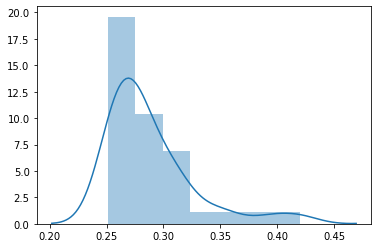

In [14]:
sns.distplot(res_dict['prediction'][res_dict['prediction']>.25])

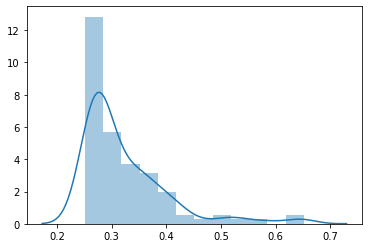

In [65]:
sns.distplot(res_dict['prediction'][res_dict['prediction']>.25])

In [0]:
# load_submission(Xtest, res_dict['prediction'], fname='subm1_18.csv') # 0.690961 wa 65/35

In [0]:
load_submission(Xtest, res_dict['prediction'], fname='subm1_18_2.csv')

# MVM assessment

In [0]:
# from sklearn.feature_extraction import FeatureHasher
# fh = FeatureHasher(n_features=12, input_type='string')
# hashed_features = fh.fit_transform(df['HOUR_DEPART'].astype('str'))

hashed_features = hashed_features.toarray()
df_fh = pd.concat([df.drop(columns='HOUR_DEPART', axis=1), pd.DataFrame(hashed_features)], 
           axis=1)

In [0]:
bin_cols = ['field10', 'field8', 'field7', 'field5']
to_hash_cols= df.filter(regex='MONTH|HOUR|DOW').columns.tolist()

# transfer object columns as category cols
for col in bin_cols+to_hash_cols+indicator_cols:
    df_t[col] =  df_t[col].astype('category').cat.codes

In [0]:
drop_addition_cols = ['HOUR_OF_BUY', "DOW_BUY", 'MONTH_BUY']
drop_cols = ['orderid', 'userid', 'goal1']#, 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'
# target = 'goal1'
X, X_test, Y, Y_test = train_test_split(df_.drop(drop_cols+goals_cols, axis=1), 
                                        df_['goal1'],#df[target], 
                                        stratify=df_['goal1'], random_state=SEED)

X.shape

(147042, 49)

Fold 1 started at Mon Jan 20 22:18:00 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1635]	training's binary_logloss: 0.0561635	training's auc: 0.967458	valid_1's binary_logloss: 0.0799864	valid_1's auc: 0.849485
Fold 2 started at Mon Jan 20 22:19:46 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1326]	training's binary_logloss: 0.0597907	training's auc: 0.956742	valid_1's binary_logloss: 0.0792172	valid_1's auc: 0.854528
Fold 3 started at Mon Jan 20 22:21:17 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[1687]	training's binary_logloss: 0.0567282	training's auc: 0.967796	valid_1's binary_logloss: 0.0773904	valid_1's auc: 0.858352
CV mean score: 0.8541, std: 0.0036.


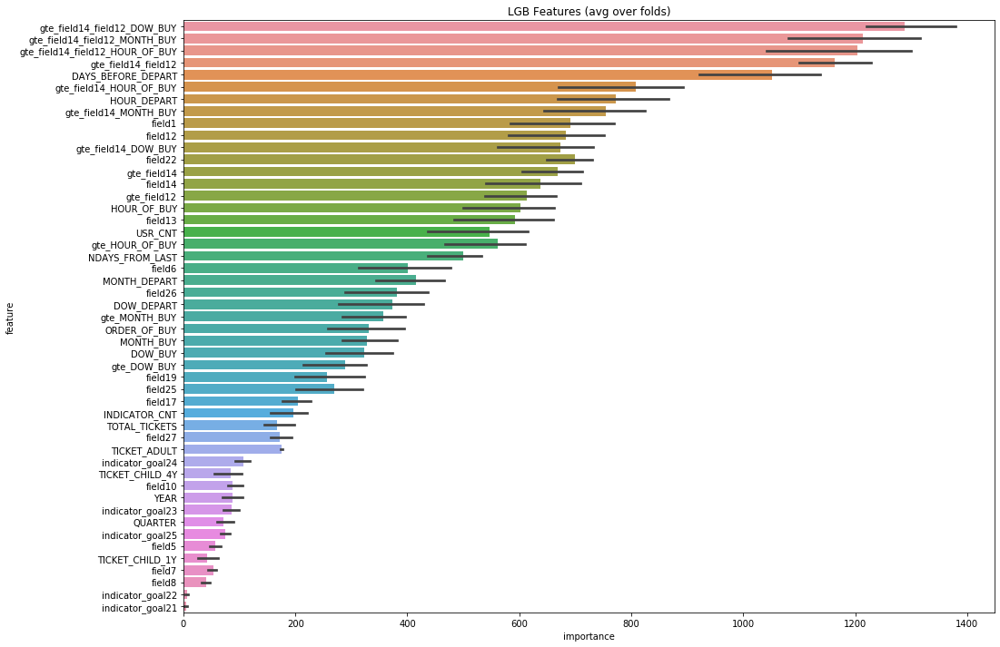

In [0]:
params_cb = {
              # 'iterations': 500,
              'loss_function': 'Logloss', # CrossEntropy
              'learning_rate': 0.03,
              # 'eval_metric': 'AUC',
              'random_seed': 17,
              'logging_level': 'Silent',
              'l2_leaf_reg': 3,
              'bagging_temperature': 1,
              'random_strength': 1,
              'one_hot_max_size': 24,
              'leaf_estimation_method': 'Newton',
              'leaf_estimation_iterations': 10,
              'od_type': 'Iter',
              'od_wait': 20
              # 'use_best_model': False
          }

optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'learning_rate': 0.00513085764995197}
# 'n_estimators': 3026

params_ = {'boosting': 'gbdt',
          'objective':'binary',
          'metric': 'auc',
          'learning_rate': 0.01, # 0.003! #0.005 #0.006 
          'num_leaves': 110, #110 #100 #150 large, but over-fitting
          'max_bin': 66,  #60 #50 # large,but slower,over-fitting
          'max_depth': 10, # deal with over-fitting
          'min_data_in_leaf': 30, # deal with over-fitting
          'min_child_samples': 20,
          'feature_fraction': 0.5,#0.5 #0.6 #0.8
          'bagging_fraction': 0.8,
          'bagging_freq': 40,#5  
          'bagging_seed': 11,
          'lambda_l1': 2,#1.3! #5 #1.2 #1
          'lambda_l2': 0.1,
           'random_state': SEED
         }

optuna_pruned_params = {'lambda_l1': 9.889347471367316,
                        'lambda_l2': 3.2972023700344945e-05,
                        'num_leaves': 96,
                        'feature_fraction': 0.5663772943896699,
                        'bagging_fraction': 0.924269454602876,
                        'bagging_freq': 2,
                        'min_child_samples': 5,
                        'random_state': SEED}

optuna = {'lambda_l1': 7.680746936590101e-07,
            'lambda_l2': 9.486088582087339,
            'num_leaves': 49,
            'feature_fraction': 0.522309137674335,
            'bagging_fraction': 0.8492499256126049,
            'bagging_freq': 1,
            'min_child_samples': 19}

# X_train, X_test, y_train, y_test 0.6881, std: 0.0119

n_fold = 3
folds = KFold(n_splits=n_fold, shuffle=True, random_state=SEED)

res_dict=train_model_classification(X=X, X_test=X_test, y=Y, params=optuna_params2, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=True, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=3026)

# default 0.6902, std: 0.0038

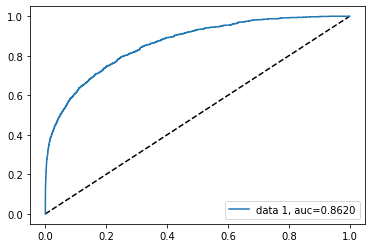

In [0]:
plot_roc(Y_test, res_dict['prediction'][:, 1])

In [0]:
drop6=res_dict['feature_importance'].groupby('feature')['importance'].sum().reset_index().sort_values(by='importance', ascending=0).tail(6).feature.tolist()

In [0]:
up9 = res_dict['feature_importance'].groupby('feature')['importance'].sum().reset_index().query('importance>9').feature.tolist()

In [0]:
table.query("feature=='DBD_f12_logmedian'") #df.DBD_f12_logmedian

fold,feature,1,2,3,4,5
4,DBD_f12_logmedian,51.4,39.8,35.4,44.4,26.8


In [0]:
table = res_dict['feature_importance'].pivot_table(index='feature', columns='fold', values='importance').reset_index()\
        .sort_values(by=[1], ascending=0)

In [0]:
table.loc[table.feature.str.contains('logmedian|logstd|logmean|logsem|logvar'), :]

fold,feature,1,2,3,4,5
9,DBD_f1_logstd,253.0,206.6,243.4,220.6,129.0
7,DBD_f12_logvar,237.2,217.6,222.0,205.4,144.0
36,f14_f17_logvar,202.6,179.0,183.8,164.2,119.4
12,DBD_f22_logstd,192.2,170.4,168.8,178.8,103.4
5,DBD_f12_logmean,183.2,147.8,180.0,164.4,101.2
40,f1_f17_logmean,181.2,159.8,151.2,142.2,91.0
6,DBD_f12_logsem,163.6,130.4,153.6,131.4,86.0
41,f1_f17_logsem,161.8,133.8,169.6,143.2,88.8
44,f25_f26_logsem,149.0,115.4,124.0,131.4,92.4
10,DBD_f22_logmean,146.4,123.2,148.6,149.0,93.4


In [0]:
drop_logfeat = table.loc[table.feature.str.contains('logmedian|logstd|logmean|logsem|logvar'), :].tail(12).feature.tolist()

In [0]:
drop_logfeat

['f14_f17_logvar',
 'DBD_f22_logstd',
 'DBD_f12_logmean',
 'f1_f17_logmean',
 'DBD_f12_logsem',
 'f1_f17_logsem',
 'f25_f26_logsem',
 'DBD_f22_logmean',
 'DBD_HOB_logsem',
 'f17_f19_logsem',
 'DBD_f22_logmedian',
 'DBD_f1_logmedian']

In [0]:
res_dict['feature_importance'].pivot_table(index='feature', columns='fold', values='importance').reset_index()\
        .sort_values(by=[1], ascending=0)

fold,feature,1,2,3,4,5
18,HOUR_OF_BUY,362.4,292.6,343.0,329.0,191.4
51,field12,355.4,324.4,349.4,344.6,246.0
13,DIFF_H,324.6,250.6,276.8,278.2,170.4
2,DAYS_BEFORE_DEPART_id_median,318.2,297.4,296.2,288.6,196.8
17,HOUR_DEPART,299.8,285.2,282.6,291.6,191.0
...,...,...,...,...,...,...
76,field5,11.6,7.4,12.0,4.0,10.6
84,indicator_goal25,11.6,13.8,14.0,15.4,9.6
79,field8,9.6,8.4,7.2,4.2,3.2
81,indicator_goal22,5.2,4.6,10.4,11.6,2.0


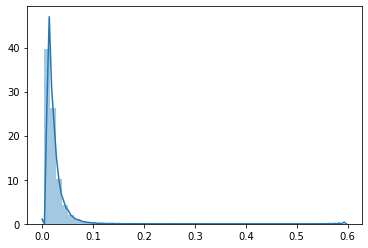

In [0]:
sns.distplot(res_dict['prediction'][:, 1])

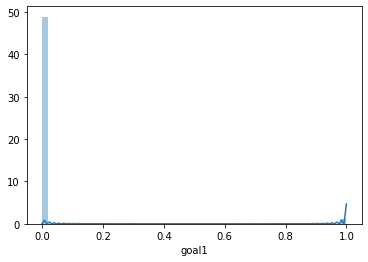

In [0]:
sns.distplot(Y_test)

## Optuna

In [0]:
import optuna

In [0]:
def lb_opt(X_train_all,Y_train_all,trial):
  
    (X_train,X_test,y_train,y_test) = train_test_split(X_train_all,Y_train_all,test_size=0.2,random_state=0)
    #paramter_tuning using optuna
    bagging_freq =  trial.suggest_int('bagging_freq',1,10),
    min_data_in_leaf =  trial.suggest_int('min_data_in_leaf',2,100),
    max_depth = trial.suggest_int('max_depth',1,20),
    learning_rate = trial.suggest_loguniform('learning_rate',0.001,0.1),
    num_leaves = trial.suggest_int('num_leaves',2,70),
    num_threads = trial.suggest_int('num_threads',1,10),
    min_sum_hessian_in_leaf = trial.suggest_int('min_sum_hessian_in_leaf',1,10),
    
    lightgbm_tuna = LGBMClassifier(
        random_state = 0,
        verbosity = 1,
        bagging_seed = 0,
        boost_from_average = 'true',
        boost = 'gbdt',
        metric = 'auc',
        bagging_freq = bagging_freq ,
        min_data_in_leaf = min_data_in_leaf,
        max_depth = max_depth,
        learning_rate = learning_rate,
        num_leaves = num_leaves,
        num_threads = num_threads,
        min_sum_hessian_in_leaf = min_sum_hessian_in_leaf
    )
    
    lightgbm_tuna.fit(X_train,y_train)
    lb_predict_test = lightgbm_tuna.predict_proba(X_test)[:, 1]
    
    return (accuracy_score(y_test,lb_predict_test))

In [0]:
def objective(trial):
         
         dtrain = lgb.Dataset(X, label=Y)
    
         param = {
             'random_state': SEED,
             'bagging_seed': SEED,
            #  'boost_from_average': 'true',
             'objective': 'binary',
             'metric': 'binary_logloss',
             'metric': 'auc',
             'verbosity': -1,
             'boosting_type': 'gbdt',
             'lambda_l1': trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
             'lambda_l2': trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
             'num_leaves': trial.suggest_int('num_leaves', 2, 256),
             'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0),
             'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0),
             'bagging_freq': trial.suggest_int('bagging_freq', 1, 40),
             'min_child_samples': trial.suggest_int('min_child_samples', 5, 300),
             'min_data_in_leaf': trial.suggest_int('min_data_in_leaf',2,150),

            #  'min_child_weight': [0, 1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
             'subsample': trial.suggest_uniform('subsample', 2e-1, 0.9),
             'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.4, 0.8),
             'max_bin': trial.suggest_int('max_bin', 6, 150),
             'max_depth': trial.suggest_int('max_depth', 6, 100),
             'n_estimators': trial.suggest_int('n_estimators', 500, 4000),
            #  'reg_alpha': [0, 1e-1, 1, 2, 3, 5, 7, 10, 15],
            #  'reg_lambda': [0, 1e-1, 7, 16, 18, 20, 22, 25],
             'learning_rate': trial.suggest_loguniform('learning_rate', 0.001, 0.5)

         }
    
         gbm = lgb.train(param, dtrain)
         preds = gbm.predict(X_test)
         score = roc_auc_score(Y_test, preds)
         return score

In [0]:
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

[I 2020-01-17 13:07:13,490] Finished trial#0 resulted in value: 0.7089240200053978. Current best value is 0.7089240200053978 with parameters: {'lambda_l1': 0.05321927206867505, 'lambda_l2': 3.800964717020127e-08, 'num_leaves': 207, 'feature_fraction': 0.9924018963701037, 'bagging_fraction': 0.7459368434650839, 'bagging_freq': 4, 'min_child_samples': 268, 'min_data_in_leaf': 103, 'subsample': 0.5478073910733947, 'colsample_bytree': 0.5616985284498752, 'max_bin': 24, 'max_depth': 54, 'n_estimators': 2622, 'learning_rate': 0.0014366123562674672}.
[I 2020-01-17 13:10:51,719] Finished trial#1 resulted in value: 0.6823011149460421. Current best value is 0.7089240200053978 with parameters: {'lambda_l1': 0.05321927206867505, 'lambda_l2': 3.800964717020127e-08, 'num_leaves': 207, 'feature_fraction': 0.9924018963701037, 'bagging_fraction': 0.7459368434650839, 'bagging_freq': 4, 'min_child_samples': 268, 'min_data_in_leaf': 103, 'subsample': 0.5478073910733947, 'colsample_bytree': 0.5616985284498

In [0]:
print('Best trial:')
trial = study.best_trial
print('  Value: {}'.format(trial.value))
print('  Params: ')
for key, value in trial.params.items():
    print('{}: {}'.format(key, value))


# 0.7175389134061876 with parameters: 
optuna_params1={'lambda_l1': 0.003364025017219649, 'lambda_l2': 2.1345260224486916e-08, 'num_leaves': 99, 'feature_fraction': 0.4198598196260131, 
                'bagging_fraction': 0.879646762474719, 'bagging_freq': 30, 'min_child_samples': 9, 'min_data_in_leaf': 51, 'subsample': 0.8501345828031215, 
                'colsample_bytree': 0.5849497893806658, 'max_bin': 67, 'max_depth': 53, 'n_estimators': 3080, 'learning_rate': 0.0029113451999001772}

# 0.7166661362481928 with parameters: 
optuna_params2={'lambda_l1': 0.017402037221412994, 'lambda_l2': 2.3976644560912648e-08, 'num_leaves': 42, 'feature_fraction': 0.4736947025928965, 
                'bagging_fraction': 0.887508071542447, 'bagging_freq': 24, 'min_child_samples': 31, 'min_data_in_leaf': 78, 'subsample': 0.7436949778585085, 
                'colsample_bytree': 0.5855017588438286, 'max_bin': 47, 'max_depth': 57, 'n_estimators': 3026, 'learning_rate': 0.00513085764995197}

# 0.7157360354356719 with parameters: 
optuna_params3={'lambda_l1': 2.5966415938710914, 'lambda_l2': 5.10067545067542e-07, 'num_leaves': 138, 'feature_fraction': 0.6327519551724989, 
                'bagging_fraction': 0.9562670829341834, 'bagging_freq': 18, 'min_child_samples': 22, 'min_data_in_leaf': 50, 'subsample': 0.7761130900554234, 
                'colsample_bytree': 0.7708761948784814, 'max_bin': 100, 'max_depth': 48, 'learning_rate': 0.005110606194785174}
# 'n_estimators': 1290,




# Best trial:
#   Value: 0.7125181227647308
#   Params: 
# lambda_l1: 7.680746936590101e-07
# lambda_l2: 9.486088582087339
# num_leaves: 49
# feature_fraction: 0.522309137674335
# bagging_fraction: 0.8492499256126049
# bagging_freq: 1
# min_child_samples: 19

# Best trial:
#   Value: 0.7115773879431682
#   Params: 
# lambda_l1: 0.0001798220955116104
# lambda_l2: 5.532222436036138
# num_leaves: 52
# feature_fraction: 0.6326143725733246
# bagging_fraction: 0.9313205154201761
# bagging_freq: 3
# min_child_samples: 22

Best trial:
  Value: 0.7115773879431682
  Params: 
lambda_l1: 0.0001798220955116104
lambda_l2: 5.532222436036138
num_leaves: 52
feature_fraction: 0.6326143725733246
bagging_fraction: 0.9313205154201761
bagging_freq: 3
min_child_samples: 22


In [0]:
from optuna.visualization import plot_optimization_history
plot_optimization_history(study)

In [0]:
# Pruning

def objective_pruning(trial):
         
         dtrain = lgb.Dataset(X, label=Y)
         dtest = lgb.Dataset(X_test, label=Y_test)
    
         param = {
             'random_state': SEED,
             'objective': 'binary',
             'metric': 'binary_logloss',
             'metric': 'auc',
             'verbosity': -1,
             'boosting_type': 'gbdt',
             'lambda_l1': trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
             'lambda_l2': trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
             'num_leaves': trial.suggest_int('num_leaves', 2, 256),
             'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0),
             'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0),
             'bagging_freq': trial.suggest_int('bagging_freq', 1, 7),
             'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
         }
    
         # Add a callback for pruning.
         pruning_callback = optuna.integration.LightGBMPruningCallback(trial, 'auc')
         gbm = lgb.train(
             param, dtrain, valid_sets=[dtest], verbose_eval=False, callbacks=[pruning_callback])
    
         preds = gbm.predict(X_test)
         score = roc_auc_score(Y_test, preds)
         return score

In [0]:
# optuna.logging.set_verbosity(optuna.logging.WARNING)
study = optuna.create_study(pruner=optuna.pruners.MedianPruner(n_warmup_steps=10), direction='maximize')

In [0]:
study.optimize(objective_pruning, n_trials=100)
trial = study.best_trial

[I 2020-01-12 15:50:25,491] Finished trial#0 resulted in value: 0.7010871976242123. Current best value is 0.7010871976242123 with parameters: {'lambda_l1': 0.0003223434996279435, 'lambda_l2': 0.0002853406990753759, 'num_leaves': 18, 'feature_fraction': 0.9442080413765312, 'bagging_fraction': 0.7983287237426059, 'bagging_freq': 4, 'min_child_samples': 28}.
[I 2020-01-12 15:50:39,802] Finished trial#1 resulted in value: 0.6815445811599397. Current best value is 0.7010871976242123 with parameters: {'lambda_l1': 0.0003223434996279435, 'lambda_l2': 0.0002853406990753759, 'num_leaves': 18, 'feature_fraction': 0.9442080413765312, 'bagging_fraction': 0.7983287237426059, 'bagging_freq': 4, 'min_child_samples': 28}.
[I 2020-01-12 15:50:55,893] Finished trial#2 resulted in value: 0.6689063594739262. Current best value is 0.7010871976242123 with parameters: {'lambda_l1': 0.0003223434996279435, 'lambda_l2': 0.0002853406990753759, 'num_leaves': 18, 'feature_fraction': 0.9442080413765312, 'bagging_fr

In [0]:
print('Value: {}'.format(trial.value))
print('Params: ')
for key, value in trial.params.items():
    print('{}: {}'.format(key, value))

# Value: 0.7096018852001997
# Params: 
# lambda_l1: 4.217638832523044
# lambda_l2: 2.2542161944536233e-08
# num_leaves: 86
# feature_fraction: 0.4236673876879125
# bagging_fraction: 0.8779514889324209
# bagging_freq: 4
# min_child_samples: 64


# Value: 0.7069817845963206
# Params: 
# lambda_l1: 9.889347471367316
# lambda_l2: 3.2972023700344945e-05
# num_leaves: 96
# feature_fraction: 0.5663772943896699
# bagging_fraction: 0.924269454602876
# bagging_freq: 2
# min_child_samples: 5

Value: 0.7069817845963206
Params: 
lambda_l1: 9.889347471367316
lambda_l2: 3.2972023700344945e-05
num_leaves: 96
feature_fraction: 0.5663772943896699
bagging_fraction: 0.924269454602876
bagging_freq: 2
min_child_samples: 5


In [0]:
plot_optimization_history(study)

In [0]:
from optuna.visualization import plot_intermediate_values
plot_intermediate_values(study)

## lgb HP optimization

In [0]:
def learning_rate_010_decay_power_099(current_iter):
    base_learning_rate = 0.1
    lr = base_learning_rate  * np.power(.99, current_iter)
    return lr if lr > 1e-3 else 1e-3

def learning_rate_010_decay_power_0995(current_iter):
    base_learning_rate = 0.1
    lr = base_learning_rate  * np.power(.995, current_iter)
    return lr if lr > 1e-3 else 1e-3

def learning_rate_005_decay_power_099(current_iter):
    base_learning_rate = 0.05
    lr = base_learning_rate  * np.power(.99, current_iter)
    return lr if lr > 1e-3 else 1e-3

In [0]:
fit_params={"early_stopping_rounds": 200, 
            "eval_metric" : 'auc', 
            "eval_set" : [(X_test, Y_test)],
            'eval_names': ['valid'],
            'callbacks': [lgb.reset_parameter(learning_rate=learning_rate_010_decay_power_099)],
            'verbose': 100,
            'categorical_feature': 'auto'}

params_ = {'boosting': 'gbdt',
          'objective':'binary',
          'metric': 'auc',
          'learning_rate': 0.01, # 0.003! #0.005 #0.006 
          # 'num_leaves': 110, #110 #100 #150 large, but over-fitting
          'max_bin': 66,  #60 #50 # large,but slower,over-fitting
          'max_depth': 10, # deal with over-fitting
          'min_data_in_leaf': 30, # deal with over-fitting
          # 'min_child_samples': 20,
          'feature_fraction': 0.5,#0.5 #0.6 #0.8
          'bagging_fraction': 0.8,
          'bagging_freq': 40,#5  
          'bagging_seed': 11,
          'lambda_l1': 2,#1.3! #5 #1.2 #1
          'lambda_l2': 0.1,
           'random_state': SEED
         }


In [0]:
from scipy.stats import randint as sp_randint
from scipy.stats import uniform as sp_uniform

param_test ={'num_leaves': sp_randint(4, 100), # 6, 50
             'min_child_samples': sp_randint(10, 300), # 100, 500
             'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
             'subsample': sp_uniform(loc=0.2, scale=0.8), 
             'colsample_bytree': sp_uniform(loc=0.4, scale=0.6),
             'reg_alpha': [0, 1e-1, 1, 2, 3, 5, 7, 10, 15],
             'reg_lambda': [0, 1e-1, 7, 16, 18, 20, 22, 25],

             'max_bin': sp_randint(20, 90),  #60 #50 # large,but slower,over-fitting
            'max_depth': sp_randint(6, 30), # deal with over-fitting
            'min_data_in_leaf': sp_randint(10, 50), # deal with over-fitting
            'feature_fraction': sp_uniform(loc=0.4, scale=0.8),#0.5 #0.6 #0.8
            'bagging_fraction': sp_uniform(loc=0.4, scale=0.9),
            'bagging_freq': sp_randint(15, 40),#5  
            'lambda_l1': sp_uniform(loc=.5, scale=2.5),#1.3! #5 #1.2 #1
            'lambda_l2': sp_uniform(loc=0.1, scale=1.5),
            'n_estimators': sp_randint(700, 4000),
            'learning_rate': [0.01, 0.003, 0.005, 0.006]
            }

In [0]:
#This parameter defines the number of HP points to be tested
n_HP_points_to_test = 100

from sklearn.model_selection import RandomizedSearchCV, GridSearchCV

#n_estimators is set to a "large value". The actual number of trees build will depend on early stopping and 5000 define only the absolute maximum
clf = LGBMClassifier(random_state=SEED, silent=True, metric='None', n_jobs=4) # n_estimators=5000, max_depth=-1
gs = RandomizedSearchCV(
    estimator=clf, param_distributions=param_test, 
    n_iter=n_HP_points_to_test,
    scoring='roc_auc',
    cv=5,
    refit=True,
    random_state=SEED,
    verbose=True)

In [0]:
# Run this cell, to do HP optimisation.

gs.fit(X, Y, **fit_params)
print('Best score reached: {} with params: {} '.format(gs.best_score_, gs.best_params_))

Fitting 5 folds for each of 100 candidates, totalling 500 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Training until validation scores don't improve for 200 rounds.
[100]	valid's auc: 0.5
[200]	valid's auc: 0.5
Early stopping, best iteration is:
[1]	valid's auc: 0.5
Training until validation scores don't improve for 200 rounds.
[100]	valid's auc: 0.5
[200]	valid's auc: 0.5
Early stopping, best iteration is:
[1]	valid's auc: 0.5
Training until validation scores don't improve for 200 rounds.
[100]	valid's auc: 0.5
[200]	valid's auc: 0.5
Early stopping, best iteration is:
[1]	valid's auc: 0.5
Training until validation scores don't improve for 200 rounds.
[100]	valid's auc: 0.5
[200]	valid's auc: 0.5
Early stopping, best iteration is:
[1]	valid's auc: 0.5
Training until validation scores don't improve for 200 rounds.
[100]	valid's auc: 0.5
[200]	valid's auc: 0.5
Early stopping, best iteration is:
[1]	valid's auc: 0.5
Training until validation scores don't improve for 200 rounds.
[100]	valid's auc: 0.5
[200]	valid's auc: 0.5
Early stopping, best iteration is:
[1]	valid's auc: 0.5
Training u

In [0]:
X

In [0]:
# opt_parameters={'colsample_bytree': 0.48263575356020577, 'min_child_samples': 311, 'min_child_weight': 1, 'num_leaves': 7, 
#                 'reg_alpha': 7, 'reg_lambda': 0.1, 'subsample': 0.3542761367404292} 

opt_parameters={'bagging_fraction': 0.8743847840486958, 'bagging_freq': 33, 'colsample_bytree': 0.6885590840224551, 
                                                                    'feature_fraction': 0.5999345400164748, 'lambda_l1': 2.549820828420092, 'lambda_l2': 0.7316289764010456, 
                                                                    'max_bin': 58, 'max_depth': 27, 'min_child_samples': 190, 
                                                                    'min_child_weight': 0.1, 'min_data_in_leaf': 30, 'num_leaves': 27, 'reg_alpha': 2, 
                                                                    'reg_lambda': 20, 'subsample': 0.7376301706635486}
#Best score reached: 0.7009810167802628  'n_estimators': 1771 



# {'bagging_fraction': 0.8642042863373147, 'bagging_freq': 28, 'colsample_bytree': 0.8124590464397792, 'feature_fraction': 0.42957531805203053, 
#                 'lambda_l1': 2.720426414889643, 'lambda_l2': 0.3828763120496974, 'max_bin': 44, 'max_depth': 21, 'min_child_samples': 127, 'min_child_weight': 1, 
#                           'min_data_in_leaf': 35, 'num_leaves': 40, 'reg_alpha': 50, 'reg_lambda': 0, 'subsample': 0.5593600329953592} # Best score: 0.6991798690784672
# 'n_estimators': 3894,




# {'bagging_fraction': 0.8151869462552659, 'bagging_freq': 7, 'colsample_bytree': 0.5667093470404444, 'feature_fraction': 0.9469788490356926, 
#                 'lambda_l1': 0.7442521382537046, 'lambda_l2': 1.2076423724590677, 'max_bin': 30, 'max_depth': 8, 'min_child_samples': 18, 
#                 'min_child_weight': 1, 'min_data_in_leaf': 10, 'num_leaves': 22, 'reg_alpha': 0, 'reg_lambda': 0.1, 'subsample': 0.37815938527585174} 

In [0]:
# Tune the weights of unbalanced classes

clf_sw = LGBMClassifier(**clf.get_params())
#set optimal parameters
clf_sw.set_params(**opt_parameters)

LGBMClassifier(boosting_type='gbdt', class_weight=None,
               colsample_bytree=0.48263575356020577, importance_type='split',
               learning_rate=0.1, max_depth=-1, metric='None',
               min_child_samples=311, min_child_weight=1, min_split_gain=0.0,
               n_estimators=5000, n_jobs=4, num_leaves=7, objective=None,
               random_state=314, reg_alpha=7, reg_lambda=0.1, silent=True,
               subsample=0.3542761367404292, subsample_for_bin=200000,
               subsample_freq=0)

In [0]:
gs_sample_weight = GridSearchCV(estimator=clf_sw, 
                                param_grid={'scale_pos_weight':[1,2,6,12]},
                                scoring='roc_auc',
                                cv=5,
                                refit=True,
                                return_train_score=True,
                                n_jobs=-1,
                                verbose=True)

In [0]:
gs_sample_weight.fit(X, Y, **fit_params)
print('Best score reached: {} with params: {} '.format(gs_sample_weight.best_score_, gs_sample_weight.best_params_))

Fitting 5 folds for each of 4 candidates, totalling 20 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:  2.7min finished


Training until validation scores don't improve for 30 rounds.
[100]	valid's auc: 0.704309
[200]	valid's auc: 0.708467
Early stopping, best iteration is:
[243]	valid's auc: 0.710297
Best score reached: 0.6985491481621485 with params: {'scale_pos_weight': 1} 


In [0]:
gs_sample_weight.fit(X, Y, **fit_params)
print('Best score reached: {} with params: {} '.format(gs_sample_weight.best_score_, gs_sample_weight.best_params_))

Fitting 5 folds for each of 4 candidates, totalling 20 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Training until validation scores don't improve for 30 rounds.
[100]	valid's auc: 0.697681
[200]	valid's auc: 0.702519
Early stopping, best iteration is:
[196]	valid's auc: 0.702785
Training until validation scores don't improve for 30 rounds.
[100]	valid's auc: 0.697986
[200]	valid's auc: 0.704069
Early stopping, best iteration is:
[222]	valid's auc: 0.704874
Training until validation scores don't improve for 30 rounds.
[100]	valid's auc: 0.696739
[200]	valid's auc: 0.700087
[300]	valid's auc: 0.703366
Early stopping, best iteration is:
[301]	valid's auc: 0.703398
Training until validation scores don't improve for 30 rounds.
[100]	valid's auc: 0.697445
[200]	valid's auc: 0.703308
Early stopping, best iteration is:
[235]	valid's auc: 0.704847
Training until validation scores don't improve for 30 rounds.
[100]	valid's auc: 0.700234
[200]	valid's auc: 0.703951
Early stopping, best iteration is:
[182]	valid's auc: 0.704282
Training until validation scores don't improve for 30 rounds.
[100]

[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:  2.5min finished


Training until validation scores don't improve for 30 rounds.
[100]	valid's auc: 0.704309
[200]	valid's auc: 0.708467
Early stopping, best iteration is:
[243]	valid's auc: 0.710297
Best score reached: 0.6985491481621485 with params: {'scale_pos_weight': 1} 


In [0]:
print("Valid+-Std     Train  :   Parameters")
for i in np.argsort(gs_sample_weight.cv_results_['mean_test_score'])[-5:]:
    print('{1:.3f}+-{3:.3f}     {2:.3f}   :  {0}'.format(gs_sample_weight.cv_results_['params'][i], 
                                    gs_sample_weight.cv_results_['mean_test_score'][i], 
                                    gs_sample_weight.cv_results_['mean_train_score'][i],
                                    gs_sample_weight.cv_results_['std_test_score'][i]))

Valid+-Std     Train  :   Parameters
0.696+-0.006     0.799   :  {'scale_pos_weight': 12}
0.698+-0.005     0.779   :  {'scale_pos_weight': 2}
0.698+-0.005     0.782   :  {'scale_pos_weight': 6}
0.699+-0.005     0.767   :  {'scale_pos_weight': 1}


In [0]:
#Configure from the HP optimisation
#clf_final = lgb.LGBMClassifier(**gs.best_estimator_.get_params())

#Configure locally from hardcoded values
clf_final = lgb.LGBMClassifier(**clf.get_params())
#set optimal parameters
clf_final.set_params(**opt_parameters)

#Train the final model with learning rate decay
clf_final.fit(X, Y, **fit_params, callbacks=[lgb.reset_parameter(learning_rate=learning_rate_010_decay_power_0995)])

Training until validation scores don't improve for 30 rounds.
[100]	valid's auc: 0.701698
[200]	valid's auc: 0.706562
[300]	valid's auc: 0.708238
[400]	valid's auc: 0.709002
Early stopping, best iteration is:
[427]	valid's auc: 0.709152


LGBMClassifier(boosting_type='gbdt', class_weight=None,
               colsample_bytree=0.48263575356020577, importance_type='split',
               learning_rate=0.1, max_depth=-1, metric='None',
               min_child_samples=311, min_child_weight=1, min_split_gain=0.0,
               n_estimators=5000, n_jobs=4, num_leaves=7, objective=None,
               random_state=314, reg_alpha=7, reg_lambda=0.1, silent=True,
               subsample=0.3542761367404292, subsample_for_bin=200000,
               subsample_freq=0)

In [0]:
# feat_imp = pd.Series(clf_final.feature_importances_, index=X.columns)
# feat_imp.nlargest(10).plot(kind='barh', figsize=(8,10))

In [0]:
preds = clf_final.predict_proba(X_test)

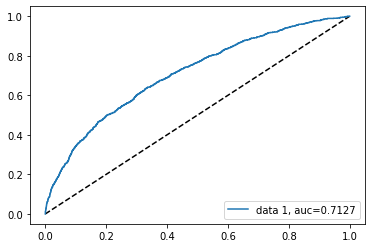

In [0]:
plot_roc(Y_test, preds[:, 1])

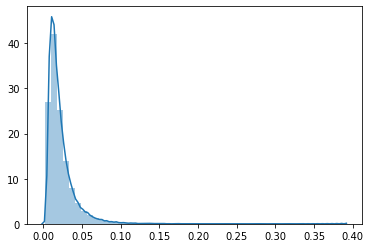

In [0]:
sns.distplot(preds[:, 1])

Fold 1 started at Thu Jan  2 20:36:50 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[72]	training's auc: 0.801968	training's auc: 0.801968	valid_1's auc: 0.668903	valid_1's auc: 0.668903
Fold 2 started at Thu Jan  2 20:37:11 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[145]	training's auc: 0.840842	training's auc: 0.840842	valid_1's auc: 0.690467	valid_1's auc: 0.690467
Fold 3 started at Thu Jan  2 20:37:37 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[143]	training's auc: 0.840879	training's auc: 0.840879	valid_1's auc: 0.694218	valid_1's auc: 0.694218
Fold 4 started at Thu Jan  2 20:38:02 2020
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[63]	training's auc: 0.793434	training's auc: 0.793434	valid_1's auc: 0.678243	valid_1's auc: 0.678243
Fold 5 started at Thu 

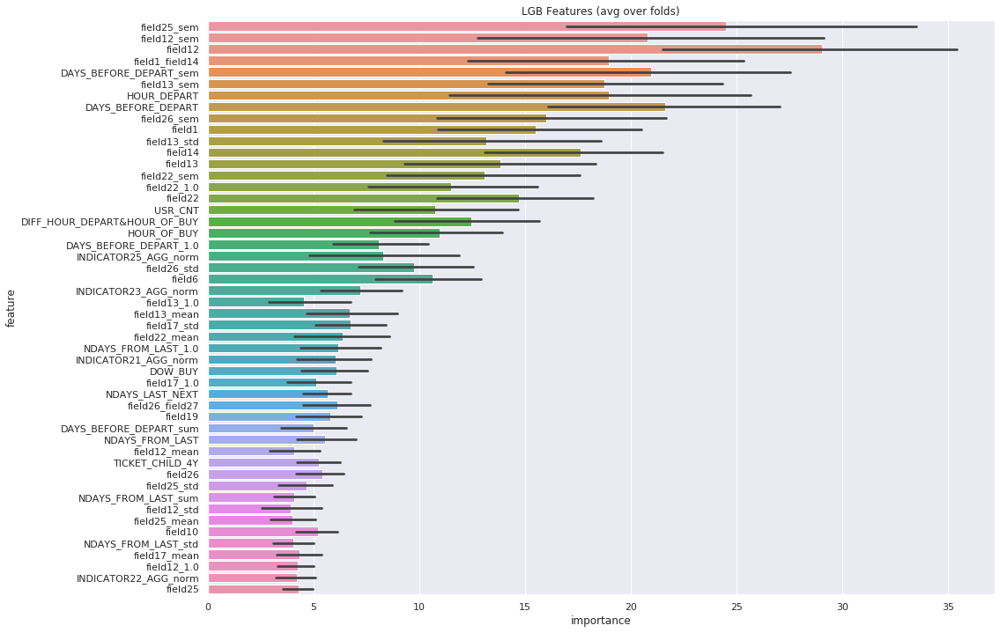

In [0]:
from sklearn import metrics
import lightgbm as lgb

params = {'boosting_type': 'gbdt',
          'max_depth' : -1,
          'objective': 'binary',
          'nthread': 3, # Updated from nthread
          'num_leaves': 64,
          'learning_rate': 0.05,
          'max_bin': 512,
          'subsample_for_bin': 200,
          'subsample': 1,
          'subsample_freq': 1,
          'colsample_bytree': 0.8,
          'reg_alpha': 5,
          'reg_lambda': 10,
          'min_split_gain': 0.5,
          'min_child_weight': 1,
          'min_child_samples': 5,
          'scale_pos_weight': 1,
          'num_class' : 1,
          'metric' : 'auc'}
n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=11)

res_dict=train_model_classification(X=X, X_test=X_test, y=Y, params=params, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=True, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=50000)

# (0.71+0.7266+0.8958+0.7927+0.9371)/5 = 0.8124

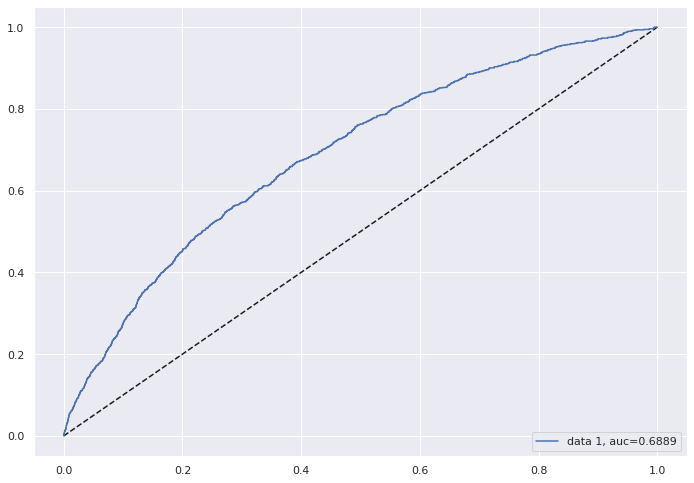

In [0]:
plot_roc(Y_test, res_dict['prediction'][:, 1])

In [0]:
eval_auc_lgb(Y_test, res_dict['prediction'][:, 1])

('auc', 0.9370560113496269, True)

In [0]:
res_dict=train_model_classification(X=X, X_test=X_test, y=Y, params=params, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=50000)


0.8124399999999999

In [0]:
df_train=df_copy.drop(['orderid', 'userid', 'goal1'], axis=1)
df_test=df_test_copy.drop(['orderid', 'userid'], axis=1)

In [0]:
n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=11)
list_goals = []

for cycle, goal in enumerate(['goal25', 'goal23', 'goal24', 'goal22', 'goal21']):

  print(f"\nstart training process... cycle =====> {cycle+1}")
 
  X = df_train.drop( np.setdiff1d(goals_cols, list_goals).tolist(), axis=1)
  Y = df_train[goal]

  used_goals = list(filter(lambda x: 'goal' in x and 'indicator' not in x, X.columns))

  print(f"use goal columns =====> {used_goals} to predict ====> {goal}\n")

  res_dict=train_model_classification(X=X, X_test=df_test, y=Y, params=params, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=50000)

  list_goals.append(goal)

  df_test[goal] = res_dict['prediction'][:, 1]

  test_goals = list(filter(lambda x: 'goal' in x and 'indicator' not in x, df_test.columns))
  print(f"\ntest set contains: {test_goals}")

  if cycle == 4:
    probas = pd.concat([df_test['goal21'], df_test['goal22'], df_test['goal23'], 
                        df_test['goal24'], df_test['goal25']], axis=1)
    
    colab_path = '/content/drive/My Drive/'
    
    probas.to_csv( os.path.join(colab_path,'sub2.csv') )
    print("process completed successfully!")


start training process... cycle =====> 1
use goal columns =====> [] to predict ====> goal25

Fold 1 started at Sat Dec 28 21:00:02 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[165]	training's auc: 0.950523	training's auc: 0.950523	valid_1's auc: 0.941281	valid_1's auc: 0.941281
Fold 2 started at Sat Dec 28 21:00:28 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[184]	training's auc: 0.951493	training's auc: 0.951493	valid_1's auc: 0.931112	valid_1's auc: 0.931112
Fold 3 started at Sat Dec 28 21:00:56 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[184]	training's auc: 0.95091	training's auc: 0.95091	valid_1's auc: 0.945587	valid_1's auc: 0.945587
Fold 4 started at Sat Dec 28 21:01:24 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[153]	training's auc: 0.951626	t

In [0]:
# GOAL1
n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=11)

X = df_train
Y = df_copy.goal1

res_dict=train_model_classification(X=X, X_test=df_test, y=Y, params=params, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=50000)

df_test['goal1'] = res_dict['prediction'][:, 1]

probas_1 = pd.DataFrame(df_test['goal1'])
    
colab_path = '/content/drive/My Drive/'
probas_1.to_csv( os.path.join(colab_path,'sub1_2.csv') )

Fold 1 started at Sat Dec 28 21:48:30 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[133]	training's auc: 0.794534	training's auc: 0.794534	valid_1's auc: 0.725884	valid_1's auc: 0.725884
Fold 2 started at Sat Dec 28 21:48:55 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[134]	training's auc: 0.795611	training's auc: 0.795611	valid_1's auc: 0.71705	valid_1's auc: 0.71705
Fold 3 started at Sat Dec 28 21:49:19 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[119]	training's auc: 0.796169	training's auc: 0.796169	valid_1's auc: 0.71811	valid_1's auc: 0.71811
Fold 4 started at Sat Dec 28 21:49:43 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[77]	training's auc: 0.779493	training's auc: 0.779493	valid_1's auc: 0.724483	valid_1's auc: 0.724483
Fold 5 started at Sat Dec

## Pipeline

In [0]:
from feature_engine import categorical_encoders as ce
from feature_engine import discretisers as dsc
from feature_engine import variable_transformers as vt
from feature_engine import outlier_removers as outr

from sklearn.linear_model import Lasso

In [0]:
categorical = ['MONTH_BUY', 'MONTH_DEPART', 'field5', 'field7', 'field8', 'field10', 'DOW_BUY', 'DOW_DEPART', 'YEAR', 'HOUR_OF_BUY', 'HOUR_DEPART',
'field27', 'TODAY'] + indicator_cols
numerical = df.columns.difference(categorical+goals_cols+['goal1', 'userid', 'orderid', 'QUARTER']).tolist()
df_copy = df.copy()
# df_copy[categorical]= df_copy[categorical].astype('O')

In [0]:
df[df.columns.difference(to_log+to_ohe+to_drop+to_scale)]

,DAYS_BEFORE_DEPART_sem,DIFF_HOUR_DEPART&HOUR_OF_BUY_norm,DIFF_MONTH_DEPART&MONTH_OF_BUY_norm,DIFF_NUM_MONTH_norm,INDICATOR21_AGG_norm,INDICATOR22_AGG_norm,INDICATOR23_AGG_norm,INDICATOR24_AGG_norm,INDICATOR25_AGG_norm,INDICATOR_CNT,TODAY,YEAR,field1,field10,field12_sem,field13_sem,field14,field22_sem,field25_sem,field26_sem,field5,field7,field8,goal1,goal21,goal22,goal23,goal24,goal25,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25
0,0.070091,0.267152,0.044525,0.044525,1.068850,1.071190,0.399064,0.718917,0.674131,0.799805,0,1,-0.626508,0,0.083358,0.156911,-0.661308,0.353345,0.036514,0.012885,1,1,1,0,0,1,0,0,0,1,1,0,1,1
1,0.131698,-0.267152,0.089051,0.089051,1.054511,1.071429,0.430451,0.616541,0.595865,0.600098,0,0,-0.393794,0,0.166574,0.430321,-0.101043,0.372800,0.069806,0.029995,0,0,1,0,0,0,0,0,0,1,1,0,1,0
2,0.103405,0.311677,0.044525,0.044525,1.136364,1.142229,0.363636,0.623167,0.623167,0.799805,0,0,-0.548937,1,0.096186,0.521709,-0.661308,0.575203,0.097399,0.047958,0,1,1,0,0,0,0,0,0,1,1,0,1,1
3,0.089095,-0.311677,0.044525,0.044525,1.069849,1.073054,0.327459,0.672220,0.719641,0.799805,0,1,-0.238651,0,0.041239,0.136471,-0.521242,0.202006,0.024831,0.011761,1,0,1,0,0,0,0,0,0,1,1,0,1,1
4,0.067816,0.267152,0.133576,0.133576,1.065743,1.068515,0.339010,0.722376,0.722376,0.600098,0,1,-0.704079,1,0.050332,0.137161,-0.801375,0.183443,0.036829,0.012167,1,1,1,0,0,0,0,0,0,1,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196051,0.058761,0.756930,0.000000,0.000000,1.034483,0.983125,0.373074,0.696625,0.727073,0.600098,0,1,-0.083509,1,0.058780,0.286998,0.459223,0.158524,0.031528,0.013177,0,0,1,0,0,0,0,0,0,1,1,0,1,0
196052,0.154507,0.667879,0.000000,0.000000,1.071102,1.073256,0.361433,0.709938,0.726636,0.399902,1,1,-0.548937,0,0.095512,0.272197,-0.521242,0.186765,0.032207,0.020164,0,1,1,0,0,0,0,0,0,1,1,0,0,0
196053,0.087550,-0.445253,0.000000,0.000000,1.048570,1.047239,0.397538,0.748836,0.735529,1.000000,0,1,0.692205,1,0.045039,0.144216,-0.101043,0.239458,0.032539,0.011346,0,0,1,0,0,0,0,0,0,1,1,1,1,1
196054,0.110854,0.000000,-0.445253,-0.445253,1.044496,1.047619,0.432475,0.857143,0.708041,0.799805,0,1,-0.704079,0,0.089234,0.224690,-0.801375,0.321193,0.057867,0.016110,1,1,1,0,0,0,0,0,0,1,1,0,1,1


In [0]:
df[:3]

,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,goal21,goal22,goal23,goal24,goal25,goal1,USR_CNT,INDICATOR_CNT,WEEKS_BEFORE_DEPART,NDAYS_LAST_NEXT,TODAY,DIFF_HOUR_DEPART&HOUR_OF_BUY,DIFF_MONTH_DEPART&MONTH_OF_BUY,NUM_MONTH_DEPART,NUM_MONTH_BUY,DIFF_NUM_MONTH,DIFF_MONTH_DEPART&MONTH_OF_BUY_norm,DIFF_HOUR_DEPART&HOUR_OF_BUY_norm,DIFF_NUM_MONTH_norm,CHILD,field1_field14,field26_field27,field12_sem,field13_sem,DAYS_BEFORE_DEPART_sem,field22_sem,field25_sem,field26_sem,...,FIELD13_std,FIELD13_mean,FIELD13_sum,FIELD13_amin,FIELD13_amax,field17_0.0,field17_0.5,field17_0.75,field17_1.0,FIELD17_median,FIELD17_std,FIELD17_mean,FIELD17_sum,FIELD17_amin,FIELD17_amax,DAYS_BEFORE_DEPART_0.0,DAYS_BEFORE_DEPART_0.25,DAYS_BEFORE_DEPART_0.5,DAYS_BEFORE_DEPART_0.75,DAYS_BEFORE_DEPART_1.0,DAYS_BEFORE_DEPART_median,DAYS_BEFORE_DEPART_std,DAYS_BEFORE_DEPART_mean,DAYS_BEFORE_DEPART_sum,DAYS_BEFORE_DEPART_amin,DAYS_BEFORE_DEPART_amax,field22_0.0,field22_0.25,field22_0.5,field22_0.75,field22_1.0,FIELD22_median,FIELD22_std,FIELD22_mean,FIELD22_sum,FIELD22_amin,FIELD22_amax,field25_0.0,field25_0.25,field25_0.5,field25_0.75,field25_1.0,FIELD25_median,FIELD25_std,FIELD25_mean,FIELD25_sum,FIELD25_amin,FIELD25_amax,field26_0.25,field26_0.5,field26_0.75,field26_1.0,FIELD26_median,FIELD26_std,FIELD26_mean,FIELD26_sum,FIELD26_amax,userid_unique_cnt,userid_cnt,CHILD_sum,INDICATOR21_AGG_norm,INDICATOR22_AGG_norm,INDICATOR23_AGG_norm,INDICATOR24_AGG_norm,INDICATOR25_AGG_norm
0,0,7458,0,-0.626508,11,12,1,1,0,1,1,0,0,9,5,20,-0.661308,1,4,1,4,1,1,1,1,15,1,1,2,1,0,4,1,1,0,1,1,0,1,0,0,0,0,1,0.799805,0.571429,4,0,6,1,12,11,1,1,6,1,0,106,20,1.872157,3.524092,1.574194,7.935838,0.820080,0.289396,...,57.357748,28.087363,90020.0,0,643,0.0,1.0,1.0,146.0,1,9.125214,3.105148,9952,0,146,0.0,2.0,7.0,24.00,206.0,7.0,26.173176,18.537910,59414.0,0,206,0.0,1.0,17.0,42.0,749.0,17.0,74.896983,41.338846,132491.0,0,749,0.0,1.0,1.0,1.0,124.0,1.0,11.985424,5.058970,16214,0,124,1.0,2.0,5.0,26.0,2.0,4.101000,3.879563,12434.0,26,2992,3205,329.0,1.068850,1.071190,0.399064,0.718917,0.674131
1,1,33232,144,-0.393794,5,7,2,0,0,0,1,0,0,21,125,3,-0.101043,1,57,1,5,1,6,0,121,15,1,41,3,1,0,2,1,1,0,1,0,0,0,0,0,0,0,2,0.600098,8.142858,201,0,-6,2,-5,-7,2,2,-6,2,0,69,21,3.741123,9.664651,2.957837,8.372785,1.567783,0.673665,...,57.514638,30.221453,17468.0,1,591,1.0,1.0,1.0,111.0,1,9.834919,3.685121,2130,1,111,0.0,2.0,6.0,20.75,179.0,6.0,29.477629,19.072664,11024.0,0,179,1.0,1.0,16.0,42.0,824.0,16.0,68.611669,37.306228,21563.0,1,824,1.0,1.0,1.0,1.0,162.0,1.0,13.742570,5.326990,3079,1,162,1.0,5.0,12.0,21.0,5.0,4.857041,5.956747,3443.0,21,532,578,97.0,1.054511,1.071429,0.430451,0.616541,0.595865
2,2,83136,134,-0.548937,2,3,2,0,0,1,1,0,1,7,4,3,-0.661308,1,4,1,2,3,6,0,17,14,1,1,11,7,0,1,1,1,0,1,1,0,0,0,0,0,0,2,0.799805,0.571429,138,0,7,1,-9,-10,1,1,7,1,0,95,1,2.160247,11.717142,2.322389,12.918565,2.187500,1.077105,...,45.610363,25.849807,20137.0,1,551,1.0,1.0,1.0,94.0,1,7.553243,2.788190,2172,1,94,0.0,2.0,4.0,12.00,87.0,4.0,13.635755,9.703466,7559.0,0,87,1.0,1.0,14.0,28.0,634.0,14.0,59.793174,32.605905,25400.0,1,634,1.0,1.0,1.0,1.0,135.0,1.0,10.850125,4.078306,3177,1,135,1.0,5.0,12.0,26.0,5.0,4.765860,5.599487,4362.0,26,682,779,78.0,1.136364,1.142229,0.363636,0.623167,0.623167


In [0]:
stat_cols = df.filter(regex='0.0|0.25|0.5|0.75|1.0|median|std|mean|sum|amin|amax|cnt').columns.tolist()

to_log = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field6', 'field12', 'field13', 'DAYS_BEFORE_DEPART', 'field17', 
          'field22', 'field25', 'WEEKS_BEFORE_DEPART', 'NDAYS_LAST_NEXT', 'CHILD', 'field1_field14', 'field26_field27', 'USR_CNT']

to_ohe = ['MONTH_BUY', 'MONTH_DEPART', 'HOUR_OF_BUY', 'DOW_BUY', 'DOW_DEPART', 'HOUR_DEPART', 'field27']

to_drop = ['orderid', 'userid', 'QUARTER', 'DIFF_HOUR_DEPART&HOUR_OF_BUY', 'DIFF_MONTH_DEPART&MONTH_OF_BUY', 
           'NUM_MONTH_DEPART', 'NUM_MONTH_BUY', 'DIFF_NUM_MONTH']

to_scale = ['TOTAL_TICKETS', 'TICKET_CHILD_1Y', 'TICKET_ADULT', 'field19', 'field26', 'TICKET_CHILD_4Y'] + stat_cols

bin_cols = ['TODAY', 'field10', 'field8', 'field7', 'field5']

In [0]:
df[df.filter(regex='sem').columns] = (df[df.filter(regex='sem').columns] / (np.pi ** np.e)).astype('float32')

In [0]:
df[to_log] = np.log1p(df[to_log])

In [0]:
df[to_scale] = RobustScaler().fit_transform(df[to_scale])

In [0]:
df_train = pd.get_dummies(df.drop(columns=to_drop, axis=1), columns=to_ohe, drop_first=False)

In [0]:
X_train, X_test, y_train, y_test = train_test_split( df_copy.drop(['orderid', 'userid', 'goal1', 'QUARTER']+goals_cols, axis=1),
                                                     df_copy['goal1'], stratify=df_copy['goal1'] , test_size=0.3, random_state=SEED)

In [0]:
# set up the pipeline
trip_pipe = pipe([
    
    # disretise numerical variables using trees
    ('numerical_tree_discretiser', dsc.DecisionTreeDiscretiser(cv = 5, scoring='roc_auc', variables = numerical, regression=False)),

    # remove rare labels in categorical and discrete variables
    ('rare_label_encoder', ce.RareLabelCategoricalEncoder(tol = 0.03, n_categories=1, variables = categorical)), #  discrete

    # encode categorical and discrete variables using the target mean
    ('categorical_encoder', ce.MeanCategoricalEncoder(variables = categorical)), #  discrete

    # scale features
    # ('scaler', RobustScaler()),

    # model
    ('lgb', GradientBoostingClassifier(learning_rate=0.001, max_depth=9,
                           min_samples_leaf=8, min_samples_split=10, n_estimators=100, subsample=0.7000000000000001, random_state=17))
     ])

In [0]:
params = {'boosting_type': 'gbdt',
          'max_depth' : -1,
          'objective': 'binary',
          'nthread': 3, # Updated from nthread
          'num_leaves': 64,
          'learning_rate': 0.05,
          'max_bin': 512,
          'subsample_for_bin': 200,
          'subsample': 1,
          'subsample_freq': 1,
          'colsample_bytree': 0.8,
          'reg_alpha': 5,
          'reg_lambda': 10,
          'min_split_gain': 0.5,
          'min_child_weight': 1,
          'min_child_samples': 5,
          'scale_pos_weight': 1,
          'num_class' : 1,
          'metric' : 'auc'}

n_fold = 10
folds = KFold(n_splits=n_fold, shuffle=True, random_state=11)


res_dict=train_model_classification(X=X_train, X_test=X_test, y=y_train, params=params, folds=folds, model_type='lgb', eval_metric='auc', 
                               columns=None, plot_feature_importance=False, model=None,
                               verbose=10000, early_stopping_rounds=200, n_estimators=50000)

Fold 1 started at Mon Dec 30 13:54:04 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[71]	training's auc: 0.767617	training's auc: 0.767617	valid_1's auc: 0.691995	valid_1's auc: 0.691995
Fold 2 started at Mon Dec 30 13:54:19 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[124]	training's auc: 0.786451	training's auc: 0.786451	valid_1's auc: 0.678802	valid_1's auc: 0.678802
Fold 3 started at Mon Dec 30 13:54:36 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[127]	training's auc: 0.789334	training's auc: 0.789334	valid_1's auc: 0.697607	valid_1's auc: 0.697607
Fold 4 started at Mon Dec 30 13:54:53 2019
Training until validation scores don't improve for 200 rounds.
Early stopping, best iteration is:
[122]	training's auc: 0.790645	training's auc: 0.790645	valid_1's auc: 0.684942	valid_1's auc: 0.684942
Fold 5 started at Mon

In [0]:
trip_pipe.fit(X_train, y_train)

# predict
pred_train = trip_pipe.predict_proba(X_train)[:, 1]
pred_test = trip_pipe.predict_proba(X_test)[:, 1]

roc_auc_score(y_train, pred_train), roc_auc_score(y_test, pred_test)

(0.7689095006348173, 0.6729385962628062)

In [0]:
logit = LogisticRegression(random_state=SEED, solver='liblinear')
model_assessment(logit, X, Y, cv=skf)

(0.6550534754287989, 0.6538360072847601)

In [0]:
# df.replace([np.inf, -np.inf], np.nan, inplace=True)
df.loc[:, df.isna().any()] #.fillna(-1, inplace=True)

# np.where(np.isnan(X))
# X.nunique()[X.nunique() < 4]
# df=reduce_mem_usage(df) INDICATOR21_TOTAL_AVG

In [0]:
def model_assessment(estimator, X, y, cv, seed=17, test_size=0.3):    
    estimator1 = deepcopy(estimator)
    estimator2 = deepcopy(estimator)
    X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=test_size, 
                                                          random_state=seed, stratify=y)
    
    def roc_auc_score_task():
        return roc_auc_score(y_valid, estimator2.fit(X_train, y_train).predict_proba(X_valid)[:,1])    
    
    
    with concurrent.futures.ThreadPoolExecutor(max_workers=1) as executor:
        roc_auc_score_future = executor.submit(roc_auc_score_task)
        return cross_val_score(estimator1, X_train, y_train, scoring='roc_auc', cv=cv, n_jobs=-1)\
               .mean(), roc_auc_score_future.result()

In [0]:
logit = LogisticRegression(random_state=SEED, solver='liblinear')
model_assessment(logit, features, label, cv=skf)

(0.6657226558890881, 0.6555339667618932)

In [0]:
ts_split = TimeSeriesSplit(n_splits=10)
logit = LogisticRegression(random_state=SEED, solver='liblinear')
model_assessment(logit, features, label, cv=ts_split)

(0.658337808060466, 0.6619003284122901)

In [0]:
logit = LogisticRegression(random_state=SEED, solver='liblinear')

clf = GradientBoostingClassifier(learning_rate=0.001, max_depth=9, max_features=0.25, 
                           min_samples_leaf=8, min_samples_split=10, n_estimators=100, 
                           subsample=0.7000000000000001, random_state=17)
#(0.6738848321017006, 0.6728729351709892)

# ada_clf = AdaBoostClassifier(base_estimator=clf, random_state=SEED) # (0.6654840864057174, 0.666419192321832) logit

# model_assessment(clf, df_train.drop(columns=goals_cols+['goal1']), df_train.goal1, cv=skf)
model_assessment(logit, X, y, cv=skf)

(0.6746191219862488, 0.6624048212750835)

In [0]:
clf = LGBMClassifier(random_state=SEED)
model_assessment(clf, features, label, cv=ts_split)

(0.6623462839491796, 0.6722299919622918)

In [0]:
clf = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.01, max_delta_step=0, max_depth=10,
              min_child_weight=18, missing=None, n_estimators=100, n_jobs=1,
              nthread=1, objective='binary:logistic', random_state=17,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=0.7500000000000001, verbosity=1)
model_assessment(clf, features, label, cv=skf)

(0.6716986075292043, 0.665772723685386)

In [0]:
clf = GradientBoostingClassifier(learning_rate=0.001, max_depth=9, max_features=0.25, 
                           min_samples_leaf=8, min_samples_split=10, n_estimators=100, subsample=0.7000000000000001, random_state=17)
model_assessment(clf, features, label, cv=skf)

(0.6802324479219904, 0.6768615694055902)

<module 'matplotlib.pyplot' from '/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py'>

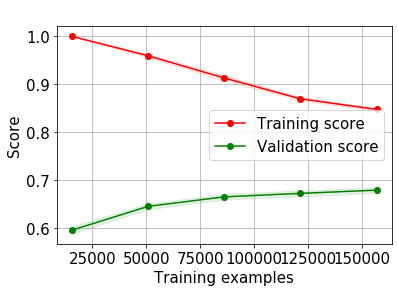

In [0]:
plot_learning_curve(clf, title=' ', X=features, y=label, ylim=None, cv=skf,
                        n_jobs=-1, train_sizes=np.linspace(.1, 1.0, 5))

In [0]:
clf = GradientBoostingClassifier(random_state=SEED)
model_assessment(clf, features, label, cv=skf)

(0.8025166232701014, 0.512067141621207)

In [0]:
model_cat = CatBoostClassifier(random_state=SEED, silent=True)
cv_catboost = cross_val_score(model_cat, X, Y, cv=shuffle_split, scoring='roc_auc', n_jobs=-1)

In [0]:
cv_catboost

array([0.67643063, 0.6821534 , 0.67773402, 0.67687917, 0.67254851])

In [0]:
rf = RandomForestClassifier(n_estimators=100, random_state=SEED)
model_assessment(rf, features, label, cv=skf)

(0.7777941436427851, 0.502491620340959)

# Balanced


In [0]:
from sklearn.utils.class_weight import compute_sample_weight

In [0]:
def mean_cv_score(estimator, features, labels, weights=None, metric_name="roc_auc"):
    return round(np.mean(cross_val_score(
        estimator=estimator,
        X=features,
        y=labels,
        scoring=metric_name,
        cv=skf,
        n_jobs=-1,
        fit_params={"sample_weight": weights}
    )), 4)

In [0]:
clf = GradientBoostingClassifier(random_state=SEED)

In [0]:
clf = LGBMClassifier(random_state=SEED)

In [0]:
weights_equal = compute_sample_weight(class_weight=None, y=Y)

In [0]:
weights_equal.sum()/len(weights_equal)

1.0

In [0]:
# BASE SCORE
mean_cv_score(clf, X, Y, weights_equal)

0.6895

In [0]:
# balanced возвращает соотношение объектов 50/50
weights_balanced = compute_sample_weight(class_weight="balanced", y=Y)

In [0]:
np.unique(
    weights_balanced, 
    return_counts=True)

(array([ 0.51132238, 22.58015971]), array([143786,   3256]))

In [0]:
# Пробую соотношения классов 25% к 75% и 10% к 90%
unique_weights_balanced = np.unique(weights_balanced)

weights_25_75 = compute_sample_weight(
    class_weight={0: unique_weights_balanced[0] * (25/50), 1: unique_weights_balanced[1] * (75/50)},
    y=Y
)

weights_10_90 = compute_sample_weight(
    class_weight={0: unique_weights_balanced[0] * (10/50), 1: unique_weights_balanced[1] * (90/50)},
    y=Y
)

In [0]:
mean_cv_score(clf, X, Y, weights_balanced)

0.6895

In [0]:
mean_cv_score(clf, X, Y, weights_25_75)

0.6799

In [0]:
mean_cv_score(clf, X, Y, weights_10_90)

0.6349

In [0]:
ngb = NGBClassifier(Base=default_tree_learner, Dist=Bernoulli, Score=MLE, verbose=True)

In [0]:
from ngboost import NGBClassifier
from ngboost.learners import default_tree_learner
from ngboost.scores import MLE
from ngboost.distns import Bernoulli

In [0]:
ngb.fit(X, Y)
preds = ngb.pred_dist(X_test)
print("ROC:", roc_auc_score(Y_test, preds.prob))

[iter 0] loss=0.1063 val_loss=0.0000 scale=1.0000 norm=0.0433
[iter 100] loss=0.1060 val_loss=0.0000 scale=1.0000 norm=0.0433
[iter 200] loss=0.1058 val_loss=0.0000 scale=1.0000 norm=0.0433
[iter 300] loss=0.1056 val_loss=0.0000 scale=1.0000 norm=0.0433
[iter 400] loss=0.1054 val_loss=0.0000 scale=1.0000 norm=0.0433
ROC: 0.6477387298974202


# Make features

In [0]:
def feature_engineering_2(data, group_col='userid'):

  df = data.copy()

  df['DIFF_H']=abs(df['HOUR_DEPART']-df['HOUR_OF_BUY']).astype('int32')
  df['DIFF_M']=abs(df['MONTH_DEPART']-df['MONTH_BUY']).astype('int32')
  df['CHILD'] = df.TOTAL_TICKETS- df.TICKET_ADULT

  agg_func = {
        'field14': ['mean', 'std'],
        'field1': ['mean', 'std'],
        'NDAYS_FROM_LAST': ['mean', 'std'],
        'field12': ['mean', 'std'],
        'field13': ['mean', 'std'],
        'field17': ['mean', 'std'],
        'DAYS_BEFORE_DEPART': ['mean', 'std'],
        'field19': ['mean', 'std'],
        'field22': ['mean', 'std'],
        'field25': ['mean', 'std'],
        'field26': ['mean', 'std'],
        'field27': ['mean', 'std'],
        'ORDER_OF_BUY': ['mean', 'std']
    }    

  agg_trans = data.groupby(group_col).agg(agg_func)
  agg_trans.columns = ['agg_'.join(col).strip() for col in agg_trans.columns.values]
  agg_trans.reset_index(inplace=True)
    
  df = df.merge(agg_trans.fillna(-1), how='left', on=group_col)    

  df = add_sem(df, group_col='userid', used_col=['field1'])
  df = add_sem(df, group_col='userid', used_col=['field14'])
  df = add_sem(df, group_col='userid', used_col=['field26'])
  df = add_sem(df, group_col='userid', used_col=['field27'])
  df = add_sem(df, group_col='userid', used_col=['field12'])
  df = add_sem(df, group_col='userid', used_col=['NDAYS_FROM_LAST'])
  df = add_sem(df, group_col='userid', used_col=['field13'])
  df = add_sem(df, group_col='userid', used_col=['field22'])
  df = add_sem(df, group_col='userid', used_col=['field25'])

  make_conj(df, 'field1', 'field14')
  make_conj(df, 'field26', 'field27')
 
  return reduce_mem_usage(df)


In [0]:
df = feature_engineering(df)

Mem. usage decreased to 82.64 Mb (4.1% reduction)


In [0]:
def aggregate_trans(data, group_col, prefix):  
    agg_func = {
        'NDAYS_FROM_LAST': ['median', 'mean', 'std'], #num_trans
        'field12': ['sum', 'mean','median', 'max', 'min', 'std'],
        'field13': ['sum', 'mean','median', 'max', 'min', 'std'],
        'field17': ['sum', 'mean','median', 'max', 'min', 'std'],
        'DAYS_BEFORE_DEPART': ['sum', 'mean','median', 'max', 'min', 'std'],
        'field19': ['sum', 'mean','median', 'max', 'min', 'std', 'nunique'],
        'field22': ['sum', 'mean','median', 'max', 'min', 'std'],
        'field25': ['sum', 'mean','median', 'max', 'min', 'std'],
        'field26': ['sum', 'mean','median', 'max', 'min', 'std']
        # 'field1': ['sum', 'mean', 'median', 'max', 'min', 'std', 'nunique'],
        # 'field14': ['sum', 'mean', 'median', 'max', 'min', 'std', 'nunique']
    }    
    agg_trans = data.groupby(group_col).agg(agg_func)
    agg_trans.columns = [prefix + '_'.join(col).strip() for col in agg_trans.columns.values]
    agg_trans.reset_index(inplace=True)
    
    return agg_trans.fillna(-1)
    

In [0]:
# df = df.merge(aggregate_trans(df, ['YEAR', 'MONTH_BUY'], 'MB_'), how='left', on=['YEAR', 'MONTH_BUY'])
# df = df.merge(aggregate_trans(df, ['YEAR', 'HOUR_OF_BUY'], 'HOB_'), how='left', on=['YEAR', 'HOUR_OF_BUY'])
# df = df.merge(aggregate_trans(df, ['YEAR', 'DOW_BUY'], 'DOWB_'), how='left', on=['YEAR', 'DOW_BUY'])

df = df.merge(aggregate_trans(df, ['YEAR', 'MONTH_DEPART'], 'MD_'), how='left', on=['YEAR', 'MONTH_DEPART'])
df = df.merge(aggregate_trans(df, ['YEAR', 'HOUR_DEPART'], 'HD_'), how='left', on=['YEAR', 'HOUR_DEPART'])
df = df.merge(aggregate_trans(df, ['YEAR', 'DOW_DEPART'], 'DOWD_'), how='left', on=['YEAR', 'DOW_DEPART'])

In [0]:
df = df.merge(aggregate_trans(df, ['field26', 'field27'], 'F26F27_'), how='left', on=['field26', 'field27'])
df = df.merge(aggregate_trans(df, ['field1', 'field14'], 'F1F14_'), how='left', on=['field1', 'field14'])
df.shape

(196056, 305)

In [0]:
df[:3]

,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,goal21,goal22,goal23,goal24,goal25,goal1,USR_CNT,INDICATOR_CNT,DIFF_H,DIFF_M,CHILD,f14_id_median,f1_id_median,f1_id_std,f14_id_std,f26_id_median,f27_id_median,f26_id_std,f27_id_std,DAYS_BEFORE_DEPART_id_median,DAYS_BEFORE_DEPART_id_std,NDAYS_FROM_LAST_id_median,NDAYS_FROM_LAST_id_std,ORDER_OF_BUY_id_median,ORDER_OF_BUY_id_std,field13_id_median,field13_id_std,field26_id_median,field26_id_std,field19_id_median,field19_id_std,field1_sem,field14_sem,field26_sem,field27_sem,field12_sem,NDAYS_FROM_LAST_sem,field13_sem,field22_sem,field25_sem,field1_field14,field26_field27
0,0,7458,0.000000,-0.915567,11,12,0.730463,1,0,1,1,0.0,0,9,2.055642,3.858807,-0.999325,1,1.820334,0.730463,4,0.730463,1,1,0.730463,15,1,0.730463,1.194318,0.730463,0,4,1,1,0,1,1,0,1,0,0,0,0,0.730463,0.799805,6,1,0,-0.661308,-0.626508,-1.000000,-1.000000,2.0,1.0,-1.000000,-1.000000,4.0,-1.000000,0.0,-1.000000,1.0,-1.000000,20.0,-1.000000,2.0,-1.000000,1.0,-1.000000,-1.000000,-1.000000,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,6.770766,3.858807
1,1,33232,7.397498,-0.482207,5,7,1.194318,0,0,0,1,0.0,0,21,7.104297,1.540963,-0.105673,1,5.591427,0.730463,5,0.730463,6,0,7.037818,15,1,5.012077,1.540963,0.730463,0,2,1,1,0,1,0,0,0,0,0,0,0,1.194318,0.600098,6,2,0,-0.171076,-0.393794,0.000000,0.099042,7.5,2.0,6.363961,1.414214,48.5,12.020815,72.0,101.823376,1.5,0.707107,23.5,28.991378,7.5,6.363961,1.5,0.707107,0.000000,0.070033,4.5,1.0,46.0,72.0,20.5,18.5,5.5,5.942124,3.932510
2,2,83136,7.247551,-0.750446,2,3,1.194318,0,0,1,1,0.0,1,7,1.820334,1.540963,-0.999325,1,1.820334,0.730463,2,1.540963,6,0,3.618223,14,1,0.730463,3.011340,2.440268,0,1,1,1,0,1,1,0,0,0,0,0,0,1.194318,0.799805,7,1,0,-0.661308,-0.587722,0.054851,0.000000,11.0,7.0,0.000000,0.000000,3.5,0.707107,67.0,94.752309,1.5,0.707107,4.0,1.414214,11.0,0.000000,2.0,1.414214,0.038786,0.000000,0.0,0.0,5.0,67.0,1.0,8.0,0.0,6.553880,0.730463


In [0]:
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']


skewed_feats = df[to_scale].apply(lambda x: stats.skew(x)).sort_values(ascending=False)
print("\nSkew in numerical features: \n")
skewness = pd.DataFrame({'Skew': skewed_feats})

skewness = skewness[abs(skewness) > 0.75]
print("There are {} skewed numerical features to Box Cox transform".format(skewness.shape[0]))


Skew in numerical features: 

There are 17 skewed numerical features to Box Cox transform


In [0]:
skewed_features = skewness.index
lam = 0.15
for feat in skewed_features:
    df[feat] = boxcox1p(df[feat], lam)

In [0]:
# бинаризируем периоды
bin_d={'HOUR_OF_BUY': ['1', '2', '3', '4', '5', '6', '7'], 
        'MONTH_DEPART': ['2', '3', '4', '5'],
        'field19': ['1', '2', '3', '4', '5'],
        'MONTH_BUY': ['1', '2', '3', '4', '5'], 
        'field27': ['1', '3']}

binar_cats(df, bin_d)

There are 5 new binary feats in the data: ['f_', 'f_', 'f_19', 'f_', 'f_27']


In [0]:
df['cnt_f1'] = df.field1.map( df.groupby('field1').size())
df['cnt_f14'] = df.field14.map( df.groupby('field14').size())

df['diff_f14f1'] = df.field14 - df.field1
df['prc14'] = (df.diff_f14f1 / df.field14 * 100) - 100
df['prc1'] = (df.diff_f14f1 / df.field1 * 100) - 100

# df['diff_f1f14'] = df.field1 - df.field14
# df['prc14_'] = (df.diff_f1f14 / df.field14 * 100) - 100
# df['prc1_'] = (df.diff_f1f14 / df.field1 * 100) - 100

,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,goal21,goal22,goal23,goal24,goal25,goal1,USR_CNT,INDICATOR_CNT,DIFF_H,DIFF_M,CHILD,f14_id_median,f1_id_median,f1_id_std,f14_id_std,f26_id_median,f27_id_median,f26_id_std,f27_id_std,DAYS_BEFORE_DEPART_id_median,DAYS_BEFORE_DEPART_id_std,NDAYS_FROM_LAST_id_median,NDAYS_FROM_LAST_id_std,ORDER_OF_BUY_id_median,ORDER_OF_BUY_id_std,field13_id_median,field13_id_std,field26_id_median,field26_id_std,field19_id_median,field19_id_std,field1_sem,field14_sem,field26_sem,field27_sem,field12_sem,NDAYS_FROM_LAST_sem,field13_sem,field22_sem,field25_sem,field1_field14,field26_field27,diff_f14f1,prc14,prc1
0,0,7458,0,-0.626508,11,12,1,1,0,1,1,0,0,9,5,20,-0.661308,1,4,1,4,1,1,1,1,15,1,1,2,1,0,4,1,1,0,1,1,0,1,0,0,0,0,1,0.799805,6,1,0,-0.661308,-0.626508,-1.000000,-1.000000,2.0,1.0,-1.000000,-1.000000,4.0,-1.000000,0.0,-1.000000,1.0,-1.000000,20.0,-1.000000,2.0,-1.000000,1.0,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,106,20,-0.034800,-94.737654,-94.445350
1,1,33232,144,-0.393794,5,7,2,0,0,0,1,0,0,21,125,3,-0.101043,1,57,1,5,1,6,0,121,15,1,41,3,1,0,2,1,1,0,1,0,0,0,0,0,0,0,2,0.600098,6,2,0,-0.171076,-0.393794,0.000000,0.099042,7.5,2.0,6.363961,1.414214,48.5,12.020815,72.0,101.823376,1.5,0.707107,23.5,28.991378,7.5,6.363961,1.5,0.707107,0.000000,0.070033,4.500000,1.000000,46.000000,72.000000,20.500000,18.500000,5.500000,69,21,0.292751,-389.729631,-174.341186
2,2,83136,134,-0.548937,2,3,2,0,0,1,1,0,1,7,4,3,-0.661308,1,4,1,2,3,6,0,17,14,1,1,11,7,0,1,1,1,0,1,1,0,0,0,0,0,0,2,0.799805,7,1,0,-0.661308,-0.587722,0.054851,0.000000,11.0,7.0,0.000000,0.000000,3.5,0.707107,67.0,94.752309,1.5,0.707107,4.0,1.414214,11.0,0.000000,2.0,1.414214,0.038786,0.000000,0.000000,0.000000,5.000000,67.000000,1.000000,8.000000,0.000000,95,1,-0.112372,-83.007673,-79.529209
3,3,1583,0,-0.238651,10,11,1,1,3,0,1,0,0,19,12,3,-0.521242,2,22,1,3,3,4,1,46,12,2,18,1,1,0,4,1,1,0,1,1,0,0,0,0,0,0,3,0.799805,7,1,0,-0.381176,-0.393794,0.118492,0.080867,1.0,1.0,2.309401,1.154701,22.0,9.865766,12.0,160.038537,2.0,1.000000,3.0,34.641016,1.0,2.309401,3.0,0.000000,0.068412,0.046689,1.333333,0.666667,4.630815,92.398292,20.000000,15.898987,5.666667,44,10,-0.282591,-45.785122,18.411560
4,4,93298,0,-0.704079,8,11,1,1,0,1,1,0,1,16,4,3,-0.801375,1,100,1,6,1,1,1,17,22,1,1,1,1,0,3,1,1,0,0,1,0,0,0,0,0,0,1,0.600098,6,3,0,-0.801375,-0.704079,-1.000000,-1.000000,1.0,1.0,-1.000000,-1.000000,100.0,-1.000000,0.0,-1.000000,1.0,-1.000000,3.0,-1.000000,1.0,-1.000000,1.0,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,118,10,-0.097295,-87.858944,-86.181195
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196051,196051,101142,30,-0.083509,7,7,2,0,0,0,1,0,1,0,91,511,0.459223,1,4,33,7,2,3,1,1,17,1,1,3,1,0,3,1,1,0,1,0,0,0,0,0,0,0,4,0.600098,17,0,0,0.529256,-0.005937,0.172003,0.350166,3.0,1.0,0.000000,0.000000,1.5,1.414214,32.0,26.178872,2.5,1.290994,70.0,233.581356,3.0,0.000000,2.0,0.000000,0.086002,0.175083,0.000000,0.000000,16.413282,13.089436,116.790678,27.095510,10.250000,24,21,0.542731,18.184770,-749.910711
196052,196052,105682,104,-0.548937,11,11,2,0,0,1,1,0,0,8,5,16,-0.521242,1,0,1,5,2,5,1,1,23,1,1,12,3,0,4,1,1,0,0,0,0,0,0,0,0,0,2,0.399902,15,0,0,-0.241109,-0.393794,0.219405,0.396168,6.5,2.0,7.778175,1.414214,8.5,12.020815,52.0,73.53

In [0]:
def add_IG_agg(df):

  temp_df = df.copy()
  temp = pd.concat([temp_df.userid.map(temp_df.groupby('userid')[ig].mean()) for ig in indicator_cols], axis=1)
  temp.columns = [x + '_user_avg' for x in indicator_cols]

  return (temp)

df_indicator = pd.concat([df, add_IG_agg(df)], axis=1)

# goal21 CV mean score: 0.7464, std: 0.0030
# goal22 CV mean score: 0.7416, std: 0.0026
# goal23 CV mean score: 0.9025, std: 0.0023
# goal24 CV mean score: 0.8103, std: 0.0045
# goal25 CV mean score: 0.9391, std: 0.0016

In [0]:
def add_IG_agr(df):

  temp_df = df.copy()
  temp = pd.concat([temp_df.field1.map(temp_df.groupby('DIFF_H')[ig].mean()) for ig in indicator_cols], axis=1)
  temp.columns = [x + 'DIFF_H' for x in indicator_cols]

  return (temp.fillna(-1))

df_ = df.copy()
df_indicator = pd.concat([df_, add_IG_agr(df_)], axis=1)

In [0]:
def add_IG_mult(df, gr_col=['DOW_DEPART']):

  temp_df = df.copy()
  temp_df = add_aggregate(temp_df, group_col=gr_col, used_col='userid', func=unique_cnt, suffix='unique_cnt')
  div_col = 'userid_unique_cnt'

  temp_df = add_aggregate(temp_df, group_col=gr_col, used_col='indicator_goal21', func=sum, suffix='sum')
  temp_df['INDICATOR21_AGG_norm'] = temp_df['indicator_goal21_sum']/temp_df[div_col]
  temp_df = add_aggregate(temp_df, group_col=gr_col, used_col='indicator_goal22', func=sum, suffix='sum')
  temp_df['INDICATOR22_AGG_norm'] = temp_df['indicator_goal22_sum']/temp_df[div_col]
  temp_df = add_aggregate(temp_df, group_col=gr_col, used_col='indicator_goal23', func=sum, suffix='sum')
  temp_df['INDICATOR23_AGG_norm'] = temp_df['indicator_goal23_sum']/temp_df[div_col]
  temp_df = add_aggregate(temp_df, group_col=gr_col, used_col='indicator_goal24', func=sum, suffix='sum')
  temp_df['INDICATOR24_AGG_norm'] = temp_df['indicator_goal24_sum']/temp_df[div_col]
  temp_df = add_aggregate(temp_df, group_col=gr_col, used_col='indicator_goal25', func=sum, suffix='sum')
  temp_df['INDICATOR25_AGG_norm'] = temp_df['indicator_goal25_sum']/temp_df[div_col]

  return (temp_df.filter(regex='AGG_norm'))

In [0]:
df_ = df.copy()
df_indicator = pd.concat([df_, add_IG_mult(df_, gr_col=['field1'])], axis=1)
# default 0.7451 0013
# field27 0.7453 0011
# field26 0.7448, std: 0.0019
# field14 0.7438, std: 0.0025
# field1 0.7437, std: 0.0021

In [0]:
df_ = df.copy()

# make_conj(df_, 'field14', 'field26')
# df_.field14_field26 = np.log1p(df_.field14_field26)
# 'field1', 'field26' 0.7442, std: 0.0013
# 'field1', 'field27' 0.7443, std: 0.0012
# 'field14', 'field27' 0.7450, std: 0.0012
# 'field14', 'field26' 0.7446, std: 0.0017

# df_['TODAY']=(df_.DAYS_BEFORE_DEPART==0).astype('int32')
# 7439

## New features

In [0]:
# df['WEEKS_BEFORE_DEPART'] = (df.DAYS_BEFORE_DEPART / 7).astype('float32')
# df['WEEKEND_DEPART'] = (df.DOW_DEPART >=5).astype('int16')

# df['NDAYS_LAST_NEXT'] = (df.NDAYS_FROM_LAST+df.DAYS_BEFORE_DEPART).astype('int32')
# df['TODAY']=(df.DAYS_BEFORE_DEPART==0).astype('int32')
df['DIFF_H']=abs(df['HOUR_DEPART']-df['HOUR_OF_BUY']).astype('int32')
df['DIFF_M']=abs(df['MONTH_DEPART']-df['MONTH_BUY']).astype('int32')
# df['NUM_MONTH_DEPART'] = (df.MONTH_DEPART-12) *(df.YEAR==0) + (df.MONTH_DEPART )*(df.YEAR==1)
# df['NUM_MONTH_BUY'] = (df.MONTH_BUY-12) *(df.YEAR==0) + (df.MONTH_BUY )*(df.YEAR==1)
# df['DIFF_NUM_MONTH'] = abs(df['NUM_MONTH_DEPART'] - df['NUM_MONTH_BUY'])
df['CHILD'] = df.TOTAL_TICKETS- df.TICKET_ADULT

# df['DIFF_MONTH_DEPART&MONTH_OF_BUY_norm'] = df['DIFF_MONTH_DEPART&MONTH_OF_BUY']#.values / (np.pi ** np.e)
# df['DIFF_HOUR_DEPART&HOUR_OF_BUY_norm'] = df['DIFF_HOUR_DEPART&HOUR_OF_BUY']#.values / (np.pi ** np.e)
# df['DIFF_NUM_MONTH_norm'] = df['DIFF_NUM_MONTH']#.values / (np.pi ** np.e)


# df['INDICATOR_USR_AVG'] = df.userid.map(df.groupby('userid')[indicator_cols].sum().mean(axis=1))
# indicators_group = df.groupby('userid')[indicator_cols]
# df_sum=indicators_group.sum().copy()
# df_indicators_avg=df_sum.div(indicators_group.sum().sum(axis=1), axis=0)
# df_indicators_avg.columns = ['INDICATOR21_TOTAL_AVG', 'INDICATOR22_TOTAL_AVG', 'INDICATOR23_TOTAL_AVG', 
#                              'INDICATOR24_TOTAL_AVG', 'INDICATOR25_TOTAL_AVG']
# df = df.merge(df_indicators_avg, how='left', on='userid')

# make_conj(df, 'field1', 'field14')
# make_conj(df, 'field26', 'field27')

# del indicators_group, df_sum, df_indicators_avg
gc.collect()

# "MONTH_DEPART", "field12", percentiles, mean, median and so forth
# 'MONTH_BUY', "DAYS_BEFORE_DEPART" percentiles, mean median...
# 'MONTH_BUY', "field13", 'field22', 'field25', 'field26', 'NDAYS_FROM_LAST', 'USR_CNT' percentiles, mean median...
# сравнение статистик мес к мес за 2 года
# field5==0 YEAR==0 нет goals == 1 -> conj field5 & YEAR, field26&field27
# 'field5', "TICKET_ADULT" statistics
# DOW_BUY: 'field12' 13 22, field25!, NDAYS_LAST_NEXT
# HOUR_DEPART: DAYS_BEFORE_DEPART, field12!, 13, 14, field17 field22 field25! 26 NDAYS_FROM_LAST NDAYS_LAST_NEXT
# field27: NDAYS_LAST_NEXT, NDAYS_FROM_LAST, field25! 22 field13 field12 DAYS_BEFORE_DEPART

8

In [0]:
df['f14_id_median'] = df.userid.map(df.groupby('userid')['field14'].median().fillna(-1))
df['f1_id_median'] = df.userid.map(df.groupby('userid')['field1'].median().fillna(-1))

df['f1_id_std'] = df.userid.map(df.groupby('userid')['field1'].std().fillna(-1))
df['f14_id_std'] = df.userid.map(df.groupby('userid')['field14'].std().fillna(-1))

df['f26_id_median'] = df.userid.map(df.groupby('userid')['field26'].median().fillna(-1))
df['f27_id_median'] = df.userid.map(df.groupby('userid')['field27'].median().fillna(-1))

df['f26_id_std'] = df.userid.map(df.groupby('userid')['field26'].std().fillna(-1))
df['f27_id_std'] = df.userid.map(df.groupby('userid')['field27'].std().fillna(-1))

In [0]:
df = add_sem(df, group_col='userid', used_col=['field1'], prefix='f1')
df = add_sem(df, group_col='userid', used_col=['field14'], prefix='f14')

df = add_sem(df, group_col='userid', used_col=['field26'], prefix='f26')
df = add_sem(df, group_col='userid', used_col=['field27'], prefix='f27')

In [0]:
make_conj(df, 'field1', 'field14')
make_conj(df, 'field26', 'field27')

In [0]:
from collections import Counter
# c = Counter
# c(df.query("userid == 113896").HOUR_DEPART).most_common()[0][0]

23

In [0]:
# grouped_mult_id = df.query("USR_CNT > 1").groupby('userid')
# funct = lambda x: Counter(x).most_common()[0][0]

# df['freq_HOB'] = df.userid.map(grouped_mult_id.HOUR_OF_BUY.apply(funct).fillna(-1)) # CV mean score: 0.6893, std: 0.0046.

In [0]:
# df.freq_HOB.fillna(-1, inplace=True)

In [0]:
# df['freq_HD'] = df.userid.map(grouped_mult_id.HOUR_DEPART.apply(funct)).fillna(-1) # CV mean score: 0.6893, std: 0.0048

In [0]:
# df['f12_id_median'] = df.userid.map(df.groupby('userid')['field12'].median().fillna(-1))
# df['f12_id_std'] = df.userid.map(df.groupby('userid')['field12'].std().fillna(-1)) # CV mean score: 0.6893, std: 0.0052

In [0]:
df = add_sem(df, group_col='userid', used_col=['field12'], prefix='f12') # CV mean score: 0.6901, std: 0.0050

In [0]:
df['DAYS_BEFORE_DEPART_id_median'] = df.userid.map(df.groupby('userid')['DAYS_BEFORE_DEPART'].median().fillna(-1))
df['DAYS_BEFORE_DEPART_id_std'] = df.userid.map(df.groupby('userid')['DAYS_BEFORE_DEPART'].std().fillna(-1))

# CV mean score: 0.6930, std: 0.0051
# CV mean score: 0.6933, std: 0.0046 without freq_HOB, freq_HD

In [0]:
# df = add_sem(df, group_col='userid', used_col=['DAYS_BEFORE_DEPART'], prefix='DAYS_BEFORE_DEPART')
# df.drop(columns='DAYS_BEFORE_DEPART_sem_DAYS_BEFORE_DEPART', axis=1, inplace=True)

In [0]:
df = add_sem(df, group_col='userid', used_col=['NDAYS_FROM_LAST'], prefix='_') # CV mean score: 0.6947, std: 0.0039

In [0]:
df['NDAYS_FROM_LAST_id_median'] = df.userid.map(df.groupby('userid')['NDAYS_FROM_LAST'].median().fillna(-1))
df['NDAYS_FROM_LAST_id_std'] = df.userid.map(df.groupby('userid')['NDAYS_FROM_LAST'].std().fillna(-1))
# CV mean score: 0.6977, std: 0.0049

In [0]:
# df = add_sem(df, group_col='userid', used_col=['ORDER_OF_BUY'], prefix='_') # CV mean score: 0.6978, std: 0.0045
# df.drop(columns='ORDER_OF_BUY_sem__', axis=1, inplace=True)

In [0]:
df['ORDER_OF_BUY_id_median'] = df.userid.map(df.groupby('userid')['ORDER_OF_BUY'].median().fillna(-1))
df['ORDER_OF_BUY_id_std'] = df.userid.map(df.groupby('userid')['ORDER_OF_BUY'].std().fillna(-1))

# CV mean score: 0.6977, std: 0.0049

In [0]:
df = add_sem(df, group_col='userid', used_col=['field13'], prefix='_') # CV mean score: 0.7001, std: 0.0054

In [0]:
df['field13_id_median'] = df.userid.map(df.groupby('userid')['field13'].median().fillna(-1))
df['field13_id_std'] = df.userid.map(df.groupby('userid')['field13'].std().fillna(-1))

# CV mean score: 0.7008, std: 0.0053

In [0]:
# df = add_sem(df, group_col='userid', used_col=['field17'], prefix='_') # CV mean score: 0.7006, std: 0.0050
# df.drop(columns='field17_sem__', axis=1, inplace=True)

In [0]:
# df['field17_id_median'] = df.userid.map(df.groupby('userid')['field17'].median().fillna(-1))
# df['field17_id_std'] = df.userid.map(df.groupby('userid')['field17'].std().fillna(-1))
# CV mean score: 0.6997, std: 0.0045
# df.drop(columns='field17_id_median', axis=1, inplace=True)
# df.drop(columns='field17_id_std', axis=1, inplace=True)

In [0]:
df = add_sem(df, group_col='userid', used_col=['field22'], prefix='_') # CV mean score: 0.7010, std: 0.0050

In [0]:
# df['field22_id_median'] = df.userid.map(df.groupby('userid')['field22'].median().fillna(-1))
# df['field22_id_std'] = df.userid.map(df.groupby('userid')['field22'].std().fillna(-1))

# CV mean score: 0.7007, std: 0.0044
# df.drop(columns=['field22_id_median', 'field22_id_std'], axis=1, inplace=True)

In [0]:
df = add_sem(df, group_col='userid', used_col=['field25'], prefix='_') # CV mean score: 0.7014, std: 0.0044

In [0]:
# df['field25_id_median'] = df.userid.map(df.groupby('userid')['field25'].median().fillna(-1))
# df['field25_id_std'] = df.userid.map(df.groupby('userid')['field25'].std().fillna(-1))
# CV mean score: 0.7009, std: 0.0043
# df.drop(columns=['field25_id_median', 'field25_id_std'], axis=1, inplace=True)

In [0]:
# df = add_sem(df, group_col='userid', used_col=['field26'], prefix='_') # CV mean score: 0.7002, std: 0.0041
# df.drop(columns=['field26_sem__'], axis=1, inplace=True)

In [0]:
df['field26_id_median'] = df.userid.map(df.groupby('userid')['field26'].median().fillna(-1))
df['field26_id_std'] = df.userid.map(df.groupby('userid')['field26'].std().fillna(-1))
# CV mean score: 0.7007, std: 0.0038

In [0]:
# df = add_sem(df, group_col='userid', used_col=['field19'], prefix='_') # CV mean score: 0.7003, std: 0.0049
# df.drop(columns=['field19_sem__'], axis=1, inplace=True)

In [0]:
df['field19_id_median'] = df.userid.map(df.groupby('userid')['field19'].median().fillna(-1))
df['field19_id_std'] = df.userid.map(df.groupby('userid')['field19'].std().fillna(-1))
# CV mean score: 0.7016, std: 0.0049

In [0]:
# make_conj(df, 'field1', 'field14')
# make_conj(df, 'field26', 'field27')

to_scale_f1f14 = ['field1_field14', 'field26_field27']#+['DIFF_NUM_MONTH', 'DIFF_MONTH_DEPART&MONTH_OF_BUY', 'DIFF_HOUR_DEPART&HOUR_OF_BUY',
                                                        # 'NDAYS_LAST_NEXT']
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field26', 'field19', 'USR_CNT']+to_scale_f1f14
# df[to_scale] = RobustScaler().fit_transform(df[to_scale])
df[to_scale] = np.log1p(df[to_scale])

In [0]:
to_scale = ['field1_field14', 'field26_field27']
df[to_scale] = RobustScaler().fit_transform(df[to_scale])

In [0]:
# to_log=[x for x in to_ohe_cols if 'field27' not in x and x in df.columns]
# df[to_log] = (df[to_log]).transform(np.log1p)

df.ORDER_OF_BUY = (df.ORDER_OF_BUY).transform(np.log1p)

In [0]:
# gr_qcut = ['YEAR', 'MONTH_DEPART', 'DOW_DEPART']
SEM_GROUP_HOUR_DEPART = ['HOUR_DEPART']
SEM_GROUP_DOW_BUY = ['DOW_BUY']
SEM_GROUP_HOUR_OF_BUY = ['HOUR_OF_BUY']

SEM_USE_COLS = ['field12', 'field13', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field26']
# qlabels=range(1,6)

df = add_sem(df, group_col=SEM_GROUP_HOUR_DEPART, used_col=SEM_USE_COLS, prefix='HOUR_DEPART')
df = add_sem(df, group_col=SEM_GROUP_DOW_BUY, used_col=SEM_USE_COLS, prefix='DOW_BUY')
df = add_sem(df, group_col=SEM_GROUP_HOUR_OF_BUY, used_col=SEM_USE_COLS, prefix='HOUR_OF_BUY')

gr_col=['MONTH_DEPART']
df = make_real_feature(df, used_col='NDAYS_FROM_LAST', group_col=gr_col, prefix='MD')
df = make_real_feature(df, used_col='field12', group_col=gr_col, prefix='MD')
df = make_real_feature(df, used_col='field13', group_col=gr_col, prefix='MD')
df = make_real_feature(df, used_col='field17', group_col=gr_col, prefix='MD')
df = make_real_feature(df, used_col='DAYS_BEFORE_DEPART', group_col=gr_col, prefix='MD')
df = make_real_feature(df, used_col='field22', group_col=gr_col, prefix='MD')
df = make_real_feature(df, used_col='field25', group_col=gr_col, prefix='MD')
df = make_real_feature(df, used_col='field26', group_col=gr_col, prefix='MD')

gr_col=['DOW_DEPART']
df = make_real_feature(df, used_col='NDAYS_FROM_LAST', group_col=gr_col, prefix='DD')
df = make_real_feature(df, used_col='field12', group_col=gr_col, prefix='DD')
df = make_real_feature(df, used_col='field13', group_col=gr_col, prefix='DD')
df = make_real_feature(df, used_col='field17', group_col=gr_col, prefix='DD')
df = make_real_feature(df, used_col='DAYS_BEFORE_DEPART', group_col=gr_col, prefix='DD')
df = make_real_feature(df, used_col='field22', group_col=gr_col, prefix='DD')
df = make_real_feature(df, used_col='field25', group_col=gr_col, prefix='DD')
df = make_real_feature(df, used_col='field26', group_col=gr_col, prefix='DD')

gr_col=['HOUR_DEPART']
df = make_real_feature(df, used_col='NDAYS_FROM_LAST', group_col=gr_col, prefix='HD')
df = make_real_feature(df, used_col='field12', group_col=gr_col, prefix='HD')
df = make_real_feature(df, used_col='field13', group_col=gr_col, prefix='HD')
df = make_real_feature(df, used_col='field17', group_col=gr_col, prefix='HD')
df = make_real_feature(df, used_col='DAYS_BEFORE_DEPART', group_col=gr_col, prefix='HD')
df = make_real_feature(df, used_col='field22', group_col=gr_col, prefix='HD')
df = make_real_feature(df, used_col='field25', group_col=gr_col, prefix='HD')
df = make_real_feature(df, used_col='field26', group_col=gr_col, prefix='HD')

# df = add_quantile(df, group_col=gr_qcut, used_col='NDAYS_FROM_LAST')
# df['MONTH_BUY&NDAYS_FROM_LAST_ql'] =df.groupby('MONTH_BUY')['NDAYS_FROM_LAST'].transform(
#                       lambda x: pd.qcut(x, len(qlabels), labels=qlabels))

# df = add_quantile(df, group_col=gr_qcut, used_col='field12')
# df['MONTH_BUY&field12_ql'] =df.groupby('MONTH_BUY')['field12'].transform(
#                       lambda x: pd.qcut(x, len(qlabels), labels=qlabels))

# df = add_quantile(df, group_col=gr_qcut, used_col='field13')
# df['MONTH_BUY&field13_ql'] =df.groupby('MONTH_BUY')['field13'].transform(
#                       lambda x: pd.qcut(x, len(qlabels), labels=qlabels))

# df = add_quantile(df, group_col=gr_qcut, used_col='field17')
# df['MONTH_BUY&field17_ql'] =df.groupby('MONTH_BUY')['field17'].transform(
#                       lambda x: pd.qcut(x, len(qlabels), labels=qlabels))


# df = add_quantile(df, group_col=gr_qcut, used_col='DAYS_BEFORE_DEPART')
# df['MONTH_BUY&DAYS_BEFORE_DEPART_ql'] =df.groupby('MONTH_BUY')['DAYS_BEFORE_DEPART'].transform(
#                       lambda x: pd.qcut(x, len(qlabels), labels=qlabels))


# df = add_quantile(df, group_col=gr_qcut, used_col='field22')
# df['MONTH_BUY&field22_ql'] =df.groupby('MONTH_BUY')['field22'].transform(
#                       lambda x: pd.qcut(x, len(qlabels), labels=qlabels))


# df = add_quantile(df, group_col=gr_qcut, used_col='field25')
# df['MONTH_BUY&field25_ql'] =df.groupby('MONTH_BUY')['field25'].transform(
#                       lambda x: pd.qcut(x, len(qlabels), labels=qlabels))

# df = add_quantile(df, group_col=gr_qcut, used_col='field26')
# df['MONTH_BUY&field26_ql'] =df.groupby('MONTH_BUY')['field26'].transform(
#                       lambda x: pd.qcut(x, len(qlabels), labels=qlabels))


In [0]:
SEM_USE_COLS = ['field1_field14']
df = add_sem(df, group_col=SEM_GROUP_HOUR_DEPART, used_col=SEM_USE_COLS, prefix='HOUR_DEPART_f1&f14')
df = add_sem(df, group_col=SEM_GROUP_DOW_BUY, used_col=SEM_USE_COLS, prefix='DOW_BUY_f1&f14')
df = add_sem(df, group_col=SEM_GROUP_HOUR_OF_BUY, used_col=SEM_USE_COLS, prefix='HOUR_OF_BUY_f1&f14')

SEM_USE_COLS = ['field26_field27']
df = add_sem(df, group_col=SEM_GROUP_HOUR_DEPART, used_col=SEM_USE_COLS, prefix='HOUR_DEPART_f26&f27')
df = add_sem(df, group_col=SEM_GROUP_DOW_BUY, used_col=SEM_USE_COLS, prefix='DOW_BUY_f26&f27')
df = add_sem(df, group_col=SEM_GROUP_HOUR_OF_BUY, used_col=SEM_USE_COLS, prefix='HOUR_OF_BUY_f26&f27')

gr_col=['field1_field14']
prefix = 'MD_f1&f14'
df = make_real_feature(df, used_col='NDAYS_FROM_LAST', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field12', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field13', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field17', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='DAYS_BEFORE_DEPART', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field22', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field25', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field26', group_col=gr_col, prefix=prefix)


gr_col=['field26_field27']
prefix = 'MD_f26&f27'
df = make_real_feature(df, used_col='NDAYS_FROM_LAST', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field12', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field13', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field17', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='DAYS_BEFORE_DEPART', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field22', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field25', group_col=gr_col, prefix=prefix)
df = make_real_feature(df, used_col='field26', group_col=gr_col, prefix=prefix)

In [0]:
# df.filter(regex='median|mean|sum|amax|size').columns.tolist()

In [0]:
gr_col=['MONTH_DEPART']  # 'HOUR_DEPART' 
df = add_aggregate(df, group_col=gr_col, used_col='userid', func=unique_cnt, suffix='unique_cnt_MD')
df = add_aggregate(df, group_col=gr_col, used_col='userid', func=cnt_, suffix='cnt_MD')
df = add_aggregate(df, group_col=gr_col, used_col='CHILD', func=sum, suffix='sum_MD')

div_col = 'userid_unique_cnt_MD'
df = add_aggregate(df, group_col=gr_col, used_col='indicator_goal21', func=sum, suffix='sum_MD')
df['INDICATOR21_AGG_norm_MD'] = df['indicator_goal21_sum_MD']/df[div_col]
df = add_aggregate(df, group_col=gr_col, used_col='indicator_goal22', func=sum, suffix='sum_MD')
df['INDICATOR22_AGG_norm_MD'] = df['indicator_goal22_sum_MD']/df[div_col]
df = add_aggregate(df, group_col=gr_col, used_col='indicator_goal23', func=sum, suffix='sum_MD')
df['INDICATOR23_AGG_norm_MD'] = df['indicator_goal23_sum_MD']/df[div_col]
df = add_aggregate(df, group_col=gr_col, used_col='indicator_goal24', func=sum, suffix='sum_MD')
df['INDICATOR24_AGG_norm_MD'] = df['indicator_goal24_sum_MD']/df[div_col]
df = add_aggregate(df, group_col=gr_col, used_col='indicator_goal25', func=sum, suffix='sum_MD')
df['INDICATOR25_AGG_norm_MD'] = df['indicator_goal25_sum_MD']/df[div_col]

gr_col=['DOW_DEPART'] 
df = add_aggregate(df, group_col=gr_col, used_col='userid', func=unique_cnt, suffix='unique_cnt_DD')
df = add_aggregate(df, group_col=gr_col, used_col='userid', func=cnt_, suffix='cnt_DD')
df = add_aggregate(df, group_col=gr_col, used_col='CHILD', func=sum, suffix='sum_DD')

div_col = 'userid_unique_cnt_DD'
df = add_aggregate(df, group_col=gr_col, used_col='indicator_goal21', func=sum, suffix='sum_DD')
df['INDICATOR21_AGG_norm_DD'] = df['indicator_goal21_sum_DD']/df[div_col]
df = add_aggregate(df, group_col=gr_col, used_col='indicator_goal22', func=sum, suffix='sum_DD')
df['INDICATOR22_AGG_norm_DD'] = df['indicator_goal22_sum_DD']/df[div_col]
df = add_aggregate(df, group_col=gr_col, used_col='indicator_goal23', func=sum, suffix='sum_DD')
df['INDICATOR23_AGG_norm_DD'] = df['indicator_goal23_sum_DD']/df[div_col]
df = add_aggregate(df, group_col=gr_col, used_col='indicator_goal24', func=sum, suffix='sum_DD')
df['INDICATOR24_AGG_norm_DD'] = df['indicator_goal24_sum_DD']/df[div_col]
df = add_aggregate(df, group_col=gr_col, used_col='indicator_goal25', func=sum, suffix='sum_DD')
df['INDICATOR25_AGG_norm_DD'] = df['indicator_goal25_sum_DD']/df[div_col]

In [0]:
# df['FIELD12_sum/USR_UNIQUE_CNT'] = df['FIELD12_sum']/df['userid_unique_cnt']
# df['FIELD12_median/USR_UNIQUE_CNT'] = df['FIELD12_median']/df['userid_unique_cnt']

# df['FIELD13_sum/USR_UNIQUE_CNT'] = df['FIELD13_sum']/df['userid_unique_cnt']
# df['FIELD13_median/USR_UNIQUE_CNT'] = df['FIELD13_median']/df['userid_unique_cnt']

# df['FIELD17_sum/USR_UNIQUE_CNT'] = df['FIELD17_sum']/df['userid_unique_cnt']
# df['FIELD17_median/USR_UNIQUE_CNT'] = df['FIELD17_median']/df['userid_unique_cnt']

# df['FIELD22_sum/USR_UNIQUE_CNT'] = df['FIELD22_sum']/df['userid_unique_cnt']
# df['FIELD22_median/USR_UNIQUE_CNT'] = df['FIELD22_median']/df['userid_unique_cnt']

# df['FIELD25_sum/USR_UNIQUE_CNT'] = df['FIELD25_sum']/df['userid_unique_cnt']
# df['FIELD25_median/USR_UNIQUE_CNT'] = df['FIELD25_median']/df['userid_unique_cnt']

# df['FIELD26_sum/USR_UNIQUE_CNT'] = df['FIELD26_sum']/df['userid_unique_cnt']
# df['FIELD26_median/USR_UNIQUE_CNT'] = df['FIELD26_median']/df['userid_unique_cnt']

In [0]:
# div_col = 'userid_unique_cnt_DD'
# df['FIELD12_sum/USR_UNIQUE_CNT_DD'] = df['FIELD12_sum_DD']/df[div_col]
# df['FIELD12_median/USR_UNIQUE_CNT_DD'] = df['FIELD12_median_DD']/df[div_col]

# df['FIELD13_sum/USR_UNIQUE_CNT_DD'] = df['FIELD13_sum_DD']/df[div_col]
# df['FIELD13_median/USR_UNIQUE_CNT_DD'] = df['FIELD13_median_DD']/df[div_col]

# df['FIELD17_sum/USR_UNIQUE_CNT_DD'] = df['FIELD17_sum_DD']/df[div_col]
# df['FIELD17_median/USR_UNIQUE_CNT_DD'] = df['FIELD17_median_DD']/df[div_col]

# df['FIELD22_sum/USR_UNIQUE_CNT_DD'] = df['FIELD22_sum_DD']/df[div_col]
# df['FIELD22_median/USR_UNIQUE_CNT_DD'] = df['FIELD22_median_DD']/df[div_col]

# df['FIELD25_sum/USR_UNIQUE_CNT_DD'] = df['FIELD25_sum_DD']/df[div_col]
# df['FIELD25_median/USR_UNIQUE_CNT_DD'] = df['FIELD25_median_DD']/df[div_col]

# df['FIELD26_sum/USR_UNIQUE_CNT_DD'] = df['FIELD26_sum_DD']/df[div_col]
# df['FIELD26_median/USR_UNIQUE_CNT_DD'] = df['FIELD26_median_DD']/df[div_col]

In [0]:
# to_drop = ['FIELD12_sum', 'FIELD12_median', 'FIELD13_sum', 'FIELD13_median', 'FIELD17_sum', 'FIELD17_median', 
#            'FIELD22_sum', 'FIELD22_median', 'FIELD25_sum', 'FIELD25_median', 'FIELD26_sum', 'FIELD26_median']

indic_sum = ['indicator_goal21_sum', 'indicator_goal22_sum', 'indicator_goal23_sum',
                 'indicator_goal24_sum', 'indicator_goal25_sum']

to_drop=[x+'_MD' for x in indic_sum] + [x+'_DD' for x in indic_sum]

df.drop(columns=to_drop, axis=1, inplace=True)

In [0]:
corr_matrix = df.corr().abs()
# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# Find index of feature columns with correlation greater than 0.9
to_drop = [column for column in upper.columns if any(upper[column] > 0.9)]

In [0]:
def correl(X_train):
    cor = X_train.corr()
    corrm = np.corrcoef(X_train.transpose())
    corr = corrm - np.diagflat(corrm.diagonal())
    print("max corr:",corr.max(), ", min corr: ", corr.min())
    c1 = cor.stack().sort_values(ascending=False).drop_duplicates()
    high_cor = c1[c1.values!=1]
    ## change this value to get more correlation results        
    thresh = 0.9
    display(high_cor[high_cor>thresh])
    return high_cor

In [0]:
corr_df = correl(df)

max corr: nan , min corr:  nan


FIELD26_median_MD_f26&f27    FIELD26_mean_MD_f26&f27    1.000000
FIELD25_median_MD_f26&f27    F26F27_field25_median      1.000000
F26F27_field17_min           FIELD25_amin_MD_f26&f27    1.000000
FIELD12_sum_MD_f26&f27       FIELD25_sum_MD_f26&f27     0.999926
FIELD17_sum_MD_f26&f27       FIELD22_sum_MD_f26&f27     0.999899
                                                          ...   
MD_field17_sum               NUM_MONTH_DEPART           0.900802
DOWD_NDAYS_FROM_LAST_median  MD_NDAYS_FROM_LAST_std     0.900788
FIELD25_mean_MD_f26&f27      F26F27_field13_mean        0.900405
FIELD12_std_MD_f26&f27       FIELD25_std_MD_f26&f27     0.900111
MD_field19_median            MD_field13_median          0.900025
Length: 1009, dtype: float64

In [0]:
corr_df.reset_index()

,level_0,level_1,0
0,FIELD26_median_MD_f26&f27,FIELD26_mean_MD_f26&f27,1.000000
1,FIELD25_median_MD_f26&f27,F26F27_field25_median,1.000000
2,F26F27_field17_min,FIELD25_amin_MD_f26&f27,1.000000
3,FIELD12_sum_MD_f26&f27,FIELD25_sum_MD_f26&f27,0.999926
4,FIELD17_sum_MD_f26&f27,FIELD22_sum_MD_f26&f27,0.999899
...,...,...,...
137462,YEAR,HD_NDAYS_FROM_LAST_std,-0.999001
137463,DOWD_field26_mean,YEAR,-0.999369
137464,YEAR,DOWD_NDAYS_FROM_LAST_mean,-0.999752
137465,DOWD_NDAYS_FROM_LAST_std,YEAR,-0.999864


In [0]:
df.shape

(196056, 558)

In [0]:
print(np.isnan(df).sum().sum())
df.fillna(0, inplace=True)
print(np.isnan(df).sum().sum())

df = reduce_mem_usage(df)

0
0
Mem. usage decreased to 293.55 Mb (3.0% reduction)


In [0]:
# Separate into train and test sets
X_train, X_test, y_train, y_test =  train_test_split(
            df.drop(['orderid', 'userid', 'goal1']+goals_cols, axis=1),
            df['goal1'], test_size=0.3, random_state=SEED)

# set up the discretisation transformer
disc = dsc.DecisionTreeDiscretiser(cv=5,
                              scoring='roc_auc',
                              variables=['field1_field14'],
                              regression=False)

# fit the transformer
disc.fit(X_train, y_train)

# transform the data
train_t= disc.transform(X_train)
test_t= disc.transform(X_test)

disc.binner_dict_


{'field1_field14': GridSearchCV(cv=5, error_score='raise-deprecating',
              estimator=DecisionTreeClassifier(class_weight=None,
                                               criterion='gini', max_depth=None,
                                               max_features=None,
                                               max_leaf_nodes=None,
                                               min_impurity_decrease=0.0,
                                               min_impurity_split=None,
                                               min_samples_leaf=1,
                                               min_samples_split=2,
                                               min_weight_fraction_leaf=0.0,
                                               presort=False, random_state=None,
                                               splitter='best'),
              iid='warn', n_jobs=None, param_grid={'max_depth': [1, 2, 3, 4]},
              pre_dispatch='2*n_jobs', refit=True, return_train_s

Text(0, 0.5, 'returns')

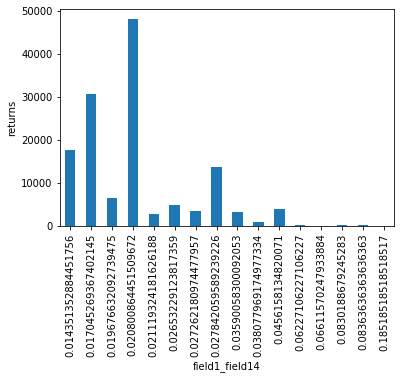

In [0]:
train_t.groupby('field1_field14')['field1_field14'].count().plot.bar()
plt.ylabel('returns')

In [0]:
df_copy['user_le'] = LabelEncoder().fit_transform(df_copy.userid)

In [0]:
gr_cols=['YEAR', 'MONTH_DEPART', 'DOW_DEPART', 'HOUR_DEPART']
df_grouped=df_copy.groupby(gr_cols).groups

In [0]:
list_ind = []
for _, v in df_grouped.items():
  list_ind.append(np.array(v, dtype='int32'))

len(list_ind)

3529

In [0]:
dict_depart = dict()
for label, depart in enumerate(list_ind):
  for user_index in depart:
      dict_depart[user_index] = label

df_copy['DEPART_INDEX'] = df_copy.index.to_series().map(dict_depart)

In [0]:
user3 = df_copy.query("USR_CNT==3")["user_le"].values
user4 = df_copy.query("USR_CNT==4")["user_le"].values


In [0]:
list_cnt = df_copy.query("USR_CNT>2")["USR_CNT"].unique()

In [0]:
from tqdm import tqdm_notebook

In [0]:
%%timeit

list_dicts = []
for cnt in tqdm_notebook(list_cnt):
  list_user_le = df_copy.query("USR_CNT == @cnt")['user_le'].values

  for i, user in tqdm_notebook(enumerate(list_user_le)):
    dep_ind = df_copy.DEPART_INDEX.where(df_copy.user_le == user).dropna().values.astype('int32')
    all_users = df_copy.user_le.where(df_copy.DEPART_INDEX.isin(dep_ind)).dropna().values.astype('int32')

    c = collections.Counter(all_users)
    d = dict()
    tmp = [k for k, _ in c.items() if c[k]==cnt]
    if len(tmp)>1:
      for value in tmp:
        d[value] = str(cnt) + '_' + str(i)

  if bool(d):
    list_dicts.append(d)

import json
colab_path = '/content/drive/My Drive/'
with open( os.path.join(colab_path,'list_dict.json'), 'w') as fp:
    json.dump(list_dicts, fp)


1 loop, best of 3: 9min 48s per loop


In [0]:
import collections

In [0]:
import json

colab_path = '/content/drive/My Drive/'
with open( os.path.join(colab_path,'list_dict2.json'), 'w') as fp:
    json.dump(list_dicts, fp)

In [0]:
all_users = df_copy.user_le.where(df_copy.DEPART_INDEX.isin(dep_ind)).dropna().values.astype('int32')

In [0]:
df_copy.query("user_le == 67401 & DEPART_INDEX==3277")

,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,goal21,goal22,goal23,goal24,goal25,goal1,USR_CNT,INDICATOR_CNT,NDAYS_LAST_NEXT,TODAY,DIFF_HOUR_DEPART&HOUR_OF_BUY,DIFF_MONTH_DEPART&MONTH_OF_BUY,NUM_MONTH_BUY,NUM_MONTH_DEPART,DIFF_NUM_MONTH,DIFF_HOUR_DEPART&HOUR_OF_BUY_norm,CHILD,field1_field14,user_le,DEPART_INDEX
72219,72219,976fce59d2846df18470ebe89dacbe48fb8606f0c9c0e0...,2,0.381920,10,11,16,0,0,0,1,0,0,14,6,3,1.299621,1,3,1,1,1,4,1,6,12,1,4,3,1,0,4,1,1,0,1,1,0,0,0,0,0,0,110,0.799805,5,0,-2,1,10,11,1,-0.089051,0,226,67401,3277
78489,78489,976fce59d2846df18470ebe89dacbe48fb8606f0c9c0e0...,4,0.769776,11,11,30,0,0,0,1,0,0,17,6,3,1.859887,1,3,1,1,1,4,1,6,12,1,4,3,1,0,4,1,1,0,1,1,0,0,0,0,0,0,110,0.799805,7,0,-5,0,11,11,0,-0.222626,0,327,67401,3277
124724,124724,976fce59d2846df18470ebe89dacbe48fb8606f0c9c0e0...,0,0.071634,10,11,20,0,0,0,1,0,0,19,5,3,0.739355,1,2,1,2,1,4,1,99,12,1,22,1,1,0,4,1,1,0,0,1,0,0,0,0,0,0,110,0.600098,2,0,-7,1,10,11,1,-0.311677,0,155,67401,3277


In [0]:
c = collections.Counter(all_users)
d = collections.defaultdict(int)
for value in [k for k, _ in c.items() if c[k]==3 and k !=1583 ]:
  d[value] = 3

d

defaultdict(int, {17807: 3, 43407: 3, 67401: 3})

In [0]:
c = collections.Counter(all_users)
d = dict()
for value in [k for k, _ in c.items() if c[k]==3 and k !=1583 ]:
  d[value] = 3

d

{17807: 3, 43407: 3, 67401: 3}

In [0]:
len([k for k, _ in c.items() if c[k]==3 and k !=1583 ]

3

In [0]:
df_copy.loc[df_copy.field1_field14.isin(largest_users100), :]

,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,goal21,goal22,goal23,goal24,goal25,goal1,USR_CNT,INDICATOR_CNT,NDAYS_LAST_NEXT,TODAY,DIFF_HOUR_DEPART&HOUR_OF_BUY,DIFF_MONTH_DEPART&MONTH_OF_BUY,NUM_MONTH_BUY,NUM_MONTH_DEPART,DIFF_NUM_MONTH,field1_field14,DIFF_HOUR_DEPART&HOUR_OF_BUY_norm
0,0,10d654494cbe97bbb25d51ead2600679aff9e097924add...,0,-0.626508,11,12,1,1,0,1,1,0,0,9,5,20,-0.661308,1,4,1,4,1,1,1,1,15,1,1,2,1,0,4,1,1,0,1,1,0,1,0,0,0,0,1,0.799805,4,0,6,1,11,12,1,106,0.267152
1,1,4aafc0391f72bbcf60537aece62923baf9ce644b64ac36...,144,-0.393794,5,7,2,0,0,0,1,0,0,21,125,3,-0.101043,1,57,1,5,1,6,0,121,15,1,41,3,1,0,2,1,1,0,1,0,0,0,0,0,0,0,2,0.600098,201,0,-6,2,-7,-5,2,69,-0.267152
2,2,bac8ffef46348f587c8d17137ab01fb24aef21547c647d...,134,-0.548937,2,3,2,0,0,1,1,0,1,7,4,3,-0.661308,1,4,1,2,3,6,0,17,14,1,1,11,7,0,1,1,1,0,1,1,0,0,0,0,0,0,2,0.799805,138,0,7,1,-10,-9,1,95,0.311677
3,3,0392247b4b87674aba2c32bf2292b105771a6a376871be...,0,-0.238651,10,11,1,1,3,0,1,0,0,19,12,3,-0.521242,2,22,1,3,3,4,1,46,12,2,18,1,1,0,4,1,1,0,1,1,0,0,0,0,0,0,3,0.799805,22,0,-7,1,10,11,1,44,-0.311677
4,4,d1aeefef311bbeb4bd84876c8d49421f276674527d5578...,0,-0.704079,8,11,1,1,0,1,1,0,1,16,4,3,-0.801375,1,100,1,6,1,1,1,17,22,1,1,1,1,0,3,1,1,0,0,1,0,0,0,0,0,0,1,0.600098,100,0,6,3,8,11,3,118,0.267152
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196050,196050,1516f11203426985c1a03f3c98569c31340f020b945e85...,0,-0.083509,6,6,1,1,0,1,1,0,0,19,18,3,0.459223,1,10,1,1,2,4,1,48,20,1,1,3,1,0,2,1,1,0,1,1,0,0,0,0,0,0,1,0.799805,10,0,1,0,6,6,0,24,0.044525
196051,196051,e33b0b1abb0038261ea9fb5213b9aad000a7686edab9e4...,30,-0.083509,7,7,2,0,0,0,1,0,1,0,91,511,0.459223,1,4,33,7,2,3,1,1,17,1,1,3,1,0,3,1,1,0,1,0,0,0,0,0,0,0,4,0.600098,34,0,17,0,7,7,0,24,0.756930
196052,196052,ed64c2d35a57e9e8e8e5bc84f3addf5552e1691a52a75d...,104,-0.548937,11,11,2,0,0,1,1,0,0,8,5,16,-0.521242,1,0,1,5,2,5,1,1,23,1,1,12,3,0,4,1,1,0,0,0,0,0,0,0,0,0,2,0.399902,104,1,15,0,11,11,0,94,0.667879
196054,196054,ddd567f873d77e2118458a4d4bf51643c95df4bbad7dba...,0,-0.704079,11,1,1,1,0,1,1,0,0,23,12,3,-0.801375,2,53,1,6,2,3,1,51,23,2,1,1,1,0,4,1,1,0,1,1,0,0,0,0,0,0,3,0.799805,53,0,0,-10,11,1,-10,118,0.000000


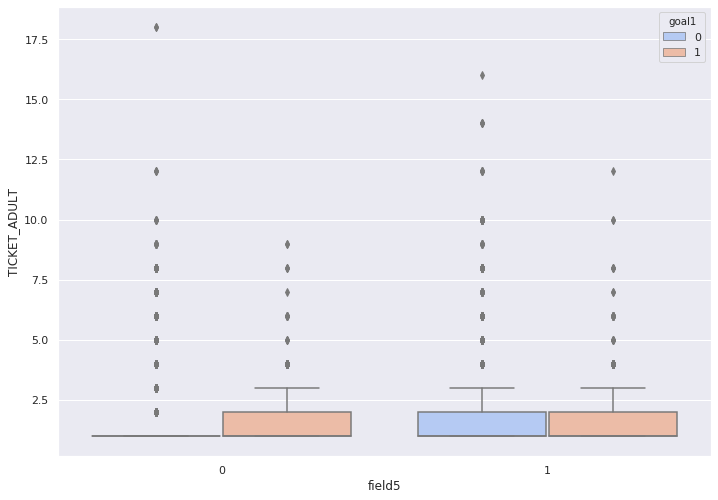

In [0]:
colab_img_path = '/content/drive/My Drive/images_ottrip/'
fig, ax = plt.subplots()
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.boxplot(x='field5', y="TICKET_ADULT", hue="goal1", data=df, palette="coolwarm")

# fig.savefig( os.path.join(colab_img_path, "HOUR_DEPART__field25.png"), dpi=150) #.query("YEAR==1")

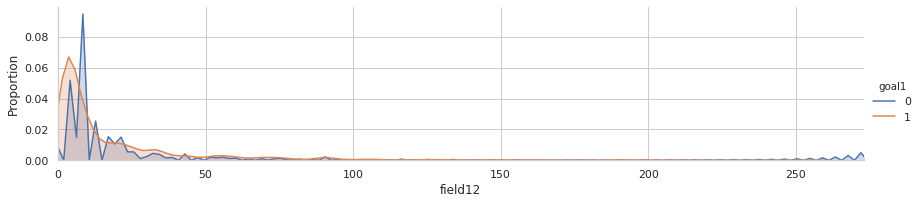

In [0]:
sns.set_style("whitegrid")
plotOne = sns.FacetGrid(df, hue="goal1",aspect=4)
plotOne.map(sns.kdeplot,'field12',shade=True)
plotOne.set(xlim=(0, df['field12'].max()))
plotOne.add_legend()
plotOne.set_axis_labels('field12', 'Proportion')
# plotOne.fig.suptitle('Размер кредитного лимита vs просрочка (Blue = хорошие; Orange = просроченные)');

# Features Selection

In [0]:
df_t

,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,goal21,goal22,goal23,goal24,goal25,goal1,USR_CNT,INDICATOR_CNT,WEEKS_BEFORE_DEPART,NDAYS_LAST_NEXT,TODAY,DIFF_HOUR_DEPART&HOUR_OF_BUY,DIFF_MONTH_DEPART&MONTH_OF_BUY,NUM_MONTH_DEPART,NUM_MONTH_BUY,DIFF_NUM_MONTH,DIFF_MONTH_DEPART&MONTH_OF_BUY_norm,DIFF_HOUR_DEPART&HOUR_OF_BUY_norm,DIFF_NUM_MONTH_norm,CHILD,field1_field14,field26_field27,field12_sem,field13_sem,DAYS_BEFORE_DEPART_sem,field22_sem,field25_sem,field26_sem,...,FIELD13_sum,FIELD13_amin,FIELD13_amax,field17_0.0,field17_0.5,field17_0.75,field17_1.0,FIELD17_median,FIELD17_std,FIELD17_mean,FIELD17_sum,FIELD17_amin,FIELD17_amax,DAYS_BEFORE_DEPART_0.0,DAYS_BEFORE_DEPART_0.25,DAYS_BEFORE_DEPART_0.5,DAYS_BEFORE_DEPART_0.75,DAYS_BEFORE_DEPART_1.0,DAYS_BEFORE_DEPART_median,DAYS_BEFORE_DEPART_std,DAYS_BEFORE_DEPART_mean,DAYS_BEFORE_DEPART_sum,DAYS_BEFORE_DEPART_amin,DAYS_BEFORE_DEPART_amax,field22_0.0,field22_0.25,field22_0.5,field22_0.75,field22_1.0,FIELD22_median,FIELD22_std,FIELD22_mean,FIELD22_sum,FIELD22_amin,FIELD22_amax,field25_0.0,field25_0.25,field25_0.5,field25_0.75,field25_1.0,FIELD25_median,FIELD25_std,FIELD25_mean,FIELD25_sum,FIELD25_amin,FIELD25_amax,field26_0.25,field26_0.5,field26_0.75,field26_1.0,FIELD26_median,FIELD26_std,FIELD26_mean,FIELD26_sum,FIELD26_amax,userid_unique_cnt,userid_cnt,CHILD_sum,INDICATOR21_AGG_norm,INDICATOR22_AGG_norm,INDICATOR23_AGG_norm,INDICATOR24_AGG_norm,INDICATOR25_AGG_norm,WEEKEND_BUY,WEEKEND_DEPART
0,0,7458,0,-0.626508,10,11,1,1,0,1,1,0,0,9,5,20,-0.661308,1,4,1,3,1,0,1,1,15,1,1,2,0,0,4,1,1,0,1,1,0,1,0,0,0,0,1,0.799805,0.571429,4,0,6,1,12,11,1,1,6,1,0,106,20,1.872157,3.524092,1.574194,7.935838,0.820080,0.289396,...,90020.0,0,643,0.0,1.0,1.0,146.0,1,9.125214,3.105148,9952,0,146,0.0,2.0,7.0,24.00,206.0,7.0,26.173176,18.537910,59414.0,0,206,0.0,1.0,17.0,42.0,749.0,17.0,74.896983,41.338846,132491.0,0,749,0.0,1.0,1.0,1.0,124.0,1.0,11.985424,5.058970,16214,0,124,1.0,2.0,5.0,26.0,2.0,4.101000,3.879563,12434.0,26,2992,3205,329.0,1.068850,1.071190,0.399064,0.718917,0.674131,0,0
1,1,33232,144,-0.393794,4,6,2,0,0,0,1,0,0,21,125,3,-0.101043,1,57,1,4,1,5,0,121,15,1,41,3,0,0,2,1,1,0,1,0,0,0,0,0,0,0,2,0.600098,8.142858,201,0,-6,2,-5,-7,2,2,-6,2,0,69,21,3.741123,9.664651,2.957837,8.372785,1.567783,0.673665,...,17468.0,1,591,1.0,1.0,1.0,111.0,1,9.834919,3.685121,2130,1,111,0.0,2.0,6.0,20.75,179.0,6.0,29.477629,19.072664,11024.0,0,179,1.0,1.0,16.0,42.0,824.0,16.0,68.611669,37.306228,21563.0,1,824,1.0,1.0,1.0,1.0,162.0,1.0,13.742570,5.326990,3079,1,162,1.0,5.0,12.0,21.0,5.0,4.857041,5.956747,3443.0,21,532,578,97.0,1.054511,1.071429,0.430451,0.616541,0.595865,0,1
2,2,83136,134,-0.548937,1,2,2,0,0,1,1,0,1,7,4,3,-0.661308,1,4,1,1,3,5,0,17,14,1,1,11,6,0,1,1,1,0,1,1,0,0,0,0,0,0,2,0.799805,0.571429,138,0,7,1,-9,-10,1,1,7,1,0,95,1,2.160247,11.717142,2.322389,12.918565,2.187500,1.077105,...,20137.0,1,551,1.0,1.0,1.0,94.0,1,7.553243,2.788190,2172,1,94,0.0,2.0,4.0,12.00,87.0,4.0,13.635755,9.703466,7559.0,0,87,1.0,1.0,14.0,28.0,634.0,14.0,59.793174,32.605905,25400.0,1,634,1.0,1.0,1.0,1.0,135.0,1.0,10.850125,4.078306,3177,1,135,1.0,5.0,12.0,26.0,5.0,4.765860,5.599487,4362.0,26,682,779,78.0,1.136364,1.142229,0.363636,0.623167,0.623167,0,1
3,3,1583,0,-0.238651,9,10,1,1,3,0,1,0,0,19,12,3,-0.521242,2,22,1,2,3,3,1,46,12,2,18,1,0,0,4,1,1,0,1,1,0,0,0,0,0,0,3,0.799805,3.142857,22,0,-7,1,11,10,1,1,-7,1,0,44,10,0.926200,3.065018,2.001008,4.536885,0.557683,0.264135,...,82803.0,0,644,0.0,1.0,1.0,147.0,1,8.329331,2.728277,9137,0,147,0.0,2.0,4.0,14.00,161.0,4.0,16.999398,11.343685,37990.0,0,161,0.0,1.0,16.0,34.0,742.0,16.0,66.732290,35.307256,118244.0,0,742,0.0,1.0,1.0,1.0,153.0,1.0

In [0]:
# set default parameters for 1st round training
params = {'boosting': 'gbdt',
          'objective':'binary',
          'metric': 'auc',
          'learning_rate': 0.01, # 0.003! #0.005 #0.006 
          'num_leaves': 110, #110 #100 #150 large, but over-fitting
          'max_bin': 66,  #60 #50 # large,but slower,over-fitting
          'max_depth': 10, # deal with over-fitting
          'min_data_in_leaf': 30, # deal with over-fitting
          'min_child_samples': 20,
          'feature_fraction': 0.5,#0.5 #0.6 #0.8
          'bagging_fraction': 0.8,
          'bagging_freq': 40,#5  
          'bagging_seed': 11,
          'lambda_l1': 2,#1.3! #5 #1.2 #1
          'lambda_l2': 0.1 #0.1
         }

In [0]:
categorical_feats = bin_cols+to_ohe+indicator_cols+['WEEKEND_BUY', 'WEEKEND_DEPART']

train = X
target = Y

In [0]:
nfolds = 5
nrepeats = 2 
folds = RepeatedKFold(n_splits=nfolds, n_repeats=nrepeats, random_state=11)
fold_pred = np.zeros(len(train))
feature_importance_df = pd.DataFrame()
lgb_preds = np.zeros(len(X_test))

for fold_, (trn_idx, val_idx) in enumerate(folds.split(train.values,target.values)):
    print("fold n°{}".format(fold_))
    trn_data = lgb.Dataset(train.iloc[trn_idx], label=target.iloc[trn_idx], categorical_feature=categorical_feats)
    val_data = lgb.Dataset(train.iloc[val_idx], label=target.iloc[val_idx], categorical_feature=categorical_feats)

    iteration = 2000
    lgb_m = lgb.train(params, trn_data, iteration, valid_sets = [trn_data, val_data], verbose_eval=100, early_stopping_rounds = 100)
    fold_pred[val_idx] = lgb_m.predict(train.iloc[val_idx], num_iteration=lgb_m.best_iteration)
    
    fold_importance_df = pd.DataFrame()
    fold_importance_df["feature"] = train.columns
    fold_importance_df["importance"] = lgb_m.feature_importance()
    fold_importance_df["fold"] = fold_ + 1
    feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)
    
    lgb_preds += lgb_m.predict(X_test, num_iteration=lgb_m.best_iteration) / (nfolds*nrepeats)

print("CV score: {:<8.5f}".format(eval_auc(target, fold_pred[:, 1])))

fold n°0
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.826139	valid_1's auc: 0.672303
[200]	training's auc: 0.872948	valid_1's auc: 0.67725
[300]	training's auc: 0.908327	valid_1's auc: 0.678158
Early stopping, best iteration is:
[299]	training's auc: 0.907956	valid_1's auc: 0.678232
fold n°1
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.82438	valid_1's auc: 0.681406
[200]	training's auc: 0.871173	valid_1's auc: 0.685746
[300]	training's auc: 0.906815	valid_1's auc: 0.686529
Early stopping, best iteration is:
[270]	training's auc: 0.896933	valid_1's auc: 0.686781
fold n°2
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.814434	valid_1's auc: 0.688698
[200]	training's auc: 0.868822	valid_1's auc: 0.694577
[300]	training's auc: 0.903965	valid_1's auc: 0.69663
[400]	training's auc: 0.931441	valid_1's auc: 0.699517
Early stopping, best iteration is:
[394]	training's auc: 

IndexError: ignored

In [5]:
# pip install eli5

## ELI5

In [0]:
from IPython.display import display_html
import eli5

Using TensorFlow backend.


In [0]:
X_train[feats]

,field12,DAYS_BEFORE_DEPART,field14,field6,field1_field14,DAYS_BEFORE_DEPART_sem,field25_sem,USR_CNT,field22,field13_sem,field22_sem,field12_sem,field26_sem,DIFF_HOUR_DEPART&HOUR_OF_BUY,field13,field10,HOUR_OF_BUY,field25,NDAYS_LAST_NEXT,HOUR_DEPART,field22_1.0,INDICATOR23_AGG_norm,field1,INDICATOR25_AGG_norm,DOW_BUY,field17,field19,field25_1.0,field26_field27,DAYS_BEFORE_DEPART_1.0,field17_1.0,FIELD26_std,INDICATOR21_AGG_norm,DAYS_BEFORE_DEPART_sum,field13_1.0,NDAYS_FROM_LAST,field12_1.0,DAYS_BEFORE_DEPART_std,FIELD12_std,field26,FIELD25_std,FIELD13_std,FIELD17_std,NDAYS_FROM_LAST_1.0,FIELD26_mean,FIELD17_mean,NDAYS_FROM_LAST_sum,INDICATOR22_AGG_norm,DAYS_BEFORE_DEPART_mean,FIELD22_mean,FIELD13_mean,FIELD26_sum,INDICATOR24_AGG_norm,FIELD25_mean,INDICATOR_CNT,FIELD22_std,TICKET_CHILD_4Y,field7,FIELD13_sum,CHILD_sum,FIELD12_sum,field13_0.75,FIELD12_mean,indicator_goal24,indicator_goal23,ORDER_OF_BUY,NDAYS_FROM_LAST_std,field27,TOTAL_TICKETS,TICKET_ADULT,FIELD22_sum,FIELD25_sum,DIFF_MONTH_DEPART&MONTH_OF_BUY,NDAYS_FROM_LAST_mean,DOW_DEPART,FIELD17_sum,DAYS_BEFORE_DEPART_0.75,field26_1.0,indicator_goal25,MONTH_BUY,userid_unique_cnt,field12_0.75,field8,NDAYS_FROM_LAST_0.5,MONTH_DEPART,TICKET_CHILD_1Y,field22_0.75,indicator_goal22,NUM_MONTH_DEPART,NDAYS_FROM_LAST_0.25
184515,5,2,0.319156,0,23,1.551039,1.082341,2,9,2.738244,6.037093,1.398093,0.256486,1,3,0,17,1,2,18,774.0,0.422229,-0.083509,0.742443,4,1,2,138.0,21,270.0,101.0,3.517966,1.039673,34981.0,463.0,0,165.0,15.894181,16.543629,3,10.456502,46.192238,6.989269,117.0,2.704710,2.634662,4841.0,0.986461,10.561896,35.773853,22.881341,8958.0,0.738980,4.488829,0.600098,68.998461,0,1,75783.0,437.0,34342.0,20.0,10.368961,0,0,1,6.073275,0,1,1,118483.0,14867,0,1.461655,6,8726,14.25,26.0,1,6,3176,9.0,1,0.0,6,0,41.0,1,7,0.0
76833,4,57,-0.241109,0,162,1.751868,0.786323,1,1,3.153880,3.521344,1.343358,0.312483,21,2,1,0,1,57,21,840.0,0.384150,0.149205,0.710512,2,1,2,145.0,21,235.0,119.0,3.753307,1.044579,53685.0,624.0,0,269.0,17.707036,18.175557,3,11.643353,51.445004,8.291675,91.0,3.026716,3.005238,13703.0,1.033021,14.061027,39.049240,25.056050,11556.0,0.714364,5.384756,0.799805,71.464325,0,1,95664.0,533.0,42169.0,26.0,11.044788,1,0,1,11.181713,0,2,2,149090.0,20559,1,3.589052,2,11474,19.00,26.0,1,6,3634,9.0,1,0.0,7,0,46.0,1,8,0.0
38145,19,17,0.179090,0,22,1.832997,0.788625,1,20,2.045636,4.590230,0.892014,0.362587,0,63,0,9,1,17,9,752.0,0.402914,-0.083509,0.736341,4,1,1,131.0,10,284.0,98.0,3.712061,1.043430,43004.0,635.0,0,248.0,22.241451,17.737592,1,10.467377,46.904299,6.890550,56.0,2.804754,2.520566,5665.0,0.978986,11.486111,33.609776,23.586806,10501.0,0.758476,4.511752,0.799805,60.529309,0,1,88309.0,500.0,39089.0,26.0,10.440438,1,1,1,5.772177,0,2,1,125835.0,16892,1,1.513088,0,9437,13.00,26.0,0,5,3569,9.0,1,0.0,6,1,36.0,1,7,0.0
118724,19,24,-0.101043,0,56,2.098715,0.596085,1,21,4.119663,3.454171,1.078204,0.382201,-8,4,0,18,1,24,10,674.0,0.385934,-0.316223,0.709387,5,1,1,116.0,10,288.0,128.0,3.531500,1.044173,35942.0,667.0,0,245.0,15.935085,18.132121,1,10.017935,53.875184,8.243812,58.0,2.705622,2.761839,6340.0,0.996222,9.953475,34.508169,25.307394,9770.0,0.723627,4.243977,0.799805,61.012225,0,1,91385.0,528.0,37445.0,25.0,10.369704,1,0,1,6.353802,0,1,1,124609.0,15325,1,1.755746,1,9973,12.00,22.0,1,5,3441,9.0,1,0.0,6,0,41.0,1,7,0.0
159503,5,5,-0.241109,0,70,1.081025,0.609913,3,1,4.318117,3.884230,0.997205,0.215721,-8,26,0,11,1,8,3,764.0,0.398905,-0.393794,0.716058,2,1,2,118.0,21,339.0,108.0,3.717177,1.045255,49590.0,624.0,3,177.0,23.747814,18.143854,3,11.307583,53.895603,7.660278,108.0,3.289391,2.920696,12125.0,1.041971,17.248696,40.331130,26.910957,9457.0,0.785766,5.042783,0.799805,73.468551,0,1,77369.0,297.0,34395.0,26.0,11.963478,1,0,3,14.190389,0,1,1,115952.0,14498,1,4.217391,0,8397,24.00,22.0,1,7,2740,12.0,1,0.0,8,0,46.0,1,9,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

In [0]:
params = {#'num_leaves': 31, # number of leaves in full tree (31 by default) 
         'learning_rate': 0.01, #this determines the impact of each tree on the final outcome. 

         'min_data_in_leaf': 50,
         'min_sum_hessian_in_leaf': 12.0,
         'objective': 'binary', 
         'max_depth': -1,
         'boosting': 'gbdt', #'dart' 
         'bagging_freq': 5,
         'bagging_fraction': 0.81,
         'boost_from_average':'false',
         'bagging_seed': 17,
         'metric': 'auc',
         'verbosity': -1,
         }
y = Y.copy()


folds = StratifiedKFold(n_splits=5, shuffle=True, random_state=SEED)
oof = np.zeros(len(X))
# prediction = np.zeros(len(X_test))
scores = []
feature_importance = pd.DataFrame()
for fold_n, (train_index, valid_index) in enumerate(folds.split(X, y)):
    print('Fold', fold_n, 'started at', time.ctime())
    X_train, X_valid = X.iloc[train_index], X.iloc[valid_index]
    y_train, y_valid = y.iloc[train_index], y.iloc[valid_index]
    
    model = LGBMClassifier(**params_, n_estimators = 2000, nthread = 5, n_jobs = -1)
    model.fit(X_train, y_train, 
              eval_set=[(X_train, y_train), (X_valid, y_valid)], eval_metric='auc',
              verbose=200, early_stopping_rounds=200)
            
    y_pred_valid = model.predict_proba(X_valid)[:, 1]
#     y_pred = model.predict_proba(X_test, num_iteration=model.best_iteration_)[:, 1]
        
    oof[valid_index] = y_pred_valid.reshape(-1,)
    scores.append(roc_auc_score(y_valid, y_pred_valid))
#     prediction += y_pred    
    
    # feature importance
    fold_importance = pd.DataFrame()
    fold_importance["feature"] = X.columns
    fold_importance["importance"] = model.feature_importances_
    fold_importance["fold"] = fold_n + 1
    feature_importance = pd.concat([feature_importance, fold_importance], axis=0)


Fold 0 started at Sat Jan 11 21:42:14 2020
Training until validation scores don't improve for 200 rounds.
[200]	training's auc: 0.864048	valid_1's auc: 0.694837
[400]	training's auc: 0.914551	valid_1's auc: 0.698055
Early stopping, best iteration is:
[391]	training's auc: 0.913405	valid_1's auc: 0.698285
Fold 1 started at Sat Jan 11 21:42:44 2020
Training until validation scores don't improve for 200 rounds.
[200]	training's auc: 0.859377	valid_1's auc: 0.706702
[400]	training's auc: 0.915114	valid_1's auc: 0.7136
[600]	training's auc: 0.940089	valid_1's auc: 0.715394
Early stopping, best iteration is:
[559]	training's auc: 0.935889	valid_1's auc: 0.716251
Fold 2 started at Sat Jan 11 21:43:21 2020
Training until validation scores don't improve for 200 rounds.
[200]	training's auc: 0.861626	valid_1's auc: 0.692659
[400]	training's auc: 0.915125	valid_1's auc: 0.69865
[600]	training's auc: 0.943858	valid_1's auc: 0.698751
Early stopping, best iteration is:
[480]	training's auc: 0.928075

In [0]:
feats=feature_importance.groupby('feature')['importance'].sum().reset_index()\
                  .sort_values(by='importance', ascending=0).query("importance>100").feature.values.tolist()
print(feats, ',')

['field12', 'DAYS_BEFORE_DEPART', 'field6', 'field22', 'USR_CNT', 'NDAYS_LAST_NEXT', 'field13', 'FIELD26_std_MD_f1&f14', 'field14', 'field10', 'NDAYS_FROM_LAST_std_MD_f1&f14', 'DAYS_BEFORE_DEPART_amax_MD_f1&f14', 'NDAYS_FROM_LAST_mean_MD_f1&f14', 'FIELD12_std_MD_f1&f14', 'NDAYS_FROM_LAST', 'FIELD22_std_MD_f1&f14', 'DIFF_HOUR_DEPART&HOUR_OF_BUY', 'FIELD22_amax_MD_f1&f14', 'HOUR_OF_BUY', 'FIELD26_mean_MD_f1&f14', 'field25', 'field1_field14', 'field12_sem_HOUR_OF_BUY', 'FIELD13_amax_MD_f1&f14', 'DAYS_BEFORE_DEPART_std_MD_f1&f14', 'DOW_BUY', 'FIELD12_amax_MD_f1&f14', 'FIELD25_amax_MD_f1&f14', 'FIELD22_amax_HD', 'FIELD17_amax_MD_f1&f14', 'FIELD13_std_MD_f1&f14', 'FIELD13_mean_MD_f1&f14', 'field17', 'FIELD25_std_MD_f1&f14', 'FIELD17_mean_MD_f1&f14', 'field19', 'FIELD12_mean_MD_f1&f14', 'NUM_MONTH_DEPART', 'FIELD17_std_MD_f1&f14', 'FIELD12_median_MD_f1&f14', 'NDAYS_FROM_LAST_amax_MD_f1&f14', 'field13_sem_HOUR_OF_BUY', 'FIELD25_mean_MD_f1&f14', 'ORDER_OF_BUY', 'DAYS_BEFORE_DEPART_sem_HOUR_OF_B

In [0]:
eli5.show_weights(estimator=model, feature_names=X.columns.tolist(), top=90, show_feature_values=True, feature_filter=lambda x: x != '<BIAS>')

Weight,Feature
0.0675,DAYS_BEFORE_DEPART
0.0535,field12
0.0444,DAYS_BEFORE_DEPART_id_median
0.0389,field1_field14
0.0334,field22
0.0334,NDAYS_FROM_LAST_id_median
0.0303,f14_id_median
0.0300,HOUR_OF_BUY
0.0287,f1_id_median
0.0279,DIFF_H


In [0]:
eli5.show_prediction(model, doc=X.values[3], feature_names=X_test.columns.tolist(), top=40, show_feature_values=True)

In [0]:
stat_cols = df.filter(regex='0.0|0.25|0.5|0.75|1.0|median|std|mean|sum|amin|amax|cnt').columns.tolist()

to_log = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field6', 'field12', 'field13', 'DAYS_BEFORE_DEPART', 'field17', 
          'field22', 'field25', 'WEEKS_BEFORE_DEPART', 'NDAYS_LAST_NEXT', 'CHILD', 'field1_field14', 'field26_field27', 'USR_CNT']

to_ohe = ['MONTH_BUY', 'MONTH_DEPART', 'HOUR_OF_BUY', 'DOW_BUY', 'DOW_DEPART', 'HOUR_DEPART', 'field27']

to_drop = ['orderid', 'userid', 'QUARTER', 'DIFF_HOUR_DEPART&HOUR_OF_BUY', 'DIFF_MONTH_DEPART&MONTH_OF_BUY', 
           'NUM_MONTH_DEPART', 'NUM_MONTH_BUY', 'DIFF_NUM_MONTH']

to_scale = ['TOTAL_TICKETS', 'TICKET_CHILD_1Y', 'TICKET_ADULT', 'field19', 'field26', 'TICKET_CHILD_4Y'] + stat_cols

bin_cols = ['TODAY', 'field10', 'field8', 'field7', 'field5']

## Variable Score df

In [0]:
features = df.drop(['orderid', 'userid', 'goal1']+goals_cols, axis=1).copy()
labels = df.goal1.values

In [0]:
clf = LGBMClassifier(random_state=SEED)
clf.fit(features,labels)
lgbm_imp = pd.DataFrame(clf.feature_importances_, columns = ['LGBMC'], index=features.columns)\
                  .reset_index().sort_values(['LGBMC'],ascending=0)
lgbm_imp

,index,LGBMC
12,field12,142
53,DAYS_BEFORE_DEPART_sem,128
16,DAYS_BEFORE_DEPART,109
51,field12_sem,107
55,field25_sem,101
...,...,...
114,FIELD22_median,0
87,FIELD13_amax,0
118,FIELD22_amin,0
119,FIELD22_amax,0


In [0]:
lgbm_imp.query('LGBMC > 0')[:30]

,index,LGBMC
12,field12,142
53,DAYS_BEFORE_DEPART_sem,128
16,DAYS_BEFORE_DEPART,109
51,field12_sem,107
55,field25_sem,101
54,field22_sem,92
35,USR_CNT,90
22,field22,90
49,field1_field14,89
40,DIFF_HOUR_DEPART&HOUR_OF_BUY,87


In [0]:
# Recursive Feature Elimination

rfe = RFE(RandomFore(), 20) #LogisticRegression
fit = rfe.fit(features, labels)

rfe_df = pd.DataFrame(rfe.support_, columns = ["RFE"], index=features.columns)\
                 .reset_index().query("RFE == True")
rfe_df

In [0]:
# Variable Importance - Extratrees Classifier

model = ExtraTreesClassifier()
model.fit(features, labels)
ET_imp = pd.DataFrame(model.feature_importances_, columns = ["Extratrees"], index=features.columns)\
              .reset_index().sort_values(['Extratrees'],ascending=0)
ET_imp

,index,Extratrees
7,hour_of_buy,0.066711
12,days_before_depart,0.064863
18,hour_depart,0.063568
8,field12,0.062120
1,field1,0.056269
10,field14,0.054830
17,field22,0.054335
9,field13,0.053413
25,usr_cnt,0.051613
14,dow_buy,0.051457


In [0]:
# Chi Square

print(np.intersect1d(cat_cols, mult_feat))
features1=df[np.intersect1d(cat_cols, mult_feat)]

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

model = SelectKBest(score_func=chi2, k=5)
fit = model.fit(features1, labels)

# pd.options.display.float_format = '{:.2f}'.format
chi_sq = pd.DataFrame(fit.scores_, columns = ["Chi_Square"], index=features1.columns)\
            .reset_index().sort_values('Chi_Square',ascending=0)

chi_sq

['dow_buy' 'dow_depart' 'field27' 'hour_depart' 'month_buy' 'month_depart'
 'quarter' 'ticket_child_1y']


,index,Chi_Square
4,month_buy,5.489848
2,field27,3.636424
0,dow_buy,3.600194
7,ticket_child_1y,2.547646
6,quarter,1.030440
3,hour_depart,0.838608
5,month_depart,0.082845
1,dow_depart,0.076783


In [0]:
from sklearn.svm import LinearSVC
from sklearn.feature_selection import SelectFromModel

lsvc = LinearSVC(C=0.01, penalty="l1", dual=False).fit(features, labels)
model = SelectFromModel(lsvc,prefit=True)
l1 = pd.DataFrame(model.get_support(), columns = ["L1"], index=features.columns)\
          .reset_index().query("L1 == True")

l1

,index,L1
0,ndays_from_last,True
2,month_buy,True
3,month_depart,True
4,order_of_buy,True
5,field6,True
7,hour_of_buy,True
8,field12,True
9,field13,True
10,field14,True
12,days_before_depart,True


In [0]:
# Combine all together IV.rename(columns={"VAR_NAME": "index"}, inplace=True)

from functools import reduce
dfs = [IV, lgbm_imp, rfe_df, ET_imp, l1, vif] #chi_sq, 
final_results = reduce(lambda left,right: pd.merge(left,right,on='index'), dfs)
final_results

,index,IV,LGBMC,RFE,Extratrees,L1,VIF
0,days_before_depart,0.200347,270,True,0.064863,True,1.529175
1,dow_buy,0.000720,90,True,0.051457,True,4.474880
2,dow_depart,0.000001,109,True,0.049244,True,4.685522
3,field12,0.021881,255,True,0.062120,True,2.205078
4,field14,0.079120,167,True,0.054830,True,4.389568
5,field17,0.026000,56,True,0.018251,True,2.108471
6,field19,0.000001,78,True,0.042081,True,4.983007
7,field25,0.074422,82,True,0.025043,True,2.147651
8,field26,0.003591,94,True,0.037123,True,4.443103
9,field6,0.034297,122,True,0.034600,True,1.279032


In [0]:
# Variable Score

columns = final_results.select_dtypes(exclude='bool').columns.difference(['index'])

score_table = pd.DataFrame({},[])
score_table['index'] = final_results['index']

for i in columns:
    score_table[i] = final_results['index'].isin(list(final_results.nlargest(5,i)['index'])).astype(int)
    
score_table['RFE'] = final_results['RFE'].astype(int)
score_table['L1'] = final_results['L1'].astype(int)
score_table['final_score'] = score_table.sum(axis=1)
score_table.sort_values('final_score', ascending=0, inplace=True)
score_table

,index,Extratrees,IV,LGBMC,VIF,RFE,L1,final_score
0,days_before_depart,1,1,1,0,1,1,5
4,field14,1,1,1,0,1,1,5
1,dow_buy,1,0,0,1,1,1,4
3,field12,1,0,1,0,1,1,4
9,field6,0,1,1,0,1,1,4
14,usr_cnt,1,0,1,0,1,1,4
2,dow_depart,0,0,0,1,1,1,3
5,field17,0,1,0,0,1,1,3
6,field19,0,0,0,1,1,1,3
7,field25,0,1,0,0,1,1,3


In [0]:
# VIF (Addon)
from statsmodels.stats.outliers_influence import variance_inflation_factor

def calculate_vif(features):
    vif = pd.DataFrame()
    vif["index"] = features.columns
    vif["VIF"] = [variance_inflation_factor(features.values, i) for i in range(features.shape[1])]    
    return(vif)

vif = calculate_vif(features)
while vif['VIF'][vif['VIF'] > 10].any():
    remove = vif.sort_values('VIF',ascending=0)['Features'][:1]
    features.drop(remove,axis=1,inplace=True)
    vif = calculate_vif(features)
vif.nlargest(4, 'VIF')

,index,VIF
6,hour_of_buy,6.731196
2,month_depart,6.613392
17,ticket_adult,6.558774
20,field27,6.206836


In [0]:
868+868+868+868+869

4341

In [0]:
4341/10

434.1

In [0]:
df_sort = df_copy.copy().sort_values(by=["YEAR", 'MONTH_DEPART', 'DOW_DEPART', 'HOUR_DEPART', 'ORDER_OF_BUY'])

In [0]:
df_sort.head()

,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,goal21,goal22,goal23,goal24,goal25,goal1,USR_CNT,INDICATOR_CNT
16866,16866,22737,57,-0.471365,1,1,2,0,4,1,0,0,0,13,8,3,-0.381176,1,6,1,2,2,1,0,17,0,1,1,12,3,0,1,1,1,1,0,1,0,0,0,0,0,0,7,0.799805
26428,26428,95186,51,-0.393794,1,1,2,0,0,0,1,0,0,2,8,3,-0.241109,1,7,1,2,3,1,0,43,0,1,16,5,3,0,1,1,1,1,0,1,0,0,0,0,0,0,2,0.799805
57514,57514,31764,184,-0.083509,1,1,2,0,0,0,1,0,1,17,9,3,0.319156,1,5,1,3,2,1,0,43,0,1,16,12,3,0,1,1,1,1,1,0,0,0,0,0,0,0,3,0.799805
89667,89667,11024,20,0.149205,1,1,2,0,0,1,1,0,1,20,8,3,-0.241109,2,5,1,3,3,1,0,23,0,2,1,1,1,0,1,1,1,1,0,0,0,0,0,0,0,0,2,0.600098
99980,99980,79904,150,-0.626508,1,1,2,0,0,1,1,0,0,17,8,3,-0.661308,1,2,1,6,3,1,0,8,0,1,1,1,1,0,1,1,1,1,0,1,0,1,0,0,0,0,2,0.799805


# TimeSplit

In [0]:
def run_timesplit(df, NUM_TIME_SPLITS = 5):
  df_sort = df.copy().sort_values(by=["YEAR", 'MONTH_DEPART', 'DOW_DEPART', 'HOUR_DEPART', 'ORDER_OF_BUY'])

  ind_array = []
  for i in np.array_split(df_sort.query('goal1==1').index.values, NUM_TIME_SPLITS):
     ind_array.append(i[-1])
    #  print(len(i))

  start = 0
  train = df_sort.ix[:ind_array[0]]
  X_cols = df_sort.columns.difference(['userid', 'orderid', 'QUARTER', 'goal1']+goals_cols)
  Y_col = 'goal1'
  scores = []
  print(len(X_cols))
  for i in range(NUM_TIME_SPLITS-1):
      
      test = df_sort.ix[ind_array[i] : ind_array[i+1]].iloc[1:]
      
      clf = LGBMClassifier(**params_, random_state=SEED, n_estimators = 2000, nthread = 5, n_jobs = -1)
      clf.fit(train[X_cols], train[Y_col], 
                eval_set=[(train[X_cols], train[Y_col]), (test[X_cols], test[Y_col])], eval_metric='auc',
                verbose=200, early_stopping_rounds=200)

      y_pred = clf.predict_proba(test[X_cols])[:, 1]
      scores.append(roc_auc_score(test[Y_col], y_pred))

      train = test.copy()
  
  print(mean(scores))

In [0]:
run_timesplit(df=df, NUM_TIME_SPLITS = 5)

329
Training until validation scores don't improve for 200 rounds.
[200]	valid_0's auc: 0.976444	valid_1's auc: 0.616292
Early stopping, best iteration is:
[43]	valid_0's auc: 0.90217	valid_1's auc: 0.617441
Training until validation scores don't improve for 200 rounds.
[200]	valid_0's auc: 0.967111	valid_1's auc: 0.614554
Early stopping, best iteration is:
[176]	valid_0's auc: 0.961454	valid_1's auc: 0.615692
Training until validation scores don't improve for 200 rounds.
[200]	valid_0's auc: 0.97412	valid_1's auc: 0.630609
[400]	valid_0's auc: 0.994187	valid_1's auc: 0.6285
Early stopping, best iteration is:
[276]	valid_0's auc: 0.98497	valid_1's auc: 0.632918
Training until validation scores don't improve for 200 rounds.
[200]	valid_0's auc: 0.967395	valid_1's auc: 0.681084
[400]	valid_0's auc: 0.99335	valid_1's auc: 0.671422
Early stopping, best iteration is:
[209]	valid_0's auc: 0.970333	valid_1's auc: 0.681576


0.6369068323212668

In [0]:
scores

[0.6202179337692894,
 0.5949427319593396,
 0.6234932507446553,
 0.6619598904855772]

In [0]:
from sklearn.model_selection import TimeSeriesSplit

tscv = TimeSeriesSplit(n_splits=3)
test_data = Pool(data=X_test)
scores = []
prediction = np.zeros(X_test.shape[0])                 

for n_fold, (train_index, test_index) in enumerate(tscv.split(X)):
     print("Train:", train_index, "Validation:", val_index)
     X_train, X_test = X[train_index], X[val_index]
     y_train, y_test = Y[train_index], Y[val_index]

    train_data = Pool(data=X_train, label=y_train)
    valid_data = Pool(data=X_valid, label=y_valid) # cat_features=cat_features

    model = CatBoostClassifier(**best_params_bayes_goal1, task_type = "GPU", 
                                 od_type='Iter') #, one_hot_max_size=24)

    model.fit(train_data,
              eval_set=valid_data, 
              use_best_model=True )
    
    score = model.get_best_score()['validation_0']['AUC']
    scores.append(score)

    y_pred = model.predict_proba(test_data)[:, 1]
    prediction += y_pred

prediction /= n_fold
print('CV mean: {:.4f}, CV std: {:.4f}'.format(np.mean(scores), np.std(scores)))   

0    0.977858
1    0.022142
Name: goal1, dtype: float64

# Catboost

In [6]:
# !pip install ipywidgets 
# !jupyter nbextension enable --py widgetsnbextension

In [7]:
# !pip install scikit-optimize

In [0]:
from catboost import cv, Pool
from skopt import BayesSearchCV
from skopt.callbacks import DeadlineStopper, VerboseCallback, DeltaXStopper
from skopt.space import Real, Categorical, Integer
from sklearn.metrics import make_scorer

In [0]:
%%time
base_model = CatBoostClassifier(task_type = "GPU",verbose=True)
base_model.fit(X,Y,)

Learning rate set to 0.068788
0:	learn: 0.5763963	total: 14.9ms	remaining: 14.9s
1:	learn: 0.4828237	total: 30.8ms	remaining: 15.4s
2:	learn: 0.4082129	total: 45.6ms	remaining: 15.2s
3:	learn: 0.3490911	total: 59ms	remaining: 14.7s
4:	learn: 0.3021502	total: 71.9ms	remaining: 14.3s
5:	learn: 0.2637207	total: 84.8ms	remaining: 14.1s
6:	learn: 0.2339526	total: 97.8ms	remaining: 13.9s
7:	learn: 0.2094262	total: 111ms	remaining: 13.7s
8:	learn: 0.1902547	total: 124ms	remaining: 13.6s
9:	learn: 0.1748633	total: 137ms	remaining: 13.5s
10:	learn: 0.1625321	total: 150ms	remaining: 13.5s
11:	learn: 0.1524393	total: 163ms	remaining: 13.4s
12:	learn: 0.1440179	total: 175ms	remaining: 13.3s
13:	learn: 0.1369315	total: 186ms	remaining: 13.1s
14:	learn: 0.1313849	total: 197ms	remaining: 12.9s
15:	learn: 0.1267236	total: 207ms	remaining: 12.7s
16:	learn: 0.1229410	total: 220ms	remaining: 12.7s
17:	learn: 0.1197024	total: 230ms	remaining: 12.5s
18:	learn: 0.1171126	total: 239ms	remaining: 12.3s
19:	le

In [0]:
import os
import pandas as pd
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn import metrics
import numpy as np
import pandas as pd
from time import time
import pprint
import joblib
import warnings
warnings.filterwarnings("ignore")

# Classifiers
from catboost import CatBoostClassifier

# Model selection
from sklearn.model_selection import StratifiedKFold

In [0]:
y_pred = base_model.predict_proba(X_test)[:, 1]
valid_score = roc_auc_score(Y_test, y_pred)
print('Validation ROC-AUC score:', valid_score)

Validation ROC-AUC score: 0.6967137931462177


In [0]:
# Reporting util for different optimizers
def report_perf(optimizer, X, y, title, callbacks=None):
    """
    A wrapper for measuring time and performances of different optmizers
    
    optimizer = a sklearn or a skopt optimizer
    X = the training set 
    y = our target
    title = a string label for the experiment
    """
    start = time()
    if callbacks:
        optimizer.fit(X, y, callback=callbacks)
    else:
        optimizer.fit(X, y)
    d=pd.DataFrame(optimizer.cv_results_)
    best_score = optimizer.best_score_
    best_score_std = d.iloc[optimizer.best_index_].std_test_score
    best_params = optimizer.best_params_
    print((title + " took %.2f seconds,  candidates checked: %d, best CV score: %.3f "
           +u"\u00B1"+" %.3f") % (time() - start, 
                                  len(optimizer.cv_results_['params']),
                                  best_score,
                                  best_score_std))    
    print('Best parameters:')
    pprint.pprint(best_params)
    print()
    return best_params

In [0]:
clf = CatBoostClassifier(thread_count=2,
                         loss_function='Logloss',
                        
                         od_type = 'Iter',
                         verbose= False
                        )

In [0]:
# Defining your search space
search_spaces = {'iterations': Integer(10, 1000),
                 'depth': Integer(1, 8),
                 'learning_rate': Real(0.01, 1.0, 'log-uniform'),
                 'random_strength': Real(1e-9, 10, 'log-uniform'),
                 'bagging_temperature': Real(0.0, 1.0),
                 'border_count': Integer(1, 255),
                 'l2_leaf_reg': Integer(2, 30),
                 'scale_pos_weight': Real(0.01, 1.0, 'uniform')}


In [0]:
roc_auc = make_scorer(roc_auc_score, greater_is_better=True, needs_threshold=True)

# Setting up BayesSearchCV
opt = FixedBayesSearchCV(clf,
                    search_spaces,
                    scoring=roc_auc,
                    cv=skf,
                    n_iter=100,
                    n_jobs=1,  # use just 1 job with CatBoost in order to avoid segmentation fault
                    return_train_score=False,
                    refit=True,
                    optimizer_kwargs={'base_estimator': 'GP'},
                    random_state=42)


In [0]:
class FixedBayesSearchCV(BayesSearchCV):
    """
    Dirty hack to avoid compatibility issues with sklearn 0.2 and skopt.
    Credit: https://www.kaggle.com/c/home-credit-default-risk/discussion/64004

    For context, on why the workaround see:
        - https://github.com/scikit-optimize/scikit-optimize/issues/718
        - https://github.com/scikit-optimize/scikit-optimize/issues/762
    """
    def __init__(self, estimator, search_spaces, optimizer_kwargs=None,
                n_iter=50, scoring=None, fit_params=None, n_jobs=1,
                n_points=1, iid=True, refit=True, cv=None, verbose=0,
                pre_dispatch='2*n_jobs', random_state=None,
                error_score='raise', return_train_score=False):
        """
        See: https://github.com/scikit-optimize/scikit-optimize/issues/762#issuecomment-493689266
        """

        # Bug fix: Added this line
        self.fit_params = fit_params

        self.search_spaces = search_spaces
        self.n_iter = n_iter
        self.n_points = n_points
        self.random_state = random_state
        self.optimizer_kwargs = optimizer_kwargs
        self._check_search_space(self.search_spaces)

        # Removed the passing of fit_params to the parent class.
        super(BayesSearchCV, self).__init__(
                estimator=estimator, scoring=scoring, n_jobs=n_jobs, iid=iid,
                refit=refit, cv=cv, verbose=verbose, pre_dispatch=pre_dispatch,
                error_score=error_score, return_train_score=return_train_score)

    def _run_search(self, x):
        raise BaseException('Use newer skopt')

In [0]:
best_params = report_perf(opt, train, targets.goal1,'CatBoost', 
                          callbacks=[VerboseCallback(100), 
                                     DeadlineStopper(60*10)])

Iteration No: 1 started. Searching for the next optimal point.
Iteration No: 1 ended. Search finished for the next optimal point.
Time taken: 355.4234
Function value obtained: -0.6970
Current minimum: -0.6970
Iteration No: 2 started. Searching for the next optimal point.
CatBoost took 393.08 seconds,  candidates checked: 1, best CV score: 0.697 ± 0.008
Best parameters:
{'bagging_temperature': 0.41010395885331385,
 'border_count': 186,
 'depth': 8,
 'iterations': 323,
 'l2_leaf_reg': 21,
 'learning_rate': 0.0673344419215237,
 'random_strength': 3.230824361824754e-06,
 'scale_pos_weight': 0.7421091918485163}



In [0]:
best_params_bayes_goal1={'bagging_temperature': 0.41010395885331385,
                          'border_count': 186,
                          'depth': 8,
                          'iterations': 323,
                          'l2_leaf_reg': 21,
                          'learning_rate': 0.0673344419215237,
                          'random_strength': 3.230824361824754e-06,
                          'scale_pos_weight': 0.7421091918485163}

best_params_bayes_goal1['iterations']=1000                          

In [0]:
%%time
tuned_model = CatBoostClassifier(**best_params_bayes_goal1, task_type = "GPU", 
                                 od_type='Iter') #, one_hot_max_size=24)

tuned_model.fit(X, Y)

0:	learn: 0.5660642	total: 21.7ms	remaining: 21.7s
1:	learn: 0.4672145	total: 42.5ms	remaining: 21.2s
2:	learn: 0.3868832	total: 64ms	remaining: 21.3s
3:	learn: 0.3249986	total: 85ms	remaining: 21.2s
4:	learn: 0.2765279	total: 106ms	remaining: 21s
5:	learn: 0.2379952	total: 126ms	remaining: 20.9s
6:	learn: 0.2077671	total: 148ms	remaining: 20.9s
7:	learn: 0.1840556	total: 168ms	remaining: 20.9s
8:	learn: 0.1651026	total: 185ms	remaining: 20.4s
9:	learn: 0.1497875	total: 201ms	remaining: 19.9s
10:	learn: 0.1376907	total: 216ms	remaining: 19.4s
11:	learn: 0.1278934	total: 235ms	remaining: 19.4s
12:	learn: 0.1199875	total: 251ms	remaining: 19.1s
13:	learn: 0.1134414	total: 267ms	remaining: 18.8s
14:	learn: 0.1080571	total: 282ms	remaining: 18.5s
15:	learn: 0.1035900	total: 297ms	remaining: 18.3s
16:	learn: 0.0998608	total: 314ms	remaining: 18.1s
17:	learn: 0.0969060	total: 329ms	remaining: 17.9s
18:	learn: 0.0944286	total: 345ms	remaining: 17.8s
19:	learn: 0.0923371	total: 360ms	remaining

In [0]:
%%time
y_pred = tuned_model.predict_proba(X_test)[:, 1]
valid_score = roc_auc_score(Y_test, y_pred)
print('Validation ROC-AUC score:', valid_score)
##ROC_AUC is 0.70169, not ohe 0.70304

Validation ROC-AUC score: 0.7006860474205653
CPU times: user 107 ms, sys: 8.74 ms, total: 116 ms
Wall time: 70.9 ms


In [0]:
%%time
# run all train

# tuned_model = CatBoostClassifier(**best_params_bayes_goal1, task_type = "GPU", od_type='Iter')#, one_hot_max_size=24)
# tuned_model.fit(train, targets.goal1)

0:	learn: 0.5660154	total: 23.3ms	remaining: 23.3s
1:	learn: 0.4649401	total: 47.1ms	remaining: 23.5s
2:	learn: 0.3859092	total: 70.3ms	remaining: 23.4s
3:	learn: 0.3238323	total: 92.8ms	remaining: 23.1s
4:	learn: 0.2753121	total: 116ms	remaining: 23.1s
5:	learn: 0.2371732	total: 139ms	remaining: 23s
6:	learn: 0.2072725	total: 162ms	remaining: 23s
7:	learn: 0.1834729	total: 186ms	remaining: 23.1s
8:	learn: 0.1641890	total: 210ms	remaining: 23.1s
9:	learn: 0.1491904	total: 239ms	remaining: 23.6s
10:	learn: 0.1371407	total: 256ms	remaining: 23.1s
11:	learn: 0.1274552	total: 273ms	remaining: 22.5s
12:	learn: 0.1195703	total: 289ms	remaining: 21.9s
13:	learn: 0.1131932	total: 306ms	remaining: 21.5s
14:	learn: 0.1078895	total: 323ms	remaining: 21.2s
15:	learn: 0.1034523	total: 352ms	remaining: 21.7s
16:	learn: 0.0997438	total: 369ms	remaining: 21.4s
17:	learn: 0.0967239	total: 386ms	remaining: 21.1s
18:	learn: 0.0941837	total: 403ms	remaining: 20.8s
19:	learn: 0.0920908	total: 419ms	remaini

In [0]:
submit_predictions_task1('task1_bayes_catboos', tuned_model, test)

Submission saved to submission_task1_bayes_catboos.csv


In [0]:
submit_predictions_task1('DEL_THIS_CHEET', tuned_model, X_test)

Submission saved to submission_DEL_THIS_CHEET.csv


In [0]:
cat_features=['MONTH_BUY', 'MONTH_DEPART', 'field5', 'field7', 'field8', 'field10', 'DOW_BUY', 'DOW_DEPART', 'YEAR', 'HOUR_OF_BUY', 'HOUR_DEPART',
'field27', 'TODAY'] + indicator_cols

cats_indices=[X.columns.get_loc(c) for c in cat_features if c in X]

In [0]:
y_pred = clf.predict_proba(X_test)[:, 1]
fast_auc(Y_test, y_pred)

0.6738319055461549

# H2O

In [8]:
# !pip install -U h2o

In [0]:
import h2o
from h2o.automl import H2OAutoML

In [0]:
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 ..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.5" 2019-10-15; OpenJDK Runtime Environment (build 11.0.5+10-post-Ubuntu-0ubuntu1.118.04); OpenJDK 64-Bit Server VM (build 11.0.5+10-post-Ubuntu-0ubuntu1.118.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.6/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmps62cp_0k
  JVM stdout: /tmp/tmps62cp_0k/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmps62cp_0k/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O cluster uptime:,02 secs
H2O cluster timezone:,Etc/UTC
H2O data parsing timezone:,UTC
H2O cluster version:,3.28.0.1
H2O cluster version age:,"28 days, 13 hours and 53 minutes"
H2O cluster name:,H2O_from_python_unknownUser_8ilpvb
H2O cluster total nodes:,1
H2O cluster free memory:,2.938 Gb
H2O cluster total cores:,2
H2O cluster allowed cores:,2
H2O cluster status:,"accepting new members, healthy"


## subm1_2 0.6825560

In [0]:
drop_cols = ['orderid', 'userid', 'QUARTER', 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27']
# to_drop = ['orderid', 'userid', 'goal21', 'goal22', 'goal23', 'goal24', 'goal25', 'QUARTER']

# df_train, df_test = train_test_split(df, random_state=SEED, stratify=df.goal1)
# df_train.shape, df_test.shape

In [0]:
X_train = df.drop(columns=drop_cols+goals_cols, axis=1)

In [0]:
X_train.shape, X_test.shape

((196056, 66), (455011, 65))

In [0]:
htrain = h2o.H2OFrame(X_train)
htest = h2o.H2OFrame(X_test)
orderid = df_test['orderid']

# htrain = htrain.drop(to_drop, axis =1)
# htest = htest.drop(to_drop, axis =1)

x = htrain.columns
y = 'goal1'
x.remove(y)

htrain[y] = htrain[y].asfactor()

Parse progress: |█████████████████████████████████████████████████████████| 100%
Parse progress: |█████████████████████████████████████████████████████████| 100%


In [0]:
aml = H2OAutoML(max_models=15, balance_classes=True, stopping_metric="AUC",
                stopping_rounds = 3, stopping_tolerance = 1e-2, seed=SEED)

aml.train(x=x, y=y, training_frame=htrain)

AutoML progress: |████████████████████████████████████████████████████████| 100%


In [0]:
lb = aml.leaderboard
lb.head(rows=lb.nrows)  # Print all rows instead of default (10 rows)

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse
StackedEnsemble_AllModels_AutoML_20200113_153325,0.704533,0.100036,0.0744171,0.429055,0.145505,0.0211717
StackedEnsemble_BestOfFamily_AutoML_20200113_153325,0.702621,0.100165,0.0741804,0.414649,0.14553,0.021179
XGBoost_grid__1_AutoML_20200113_153325_model_2,0.699953,0.0997085,0.0763392,0.430716,0.145464,0.0211597
GBM_1_AutoML_20200113_153325,0.685499,0.101463,0.0552478,0.423059,0.146271,0.0213951
XGBoost_2_AutoML_20200113_153325,0.67942,0.102989,0.0628929,0.435765,0.146286,0.0213996
GBM_2_AutoML_20200113_153325,0.678789,0.102074,0.0582974,0.428819,0.146336,0.0214144
XGBoost_1_AutoML_20200113_153325,0.676912,0.103394,0.0632825,0.42962,0.146335,0.0214139
XGBoost_grid__1_AutoML_20200113_153325_model_1,0.674545,0.120558,0.0522682,0.428956,0.151221,0.0228677
GLM_1_AutoML_20200113_153325,0.672412,0.102104,0.0475923,0.43842,0.146486,0.0214583
GBM_3_AutoML_20200113_153325,0.66702,0.103101,0.0540149,0.438568,0.146472,0.0214541


In [0]:
pred = aml.leader.predict(htest)

stackedensemble prediction progress: |████████████████████████████████████| 100%


In [0]:
pred_df = pred.as_data_frame()
pred_res = pred_df.p1
# orderid_df = orderid.as_data_frame()
orderid_df = pd.DataFrame({'orderid': orderid})
res = pd.concat([orderid_df,pred_res],axis=1, ignore_index = True)
res.columns = ['orderid','proba']

In [0]:
colab_path = '/content/drive/My Drive/ottrip_subm/'    
res.to_csv( os.path.join(colab_path, 'subm1_2.csv'), index=False ) # 0.6825560

# h2o.save_model(aml.leader, path="./product_backorders_model_bin")

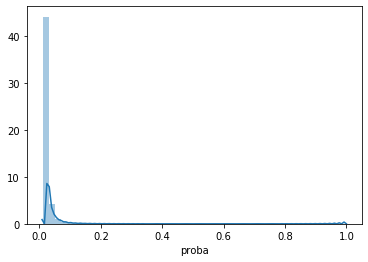

In [0]:
sns.distplot(res.proba) 

## subm1_4 with scale 0.683237

In [0]:
df_scale = df.copy()
df_test_scale = df_test.copy()

drop_cols = ['orderid', 'userid', 'QUARTER']#, 'field1', 'field14', 'TICKET_CHILD_1Y', 'field26', 'field27'] #'indicator_goal21' 'indicator_goal22'
to_scale = ['NDAYS_FROM_LAST', 'ORDER_OF_BUY', 'field12', 'field13', 'field17', 'DAYS_BEFORE_DEPART', 'field22', 'field25', 'field19', 'USR_CNT',
            'field1_field14', 'field26_field27', 'field26']+['field1', 'field14', 'TICKET_CHILD_1Y', 'field27']

transformer = StandardScaler()
transformer.fit(df_scale[to_scale])
df_scale[to_scale] = transformer.transform(df_scale[to_scale])
df_test_scale[to_scale] = transformer.transform(df_test_scale[to_scale])

In [0]:
X_test = df_test_scale.drop(drop_cols, axis=1)
X_train = df_scale.drop(columns=drop_cols+goals_cols, axis=1)
X_train.shape, X_test.shape

((196056, 71), (455011, 70))

In [0]:
htrain = h2o.H2OFrame(X_train)
htest = h2o.H2OFrame(X_test)
orderid = df_test_scale['orderid']

x = htrain.columns
y = 'goal1'
x.remove(y)

htrain[y] = htrain[y].asfactor()

Parse progress: |█████████████████████████████████████████████████████████| 100%
Parse progress: |█████████████████████████████████████████████████████████| 100%


In [0]:
aml = H2OAutoML(max_models=15, balance_classes=True, stopping_metric="AUC",
                stopping_rounds = 3, stopping_tolerance = 1e-2, seed=SEED)

aml.train(x=x, y=y, training_frame=htrain)
pred = aml.leader.predict(htest)

pred_df = pred.as_data_frame()
pred_res = pred_df.p1
orderid_df = pd.DataFrame({'orderid': orderid})
res = pd.concat([orderid_df, pred_res],axis=1, ignore_index = True)
res.columns = ['orderid','proba']

colab_path = '/content/drive/My Drive/ottrip_subm/'    
res.to_csv( os.path.join(colab_path, 'subm1_4_h2o_scale.csv'), index=False )

lb = aml.leaderboard
lb.head(rows=lb.nrows)

AutoML progress: |████████████████████████████████████████████████████████| 100%
stackedensemble prediction progress: |████████████████████████████████████| 100%


model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse
StackedEnsemble_AllModels_AutoML_20200114_084713,0.704925,0.100143,0.0730502,0.430346,0.145613,0.0212031
StackedEnsemble_BestOfFamily_AutoML_20200114_084713,0.704423,0.100232,0.0731552,0.434282,0.145624,0.0212064
XGBoost_grid__1_AutoML_20200114_084713_model_2,0.699319,0.0998209,0.0737297,0.434558,0.145528,0.0211784
GBM_1_AutoML_20200114_084713,0.691802,0.101204,0.0565952,0.440333,0.146225,0.0213817
GBM_2_AutoML_20200114_084713,0.681629,0.102018,0.0558292,0.444491,0.146346,0.0214171
XGBoost_2_AutoML_20200114_084713,0.675848,0.104773,0.0604565,0.43244,0.146701,0.0215211
XGBoost_grid__1_AutoML_20200114_084713_model_1,0.674941,0.120555,0.0518239,0.440926,0.151221,0.0228678
GLM_1_AutoML_20200114_084713,0.672884,0.10201,0.0489539,0.416805,0.146459,0.0214503
GBM_3_AutoML_20200114_084713,0.670487,0.102976,0.0533147,0.44431,0.146477,0.0214556
GBM_grid__1_AutoML_20200114_084713_model_1,0.665708,0.103711,0.0532064,0.43243,0.146704,0.0215219


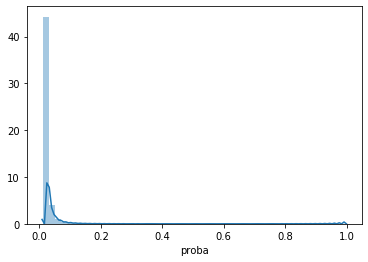

In [0]:
sns.distplot(res.proba);

# NN

In [0]:
import warnings
warnings.filterwarnings("ignore")

import os
import gc
import joblib
import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.model_selection import StratifiedKFold
from sklearn import metrics, preprocessing
from tensorflow.keras import layers
from tensorflow.keras import optimizers
from tensorflow.keras.models import Model, load_model
from tensorflow.keras import callbacks
from tensorflow.keras import backend as K
from tensorflow.keras import utils

In [0]:
def auc(y_true, y_pred):
    def fallback_auc(y_true, y_pred):
        try:
            return metrics.roc_auc_score(y_true, y_pred)
        except:
            return 0.5
    return tf.py_function(fallback_auc, (y_true, y_pred), tf.double)

In [0]:
def create_model(data, catcols):    
    inputs = []
    outputs = []
    for c in catcols:
        num_unique_values = int(data[c].nunique())
        embed_dim = int(min(np.ceil((num_unique_values)/2), 100))
        inp = layers.Input(shape=(1,))
        out = layers.Embedding(num_unique_values + 1, embed_dim, name=c)(inp)
        out = layers.SpatialDropout1D(0.3)(out)
        out = layers.Reshape(target_shape=(embed_dim, ))(out)
        inputs.append(inp)
        outputs.append(out)
    
    x = layers.Concatenate()(outputs)
    x = layers.BatchNormalization()(x)
    
    x = layers.Dense(300, activation="relu")(x)
    x = layers.Dropout(0.3)(x)
    x = layers.BatchNormalization()(x)
    
    x = layers.Dense(300, activation="relu")(x)
    x = layers.Dropout(0.3)(x)
    x = layers.BatchNormalization()(x)
    
    y = layers.Dense(2, activation="softmax")(x)

    model = Model(inputs=inputs, outputs=y)
    return model

In [0]:
# df_new = df.copy()

# features = ['MONTH_BUY', 'MONTH_DEPART', 'field5', 'field6', 'field7', 'field8', 'TICKET_CHILD_1Y', 'field10', 'HOUR_OF_BUY', 
#             'TOTAL_TICKETS', 'DOW_BUY', 'DOW_DEPART', 'YEAR', 'HOUR_DEPART', 'TICKET_ADULT', 'field27', 'TICKET_CHILD_4Y', 
#             'WEEKEND_DEPART', 'TODAY', 'DIFF_1', 'DIFF_2', 'CHILD']

features = df_new.drop(columns=['orderid', 'userid', 'QUARTER', 'goal1']+goals_cols).columns.to_list()
rename_d = {'DIFF_HOUR_DEPART&HOUR_OF_BUY': 'DIFF_1', 'DIFF_MONTH_DEPART&MONTH_OF_BUY': 'DIFF_2'}
df_new.rename(columns=rename_d, inplace=True)

In [0]:
df_new[:2]

,orderid,userid,NDAYS_FROM_LAST,field1,MONTH_BUY,MONTH_DEPART,ORDER_OF_BUY,field5,field6,field7,field8,TICKET_CHILD_1Y,field10,HOUR_OF_BUY,field12,field13,field14,TOTAL_TICKETS,DAYS_BEFORE_DEPART,field17,DOW_BUY,field19,DOW_DEPART,YEAR,field22,HOUR_DEPART,TICKET_ADULT,field25,field26,field27,TICKET_CHILD_4Y,QUARTER,indicator_goal21,indicator_goal22,indicator_goal23,indicator_goal24,indicator_goal25,goal21,goal22,goal23,goal24,goal25,goal1,USR_CNT,INDICATOR_CNT,WEEKEND_DEPART,TODAY,DIFF_1,DIFF_2,CHILD,field1_field14,field26_field27
0,0,7458,0.000000,-0.626508,2,3,0.693147,1,0,1,1,0,0,23,1.791759,3.044522,-0.661308,0,1.609438,0.693147,3,0.693147,0,1,0.693147,7,0,0.693147,1.098612,0,0,4,1,1,0,1,1,0,1,0,0,0,0,0.693147,0.799805,0,0,20,1,0,4.672829,3.044522
1,1,33232,4.976734,-0.393794,7,9,1.098612,0,0,0,1,0,0,14,4.836282,1.386294,-0.101043,0,4.060443,0.693147,4,0.693147,5,0,4.804021,7,0,3.737670,1.386294,0,0,2,1,1,0,1,0,0,0,0,0,0,0,1.098612,0.600098,1,0,20,4,0,4.248495,3.091042


In [0]:
for feat in features:
    lbl_enc = preprocessing.LabelEncoder() 
    df_new[feat] = lbl_enc.fit_transform(df_new[feat].astype(str).values)

In [0]:
train, test = train_test_split(df_new, stratify=df_new.goal1, random_state=SEED)
train.shape, test.shape

((147042, 52), (49014, 52))

In [0]:
Y_test = test.goal1
test.drop(columns=['orderid', 'userid', 'QUARTER', 'goal1']+goals_cols, inplace=True)
train.drop(columns=['orderid', 'userid', 'QUARTER']+goals_cols, inplace=True)

In [0]:
test.shape, train.shape

((49014, 43), (147042, 44))

In [0]:
test_data = test[features]

In [0]:
test_data = [test.loc[:, features].values[:, k] for k in range(test.loc[:, features].values.shape[1])]

In [0]:
oof_preds = np.zeros((len(train)))
test_preds = np.zeros((len(test)))

skf = StratifiedKFold(n_splits=50)
for train_index, test_index in skf.split(train, train.goal1.values):
    X_train, X_test = train.iloc[train_index, :], train.iloc[test_index, :]
    X_train = X_train.reset_index(drop=True)
    X_test = X_test.reset_index(drop=True)
    y_train, y_test = X_train.goal1.values, X_test.goal1.values
    model = create_model(df_new[features], features)
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=[auc])
    X_train = [X_train.loc[:, features].values[:, k] for k in range(X_train.loc[:, features].values.shape[1])]
    X_test = [X_test.loc[:, features].values[:, k] for k in range(X_test.loc[:, features].values.shape[1])]
    
    es = callbacks.EarlyStopping(monitor='val_auc', min_delta=0.001, patience=5,
                                 verbose=1, mode='max', baseline=None, restore_best_weights=True)

    rlr = callbacks.ReduceLROnPlateau(monitor='val_auc', factor=0.5,
                                      patience=3, min_lr=1e-6, mode='max', verbose=1)
    
    model.fit(X_train,
              utils.to_categorical(y_train),
              validation_data=(X_test, utils.to_categorical(y_test)),
              verbose=1,
              batch_size=1024,
              callbacks=[es, rlr],
              epochs=100
             )
    valid_fold_preds = model.predict(X_test)[:, 1]
    test_fold_preds = model.predict(test_data)[:, 1]
    oof_preds[test_index] = valid_fold_preds.ravel()
    test_preds += test_fold_preds.ravel()
    print(metrics.roc_auc_score(y_test, valid_fold_preds))
    K.clear_session()

Train on 144101 samples, validate on 2941 samples
Epoch 1/100
144101/144101 [==============================] - 11s 74us/sample - loss: 0.3556 - auc: 0.5183 - val_loss: 0.1065 - val_auc: 0.4831
Epoch 2/100
144101/144101 [==============================] - 7s 49us/sample - loss: 0.1231 - auc: 0.5731 - val_loss: 0.1088 - val_auc: 0.5110
Epoch 3/100
144101/144101 [==============================] - 7s 46us/sample - loss: 0.1108 - auc: 0.6423 - val_loss: 0.1053 - val_auc: 0.5635
Epoch 4/100
144101/144101 [==============================] - 7s 47us/sample - loss: 0.1052 - auc: 0.6853 - val_loss: 0.1055 - val_auc: 0.6085
Epoch 5/100
144101/144101 [==============================] - 7s 50us/sample - loss: 0.1003 - auc: 0.7248 - val_loss: 0.1065 - val_auc: 0.6219
Epoch 6/100
144101/144101 [==============================] - 7s 49us/sample - loss: 0.0970 - auc: 0.7543 - val_loss: 0.1097 - val_auc: 0.5984
Epoch 7/100
144101/144101 [==============================] - 7s 48us/sample - loss: 0.0924 - auc:

In [0]:
metrics.roc_auc_score(Y_test.values, test_preds/50)

0.6450346917719019

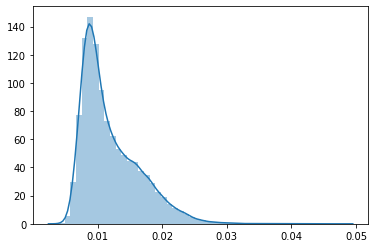

In [0]:
sns.distplot(test_preds/50 )

In [0]:
np.max(test_preds/50)

0.04786562103778124

In [9]:
num_unique_values = int(df_new[c].nunique())
embed_dim = int(min(np.ceil((num_unique_values)/2), 50))